# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: das Verzeichnis »data“ kann nicht angelegt werden: Die Datei existiert bereits


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir


data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")




These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

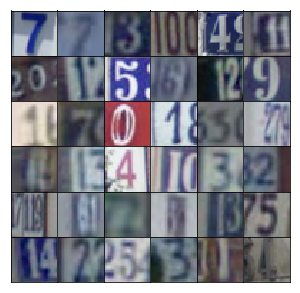

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512, activation=None)
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        # CONV 1
        conv1 = tf.layers.conv2d_transpose(x, 256, 5, 2, 'same', activation=None)
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        # CONV 2
        conv2 = tf.layers.conv2d_transpose(conv1, 128, 5, 2, 'same', activation=None)
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv2, output_dim, 5, 2, 'same', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(x, 64, 5, 2, 'same', activation=None)
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, 2, 'same', activation=None)
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        conv3 = tf.layers.conv2d(conv2, 256, 5, 2, 'same', activation=None)
        conv3 = tf.layers.batch_normalization(conv3, training=True)
        conv3 = tf.maximum(alpha * conv3, conv3)
        
        flat = tf.reshape(conv3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5741... Generator Loss: 0.5541
Epoch 1/25... Discriminator Loss: 0.4045... Generator Loss: 1.6566
Epoch 1/25... Discriminator Loss: 0.1080... Generator Loss: 4.6351
Epoch 1/25... Discriminator Loss: 0.2014... Generator Loss: 2.1115
Epoch 1/25... Discriminator Loss: 0.1415... Generator Loss: 3.1967
Epoch 1/25... Discriminator Loss: 0.0882... Generator Loss: 3.1462
Epoch 1/25... Discriminator Loss: 0.1164... Generator Loss: 3.3908
Epoch 1/25... Discriminator Loss: 0.1559... Generator Loss: 3.0788
Epoch 1/25... Discriminator Loss: 0.1273... Generator Loss: 3.1494
Epoch 1/25... Discriminator Loss: 0.3291... Generator Loss: 3.2253


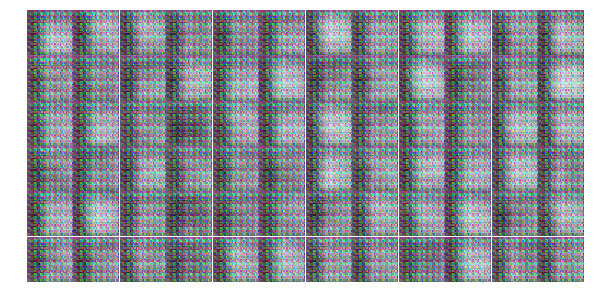

Epoch 1/25... Discriminator Loss: 0.6932... Generator Loss: 1.4599
Epoch 1/25... Discriminator Loss: 1.1821... Generator Loss: 2.9233
Epoch 1/25... Discriminator Loss: 0.5245... Generator Loss: 1.5092
Epoch 1/25... Discriminator Loss: 0.3585... Generator Loss: 2.0902
Epoch 1/25... Discriminator Loss: 0.7480... Generator Loss: 0.9939
Epoch 1/25... Discriminator Loss: 0.6064... Generator Loss: 1.4270
Epoch 1/25... Discriminator Loss: 0.4876... Generator Loss: 2.5037
Epoch 1/25... Discriminator Loss: 0.6219... Generator Loss: 1.4837
Epoch 1/25... Discriminator Loss: 1.0487... Generator Loss: 5.3558
Epoch 1/25... Discriminator Loss: 0.6221... Generator Loss: 1.9454


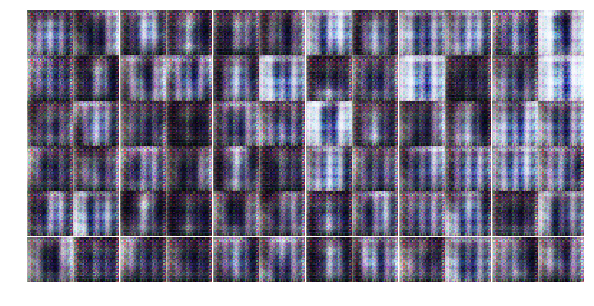

Epoch 1/25... Discriminator Loss: 0.4297... Generator Loss: 1.8542
Epoch 1/25... Discriminator Loss: 0.5431... Generator Loss: 1.2597
Epoch 1/25... Discriminator Loss: 0.2655... Generator Loss: 3.8597
Epoch 1/25... Discriminator Loss: 0.5948... Generator Loss: 1.4321
Epoch 1/25... Discriminator Loss: 0.3775... Generator Loss: 4.3867
Epoch 1/25... Discriminator Loss: 0.6895... Generator Loss: 1.1276
Epoch 1/25... Discriminator Loss: 0.8121... Generator Loss: 0.8993
Epoch 1/25... Discriminator Loss: 0.6437... Generator Loss: 1.4109
Epoch 1/25... Discriminator Loss: 1.2306... Generator Loss: 1.2110
Epoch 1/25... Discriminator Loss: 0.7806... Generator Loss: 1.3450


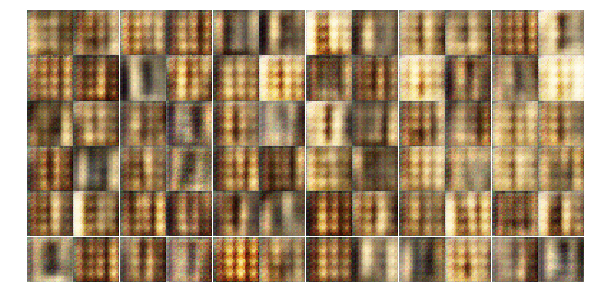

Epoch 1/25... Discriminator Loss: 0.5716... Generator Loss: 2.0174
Epoch 1/25... Discriminator Loss: 1.0679... Generator Loss: 0.7593
Epoch 1/25... Discriminator Loss: 0.7078... Generator Loss: 1.5025
Epoch 1/25... Discriminator Loss: 0.7684... Generator Loss: 1.7787
Epoch 1/25... Discriminator Loss: 0.5283... Generator Loss: 1.5960
Epoch 1/25... Discriminator Loss: 0.6464... Generator Loss: 1.2196
Epoch 1/25... Discriminator Loss: 0.5402... Generator Loss: 1.2682
Epoch 1/25... Discriminator Loss: 0.6104... Generator Loss: 1.8449
Epoch 1/25... Discriminator Loss: 0.4225... Generator Loss: 3.7997
Epoch 1/25... Discriminator Loss: 0.3779... Generator Loss: 1.9952


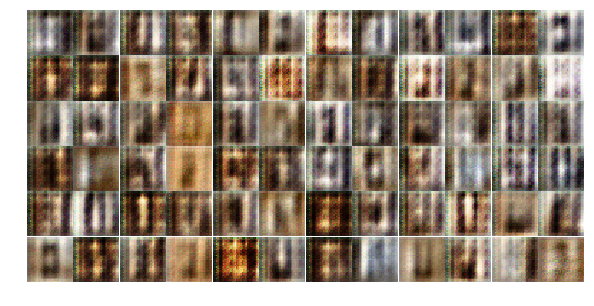

Epoch 1/25... Discriminator Loss: 0.5615... Generator Loss: 1.3823
Epoch 1/25... Discriminator Loss: 1.2031... Generator Loss: 3.4366
Epoch 1/25... Discriminator Loss: 0.3247... Generator Loss: 2.4630
Epoch 1/25... Discriminator Loss: 0.8906... Generator Loss: 1.2509
Epoch 1/25... Discriminator Loss: 0.7680... Generator Loss: 1.2149
Epoch 1/25... Discriminator Loss: 0.7894... Generator Loss: 1.3049
Epoch 1/25... Discriminator Loss: 0.5583... Generator Loss: 1.8282
Epoch 1/25... Discriminator Loss: 1.0151... Generator Loss: 2.8486
Epoch 1/25... Discriminator Loss: 0.6158... Generator Loss: 1.3277
Epoch 1/25... Discriminator Loss: 0.7831... Generator Loss: 1.3807


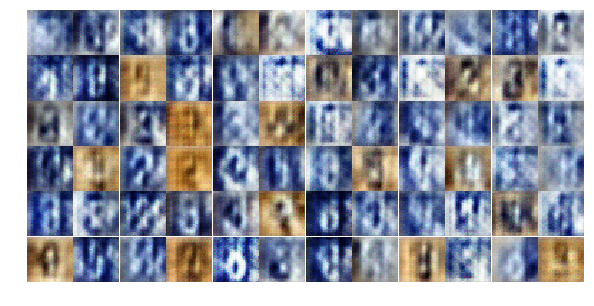

Epoch 1/25... Discriminator Loss: 0.9039... Generator Loss: 1.5817
Epoch 1/25... Discriminator Loss: 0.9414... Generator Loss: 0.9086
Epoch 1/25... Discriminator Loss: 0.5842... Generator Loss: 1.6243
Epoch 1/25... Discriminator Loss: 0.8641... Generator Loss: 0.9078
Epoch 1/25... Discriminator Loss: 0.6453... Generator Loss: 1.5039
Epoch 1/25... Discriminator Loss: 1.0104... Generator Loss: 0.7297
Epoch 1/25... Discriminator Loss: 0.4720... Generator Loss: 2.0300
Epoch 2/25... Discriminator Loss: 0.8513... Generator Loss: 1.4361
Epoch 2/25... Discriminator Loss: 0.7805... Generator Loss: 1.6748
Epoch 2/25... Discriminator Loss: 1.3397... Generator Loss: 0.7687


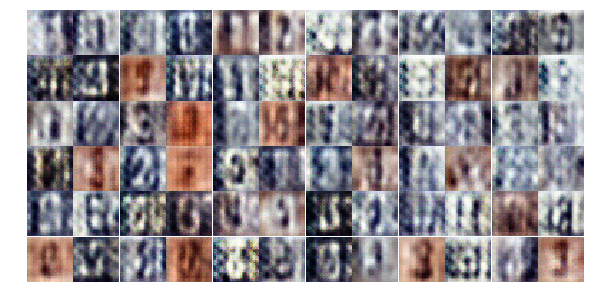

Epoch 2/25... Discriminator Loss: 1.1777... Generator Loss: 1.1058
Epoch 2/25... Discriminator Loss: 1.0431... Generator Loss: 1.2494
Epoch 2/25... Discriminator Loss: 0.8095... Generator Loss: 1.0716
Epoch 2/25... Discriminator Loss: 0.5836... Generator Loss: 1.2804
Epoch 2/25... Discriminator Loss: 0.9265... Generator Loss: 1.0359
Epoch 2/25... Discriminator Loss: 0.8564... Generator Loss: 1.1592
Epoch 2/25... Discriminator Loss: 0.9731... Generator Loss: 1.0907
Epoch 2/25... Discriminator Loss: 0.8758... Generator Loss: 1.1493
Epoch 2/25... Discriminator Loss: 0.8891... Generator Loss: 1.3355
Epoch 2/25... Discriminator Loss: 1.2423... Generator Loss: 1.0826


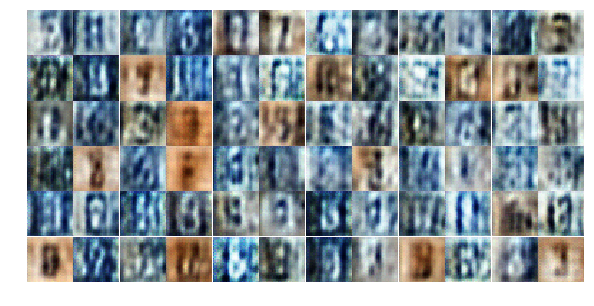

Epoch 2/25... Discriminator Loss: 1.6295... Generator Loss: 0.6534
Epoch 2/25... Discriminator Loss: 1.0088... Generator Loss: 1.1759
Epoch 2/25... Discriminator Loss: 0.6190... Generator Loss: 2.0798
Epoch 2/25... Discriminator Loss: 0.7504... Generator Loss: 1.1477
Epoch 2/25... Discriminator Loss: 0.9721... Generator Loss: 1.1834
Epoch 2/25... Discriminator Loss: 1.0733... Generator Loss: 0.9986
Epoch 2/25... Discriminator Loss: 0.9707... Generator Loss: 1.2628
Epoch 2/25... Discriminator Loss: 1.3030... Generator Loss: 0.5454
Epoch 2/25... Discriminator Loss: 1.1658... Generator Loss: 1.0972
Epoch 2/25... Discriminator Loss: 1.1992... Generator Loss: 0.6700


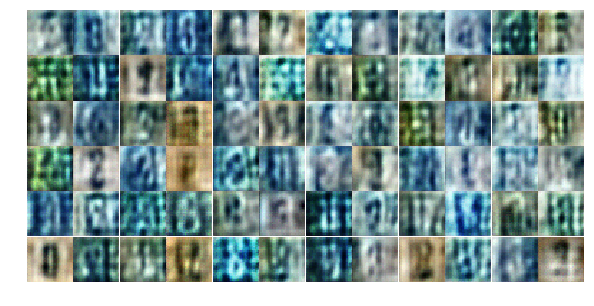

Epoch 2/25... Discriminator Loss: 1.3181... Generator Loss: 0.7266
Epoch 2/25... Discriminator Loss: 1.2874... Generator Loss: 0.8958
Epoch 2/25... Discriminator Loss: 1.0582... Generator Loss: 1.1847
Epoch 2/25... Discriminator Loss: 0.9729... Generator Loss: 1.1308
Epoch 2/25... Discriminator Loss: 0.9028... Generator Loss: 1.2355
Epoch 2/25... Discriminator Loss: 1.0064... Generator Loss: 1.0394
Epoch 2/25... Discriminator Loss: 0.9609... Generator Loss: 1.0381
Epoch 2/25... Discriminator Loss: 1.1606... Generator Loss: 0.7721
Epoch 2/25... Discriminator Loss: 1.0575... Generator Loss: 0.9846
Epoch 2/25... Discriminator Loss: 0.9403... Generator Loss: 0.9666


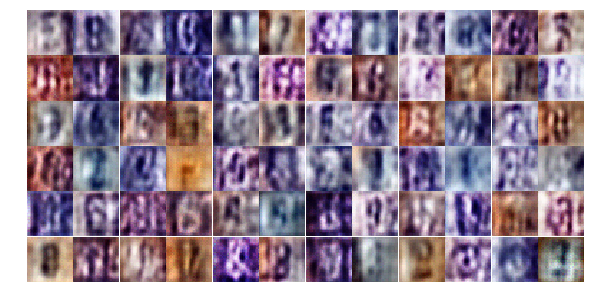

Epoch 2/25... Discriminator Loss: 1.0510... Generator Loss: 0.9931
Epoch 2/25... Discriminator Loss: 1.0043... Generator Loss: 1.0889
Epoch 2/25... Discriminator Loss: 1.0982... Generator Loss: 0.9245
Epoch 2/25... Discriminator Loss: 1.3781... Generator Loss: 0.5641
Epoch 2/25... Discriminator Loss: 1.0498... Generator Loss: 1.1572
Epoch 2/25... Discriminator Loss: 1.4507... Generator Loss: 0.6948
Epoch 2/25... Discriminator Loss: 1.2245... Generator Loss: 0.7832
Epoch 2/25... Discriminator Loss: 0.9256... Generator Loss: 1.4863
Epoch 2/25... Discriminator Loss: 1.2683... Generator Loss: 0.8134
Epoch 2/25... Discriminator Loss: 0.8845... Generator Loss: 1.3495


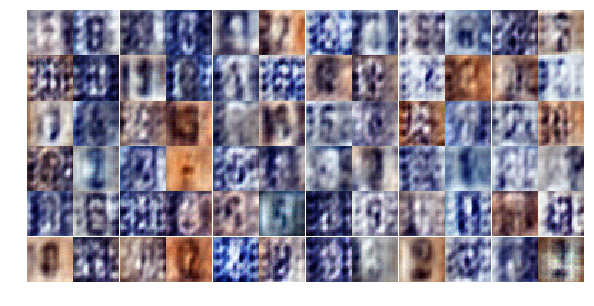

Epoch 2/25... Discriminator Loss: 0.8341... Generator Loss: 1.3542
Epoch 2/25... Discriminator Loss: 0.9393... Generator Loss: 1.1545
Epoch 2/25... Discriminator Loss: 0.9522... Generator Loss: 0.8996
Epoch 2/25... Discriminator Loss: 0.7733... Generator Loss: 1.1375
Epoch 2/25... Discriminator Loss: 1.1973... Generator Loss: 0.8059
Epoch 2/25... Discriminator Loss: 1.3003... Generator Loss: 1.2762
Epoch 2/25... Discriminator Loss: 1.0395... Generator Loss: 1.6903
Epoch 2/25... Discriminator Loss: 0.9272... Generator Loss: 1.2591
Epoch 2/25... Discriminator Loss: 0.6546... Generator Loss: 1.3603
Epoch 2/25... Discriminator Loss: 0.8746... Generator Loss: 1.4434


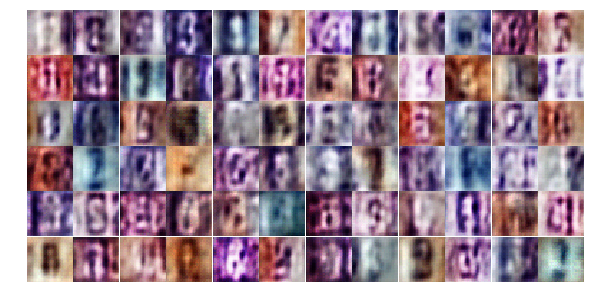

Epoch 2/25... Discriminator Loss: 0.9424... Generator Loss: 1.0270
Epoch 2/25... Discriminator Loss: 0.9538... Generator Loss: 0.9756
Epoch 2/25... Discriminator Loss: 0.9380... Generator Loss: 0.7607
Epoch 2/25... Discriminator Loss: 1.0914... Generator Loss: 0.6722
Epoch 3/25... Discriminator Loss: 1.1087... Generator Loss: 1.6815
Epoch 3/25... Discriminator Loss: 0.7173... Generator Loss: 1.3302
Epoch 3/25... Discriminator Loss: 0.7339... Generator Loss: 1.5560
Epoch 3/25... Discriminator Loss: 0.6386... Generator Loss: 1.3373
Epoch 3/25... Discriminator Loss: 0.9482... Generator Loss: 2.5308
Epoch 3/25... Discriminator Loss: 1.1778... Generator Loss: 0.5923


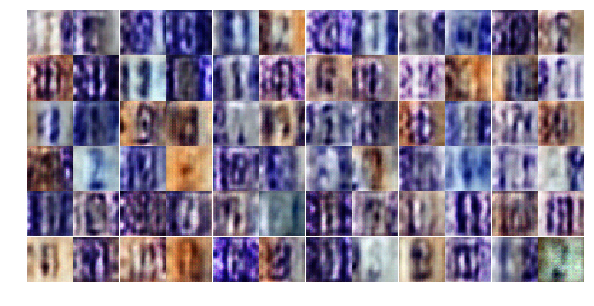

Epoch 3/25... Discriminator Loss: 0.7871... Generator Loss: 0.9730
Epoch 3/25... Discriminator Loss: 0.7652... Generator Loss: 1.5338
Epoch 3/25... Discriminator Loss: 0.7636... Generator Loss: 1.2078
Epoch 3/25... Discriminator Loss: 0.9653... Generator Loss: 0.6824
Epoch 3/25... Discriminator Loss: 0.7088... Generator Loss: 1.2281
Epoch 3/25... Discriminator Loss: 0.8220... Generator Loss: 0.9295
Epoch 3/25... Discriminator Loss: 1.0408... Generator Loss: 0.6252
Epoch 3/25... Discriminator Loss: 0.4560... Generator Loss: 2.0736
Epoch 3/25... Discriminator Loss: 0.4534... Generator Loss: 2.0585
Epoch 3/25... Discriminator Loss: 0.5330... Generator Loss: 2.1392


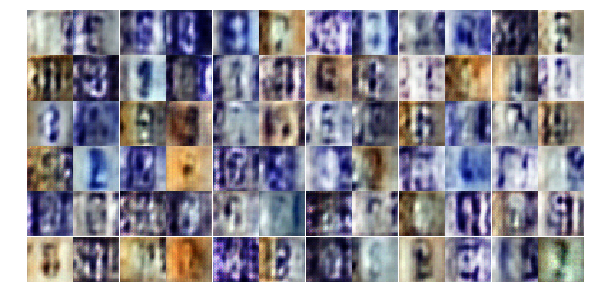

Epoch 3/25... Discriminator Loss: 0.9280... Generator Loss: 1.1860
Epoch 3/25... Discriminator Loss: 0.7135... Generator Loss: 0.9680
Epoch 3/25... Discriminator Loss: 0.6369... Generator Loss: 1.2060
Epoch 3/25... Discriminator Loss: 0.7197... Generator Loss: 0.9493
Epoch 3/25... Discriminator Loss: 0.9356... Generator Loss: 1.4100
Epoch 3/25... Discriminator Loss: 0.7885... Generator Loss: 1.0608
Epoch 3/25... Discriminator Loss: 0.8950... Generator Loss: 0.7000
Epoch 3/25... Discriminator Loss: 0.7048... Generator Loss: 1.2076
Epoch 3/25... Discriminator Loss: 0.3588... Generator Loss: 1.6744
Epoch 3/25... Discriminator Loss: 0.5052... Generator Loss: 1.4154


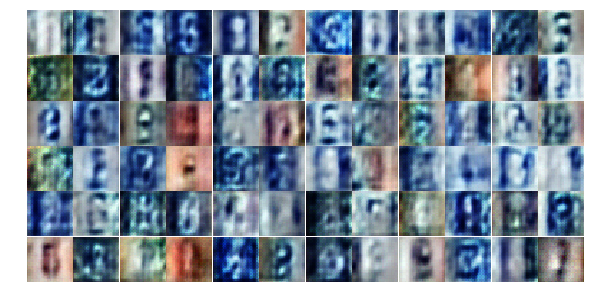

Epoch 3/25... Discriminator Loss: 0.7633... Generator Loss: 1.5389
Epoch 3/25... Discriminator Loss: 0.7988... Generator Loss: 1.1948
Epoch 3/25... Discriminator Loss: 0.4708... Generator Loss: 1.5440
Epoch 3/25... Discriminator Loss: 0.6785... Generator Loss: 2.7522
Epoch 3/25... Discriminator Loss: 1.0564... Generator Loss: 3.1984
Epoch 3/25... Discriminator Loss: 0.7574... Generator Loss: 1.3975
Epoch 3/25... Discriminator Loss: 0.8549... Generator Loss: 1.4723
Epoch 3/25... Discriminator Loss: 1.0994... Generator Loss: 0.6190
Epoch 3/25... Discriminator Loss: 0.9146... Generator Loss: 0.8479
Epoch 3/25... Discriminator Loss: 0.3490... Generator Loss: 2.3787


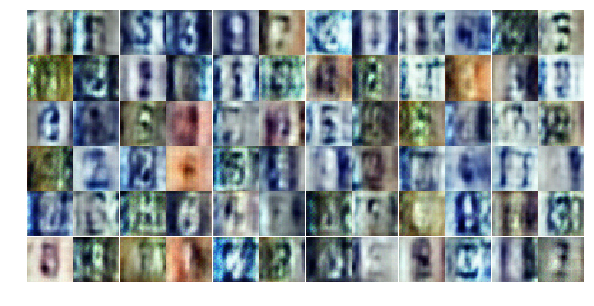

Epoch 3/25... Discriminator Loss: 0.4594... Generator Loss: 1.9601
Epoch 3/25... Discriminator Loss: 0.3959... Generator Loss: 1.9842
Epoch 3/25... Discriminator Loss: 0.6040... Generator Loss: 1.5227
Epoch 3/25... Discriminator Loss: 1.3142... Generator Loss: 0.4509
Epoch 3/25... Discriminator Loss: 0.6507... Generator Loss: 2.1022
Epoch 3/25... Discriminator Loss: 0.4528... Generator Loss: 1.8268
Epoch 3/25... Discriminator Loss: 0.8937... Generator Loss: 0.9563
Epoch 3/25... Discriminator Loss: 0.5958... Generator Loss: 3.0520
Epoch 3/25... Discriminator Loss: 0.4116... Generator Loss: 2.0692
Epoch 3/25... Discriminator Loss: 0.5983... Generator Loss: 2.2109


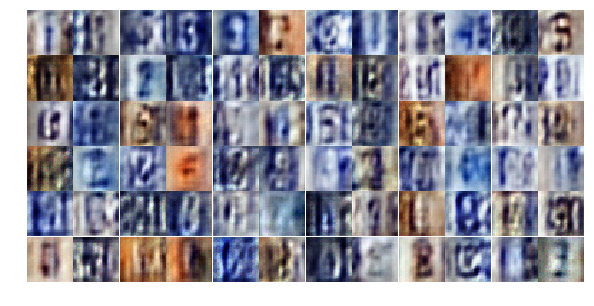

Epoch 3/25... Discriminator Loss: 0.6254... Generator Loss: 2.1105
Epoch 3/25... Discriminator Loss: 1.6292... Generator Loss: 0.2804
Epoch 3/25... Discriminator Loss: 0.4024... Generator Loss: 2.0755
Epoch 3/25... Discriminator Loss: 0.6696... Generator Loss: 2.0010
Epoch 3/25... Discriminator Loss: 0.8746... Generator Loss: 1.0877
Epoch 3/25... Discriminator Loss: 0.5706... Generator Loss: 1.4201
Epoch 3/25... Discriminator Loss: 0.4433... Generator Loss: 2.5976
Epoch 3/25... Discriminator Loss: 0.2293... Generator Loss: 2.3791
Epoch 3/25... Discriminator Loss: 0.6621... Generator Loss: 1.6511
Epoch 3/25... Discriminator Loss: 0.9423... Generator Loss: 0.7912


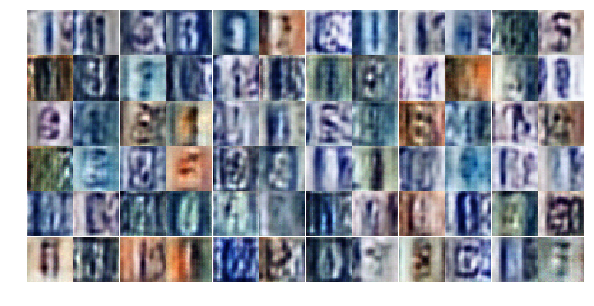

Epoch 3/25... Discriminator Loss: 0.8810... Generator Loss: 1.0794
Epoch 4/25... Discriminator Loss: 0.9168... Generator Loss: 0.8125
Epoch 4/25... Discriminator Loss: 0.6013... Generator Loss: 1.5382
Epoch 4/25... Discriminator Loss: 0.7778... Generator Loss: 1.0071
Epoch 4/25... Discriminator Loss: 0.7632... Generator Loss: 1.7142
Epoch 4/25... Discriminator Loss: 0.4533... Generator Loss: 2.2520
Epoch 4/25... Discriminator Loss: 0.7890... Generator Loss: 1.2622
Epoch 4/25... Discriminator Loss: 0.5782... Generator Loss: 1.9660
Epoch 4/25... Discriminator Loss: 0.4263... Generator Loss: 2.6719
Epoch 4/25... Discriminator Loss: 0.8192... Generator Loss: 1.1546


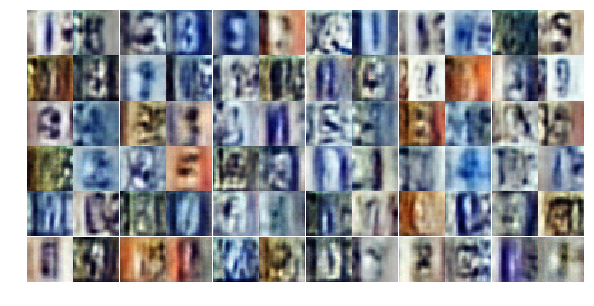

Epoch 4/25... Discriminator Loss: 0.4361... Generator Loss: 1.7766
Epoch 4/25... Discriminator Loss: 1.3735... Generator Loss: 0.4504
Epoch 4/25... Discriminator Loss: 0.9863... Generator Loss: 1.1563
Epoch 4/25... Discriminator Loss: 0.5652... Generator Loss: 1.9471
Epoch 4/25... Discriminator Loss: 0.9088... Generator Loss: 1.1246
Epoch 4/25... Discriminator Loss: 1.0450... Generator Loss: 0.6473
Epoch 4/25... Discriminator Loss: 0.5800... Generator Loss: 1.6693
Epoch 4/25... Discriminator Loss: 0.4429... Generator Loss: 1.5098
Epoch 4/25... Discriminator Loss: 0.6303... Generator Loss: 1.6620
Epoch 4/25... Discriminator Loss: 0.7913... Generator Loss: 1.9734


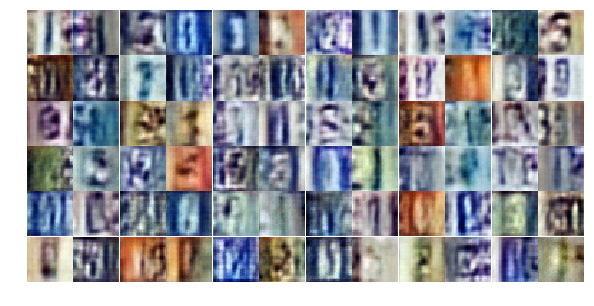

Epoch 4/25... Discriminator Loss: 0.5714... Generator Loss: 1.2220
Epoch 4/25... Discriminator Loss: 0.5618... Generator Loss: 1.5282
Epoch 4/25... Discriminator Loss: 0.6721... Generator Loss: 2.5939
Epoch 4/25... Discriminator Loss: 0.8205... Generator Loss: 0.8098
Epoch 4/25... Discriminator Loss: 0.6437... Generator Loss: 1.1176
Epoch 4/25... Discriminator Loss: 0.7753... Generator Loss: 2.4734
Epoch 4/25... Discriminator Loss: 0.7139... Generator Loss: 0.9859
Epoch 4/25... Discriminator Loss: 0.6317... Generator Loss: 1.4266
Epoch 4/25... Discriminator Loss: 0.7164... Generator Loss: 1.1401
Epoch 4/25... Discriminator Loss: 0.8172... Generator Loss: 0.7887


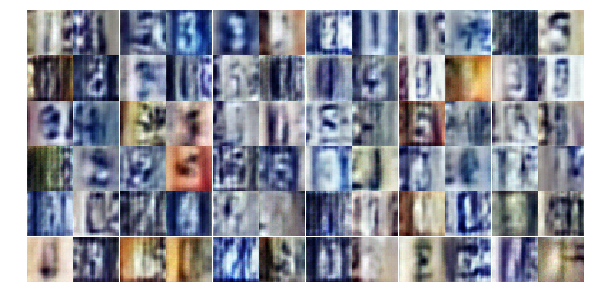

Epoch 4/25... Discriminator Loss: 0.5491... Generator Loss: 1.1926
Epoch 4/25... Discriminator Loss: 0.6731... Generator Loss: 1.8174
Epoch 4/25... Discriminator Loss: 0.6419... Generator Loss: 1.0938
Epoch 4/25... Discriminator Loss: 0.7144... Generator Loss: 1.8137
Epoch 4/25... Discriminator Loss: 0.5253... Generator Loss: 1.7395
Epoch 4/25... Discriminator Loss: 0.7103... Generator Loss: 1.0447
Epoch 4/25... Discriminator Loss: 0.3928... Generator Loss: 1.8011
Epoch 4/25... Discriminator Loss: 0.3980... Generator Loss: 1.7161
Epoch 4/25... Discriminator Loss: 0.9775... Generator Loss: 1.1391
Epoch 4/25... Discriminator Loss: 0.7074... Generator Loss: 1.7092


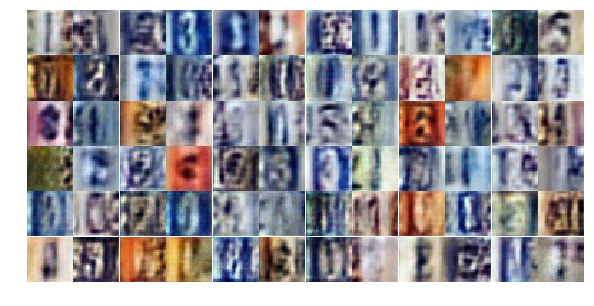

Epoch 4/25... Discriminator Loss: 0.7063... Generator Loss: 1.1255
Epoch 4/25... Discriminator Loss: 0.4711... Generator Loss: 1.5598
Epoch 4/25... Discriminator Loss: 0.5338... Generator Loss: 1.4210
Epoch 4/25... Discriminator Loss: 0.3542... Generator Loss: 1.9114
Epoch 4/25... Discriminator Loss: 0.4375... Generator Loss: 1.5456
Epoch 4/25... Discriminator Loss: 0.5629... Generator Loss: 1.3671
Epoch 4/25... Discriminator Loss: 0.8376... Generator Loss: 0.7637
Epoch 4/25... Discriminator Loss: 0.8605... Generator Loss: 1.4424
Epoch 4/25... Discriminator Loss: 0.7654... Generator Loss: 0.9326
Epoch 4/25... Discriminator Loss: 0.4843... Generator Loss: 1.6325


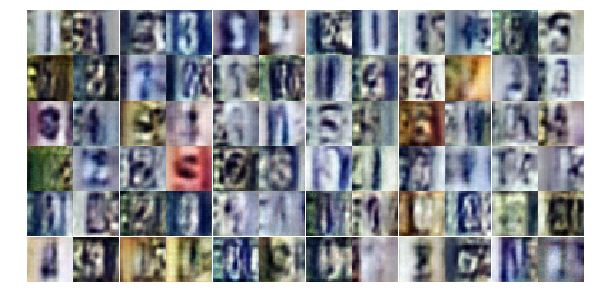

Epoch 4/25... Discriminator Loss: 0.6990... Generator Loss: 0.9983
Epoch 4/25... Discriminator Loss: 0.9337... Generator Loss: 3.3264
Epoch 4/25... Discriminator Loss: 0.4620... Generator Loss: 1.3902
Epoch 4/25... Discriminator Loss: 0.8108... Generator Loss: 2.2405
Epoch 4/25... Discriminator Loss: 0.7387... Generator Loss: 1.0006
Epoch 4/25... Discriminator Loss: 1.0180... Generator Loss: 0.9387
Epoch 4/25... Discriminator Loss: 0.5286... Generator Loss: 1.2331
Epoch 4/25... Discriminator Loss: 0.7446... Generator Loss: 1.0155
Epoch 4/25... Discriminator Loss: 0.4475... Generator Loss: 1.5647
Epoch 5/25... Discriminator Loss: 0.3318... Generator Loss: 2.0094


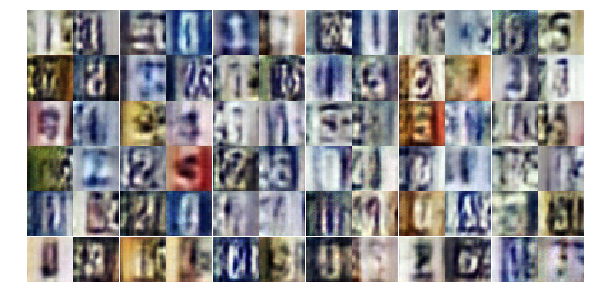

Epoch 5/25... Discriminator Loss: 0.2878... Generator Loss: 2.8186
Epoch 5/25... Discriminator Loss: 0.6590... Generator Loss: 1.0219
Epoch 5/25... Discriminator Loss: 0.6516... Generator Loss: 1.0812
Epoch 5/25... Discriminator Loss: 0.7824... Generator Loss: 0.7540
Epoch 5/25... Discriminator Loss: 0.8613... Generator Loss: 2.5127
Epoch 5/25... Discriminator Loss: 2.0916... Generator Loss: 0.1876
Epoch 5/25... Discriminator Loss: 0.6385... Generator Loss: 1.7079
Epoch 5/25... Discriminator Loss: 0.7245... Generator Loss: 0.9997
Epoch 5/25... Discriminator Loss: 0.7711... Generator Loss: 1.0263
Epoch 5/25... Discriminator Loss: 0.7377... Generator Loss: 1.0931


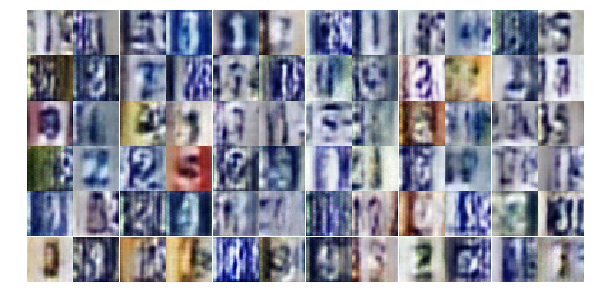

Epoch 5/25... Discriminator Loss: 0.6283... Generator Loss: 1.2079
Epoch 5/25... Discriminator Loss: 0.3824... Generator Loss: 1.7684
Epoch 5/25... Discriminator Loss: 0.6754... Generator Loss: 1.2392
Epoch 5/25... Discriminator Loss: 0.5824... Generator Loss: 1.1540
Epoch 5/25... Discriminator Loss: 1.2249... Generator Loss: 0.6768
Epoch 5/25... Discriminator Loss: 0.7041... Generator Loss: 1.0819
Epoch 5/25... Discriminator Loss: 0.6109... Generator Loss: 1.2504
Epoch 5/25... Discriminator Loss: 0.7424... Generator Loss: 1.1400
Epoch 5/25... Discriminator Loss: 0.8111... Generator Loss: 0.9966
Epoch 5/25... Discriminator Loss: 0.5123... Generator Loss: 1.4474


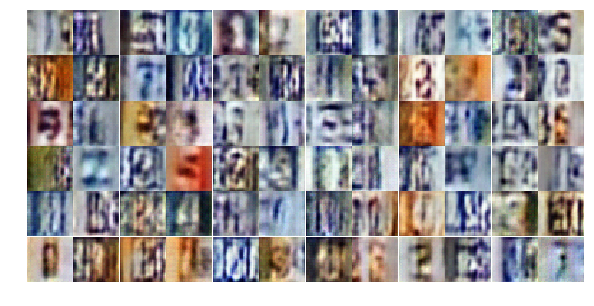

Epoch 5/25... Discriminator Loss: 0.4886... Generator Loss: 1.4235
Epoch 5/25... Discriminator Loss: 0.5400... Generator Loss: 1.8889
Epoch 5/25... Discriminator Loss: 0.8150... Generator Loss: 0.7816
Epoch 5/25... Discriminator Loss: 0.5516... Generator Loss: 1.2208
Epoch 5/25... Discriminator Loss: 0.9320... Generator Loss: 0.6715
Epoch 5/25... Discriminator Loss: 1.0640... Generator Loss: 0.5653
Epoch 5/25... Discriminator Loss: 0.7727... Generator Loss: 0.9169
Epoch 5/25... Discriminator Loss: 0.4247... Generator Loss: 1.6602
Epoch 5/25... Discriminator Loss: 1.8140... Generator Loss: 2.4124
Epoch 5/25... Discriminator Loss: 0.7944... Generator Loss: 1.7531


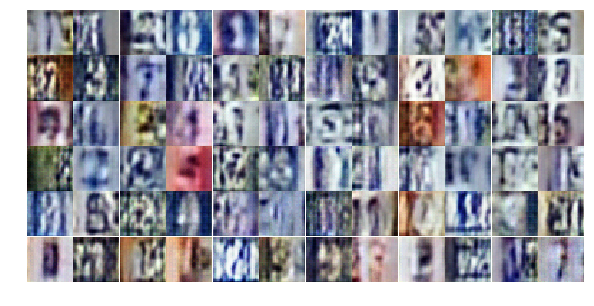

Epoch 5/25... Discriminator Loss: 0.6473... Generator Loss: 1.2924
Epoch 5/25... Discriminator Loss: 0.5637... Generator Loss: 1.4703
Epoch 5/25... Discriminator Loss: 0.5755... Generator Loss: 1.4563
Epoch 5/25... Discriminator Loss: 0.5464... Generator Loss: 1.1872
Epoch 5/25... Discriminator Loss: 0.8474... Generator Loss: 0.8381
Epoch 5/25... Discriminator Loss: 0.4764... Generator Loss: 1.4793
Epoch 5/25... Discriminator Loss: 0.6492... Generator Loss: 1.2343
Epoch 5/25... Discriminator Loss: 0.6345... Generator Loss: 1.0388
Epoch 5/25... Discriminator Loss: 0.4661... Generator Loss: 1.4575
Epoch 5/25... Discriminator Loss: 0.3484... Generator Loss: 1.9936


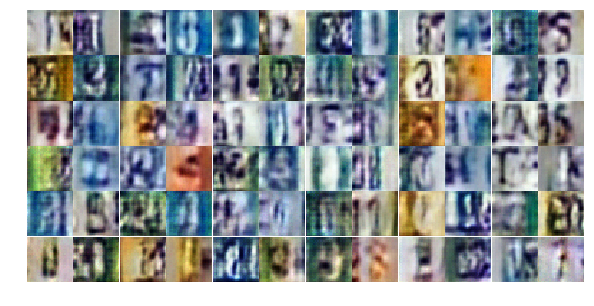

Epoch 5/25... Discriminator Loss: 0.3882... Generator Loss: 1.7045
Epoch 5/25... Discriminator Loss: 1.4371... Generator Loss: 0.3912
Epoch 5/25... Discriminator Loss: 0.9250... Generator Loss: 0.7649
Epoch 5/25... Discriminator Loss: 0.5157... Generator Loss: 2.5557
Epoch 5/25... Discriminator Loss: 1.2781... Generator Loss: 0.6740
Epoch 5/25... Discriminator Loss: 0.8447... Generator Loss: 1.2828
Epoch 5/25... Discriminator Loss: 0.7313... Generator Loss: 2.0022
Epoch 5/25... Discriminator Loss: 0.6200... Generator Loss: 1.1994
Epoch 5/25... Discriminator Loss: 0.8618... Generator Loss: 0.7845
Epoch 5/25... Discriminator Loss: 0.6656... Generator Loss: 2.3231


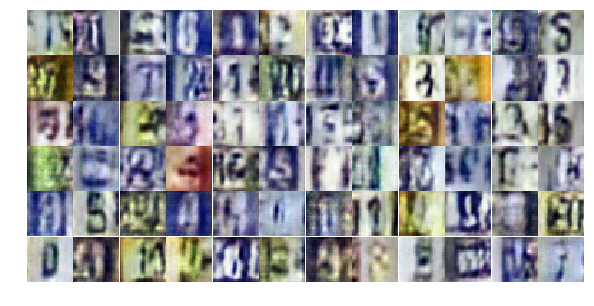

Epoch 5/25... Discriminator Loss: 0.5164... Generator Loss: 2.0377
Epoch 5/25... Discriminator Loss: 0.7463... Generator Loss: 0.8766
Epoch 5/25... Discriminator Loss: 0.8111... Generator Loss: 0.7970
Epoch 5/25... Discriminator Loss: 0.6923... Generator Loss: 2.1927
Epoch 5/25... Discriminator Loss: 0.6493... Generator Loss: 1.2138
Epoch 5/25... Discriminator Loss: 0.8813... Generator Loss: 1.9831
Epoch 6/25... Discriminator Loss: 0.5897... Generator Loss: 1.1572
Epoch 6/25... Discriminator Loss: 0.4519... Generator Loss: 1.4181
Epoch 6/25... Discriminator Loss: 1.1712... Generator Loss: 0.4936
Epoch 6/25... Discriminator Loss: 1.3645... Generator Loss: 0.3973


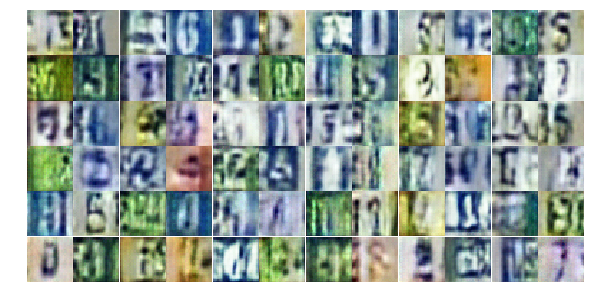

Epoch 6/25... Discriminator Loss: 1.0030... Generator Loss: 0.7187
Epoch 6/25... Discriminator Loss: 1.1604... Generator Loss: 0.6163
Epoch 6/25... Discriminator Loss: 0.6469... Generator Loss: 1.1346
Epoch 6/25... Discriminator Loss: 1.5328... Generator Loss: 0.4828
Epoch 6/25... Discriminator Loss: 0.7204... Generator Loss: 0.9574
Epoch 6/25... Discriminator Loss: 0.4961... Generator Loss: 1.3286
Epoch 6/25... Discriminator Loss: 0.6085... Generator Loss: 1.1878
Epoch 6/25... Discriminator Loss: 1.0957... Generator Loss: 0.5702
Epoch 6/25... Discriminator Loss: 0.6845... Generator Loss: 0.9281
Epoch 6/25... Discriminator Loss: 0.4397... Generator Loss: 1.4732


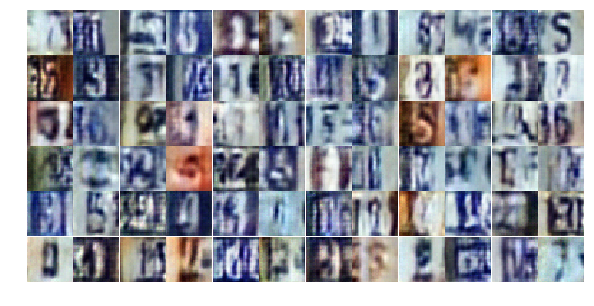

Epoch 6/25... Discriminator Loss: 0.5252... Generator Loss: 2.2700
Epoch 6/25... Discriminator Loss: 1.5279... Generator Loss: 0.4631
Epoch 6/25... Discriminator Loss: 0.8311... Generator Loss: 0.7640
Epoch 6/25... Discriminator Loss: 1.0984... Generator Loss: 0.5385
Epoch 6/25... Discriminator Loss: 0.6631... Generator Loss: 2.0121
Epoch 6/25... Discriminator Loss: 0.4438... Generator Loss: 1.4390
Epoch 6/25... Discriminator Loss: 0.5466... Generator Loss: 1.4357
Epoch 6/25... Discriminator Loss: 0.6855... Generator Loss: 1.0247
Epoch 6/25... Discriminator Loss: 1.1692... Generator Loss: 3.1626
Epoch 6/25... Discriminator Loss: 0.9295... Generator Loss: 0.7292


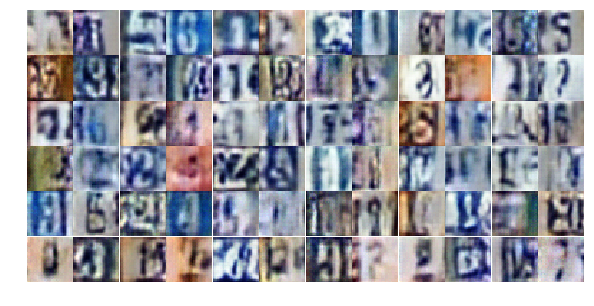

Epoch 6/25... Discriminator Loss: 0.9697... Generator Loss: 0.6390
Epoch 6/25... Discriminator Loss: 0.6923... Generator Loss: 1.1582
Epoch 6/25... Discriminator Loss: 1.0922... Generator Loss: 0.5898
Epoch 6/25... Discriminator Loss: 0.7753... Generator Loss: 0.8540
Epoch 6/25... Discriminator Loss: 0.4895... Generator Loss: 1.5666
Epoch 6/25... Discriminator Loss: 1.2615... Generator Loss: 0.4607
Epoch 6/25... Discriminator Loss: 0.7226... Generator Loss: 1.1811
Epoch 6/25... Discriminator Loss: 0.3287... Generator Loss: 1.8397
Epoch 6/25... Discriminator Loss: 0.5767... Generator Loss: 1.3538
Epoch 6/25... Discriminator Loss: 0.3470... Generator Loss: 2.1270


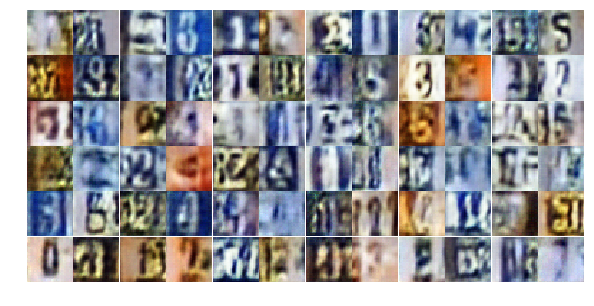

Epoch 6/25... Discriminator Loss: 0.8475... Generator Loss: 0.8423
Epoch 6/25... Discriminator Loss: 0.8521... Generator Loss: 2.1058
Epoch 6/25... Discriminator Loss: 0.6615... Generator Loss: 1.3729
Epoch 6/25... Discriminator Loss: 0.6703... Generator Loss: 0.9617
Epoch 6/25... Discriminator Loss: 0.6345... Generator Loss: 1.3548
Epoch 6/25... Discriminator Loss: 0.5627... Generator Loss: 1.4323
Epoch 6/25... Discriminator Loss: 0.4836... Generator Loss: 1.5428
Epoch 6/25... Discriminator Loss: 0.6221... Generator Loss: 2.0040
Epoch 6/25... Discriminator Loss: 0.5489... Generator Loss: 1.5625
Epoch 6/25... Discriminator Loss: 1.6364... Generator Loss: 0.3128


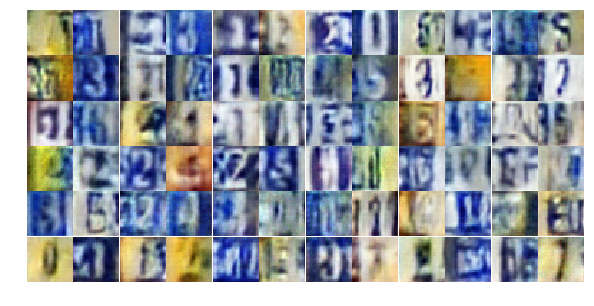

Epoch 6/25... Discriminator Loss: 1.5110... Generator Loss: 0.3105
Epoch 6/25... Discriminator Loss: 1.3153... Generator Loss: 0.4389
Epoch 6/25... Discriminator Loss: 0.9934... Generator Loss: 0.7098
Epoch 6/25... Discriminator Loss: 0.8200... Generator Loss: 2.1843
Epoch 6/25... Discriminator Loss: 0.7306... Generator Loss: 1.2736
Epoch 6/25... Discriminator Loss: 0.4375... Generator Loss: 1.5807
Epoch 6/25... Discriminator Loss: 0.5468... Generator Loss: 1.4197
Epoch 6/25... Discriminator Loss: 1.0851... Generator Loss: 0.5549
Epoch 6/25... Discriminator Loss: 0.6943... Generator Loss: 1.2172
Epoch 6/25... Discriminator Loss: 1.5131... Generator Loss: 0.3374


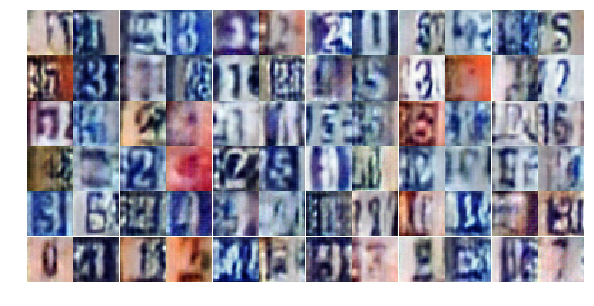

Epoch 6/25... Discriminator Loss: 0.4780... Generator Loss: 1.3793
Epoch 6/25... Discriminator Loss: 0.4445... Generator Loss: 1.4513
Epoch 6/25... Discriminator Loss: 0.5158... Generator Loss: 1.3179
Epoch 7/25... Discriminator Loss: 0.4347... Generator Loss: 1.8292
Epoch 7/25... Discriminator Loss: 1.0596... Generator Loss: 0.5499
Epoch 7/25... Discriminator Loss: 0.5373... Generator Loss: 1.7850
Epoch 7/25... Discriminator Loss: 0.6859... Generator Loss: 0.9408
Epoch 7/25... Discriminator Loss: 0.5339... Generator Loss: 1.5045
Epoch 7/25... Discriminator Loss: 0.5336... Generator Loss: 1.6906
Epoch 7/25... Discriminator Loss: 1.4547... Generator Loss: 0.3431


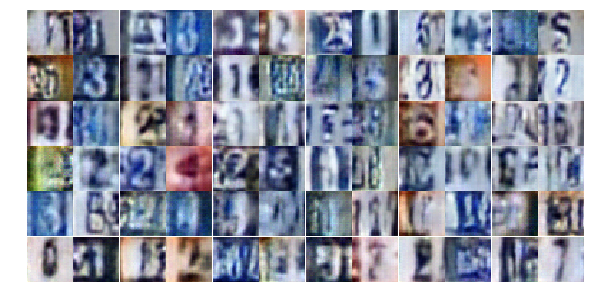

Epoch 7/25... Discriminator Loss: 0.6820... Generator Loss: 2.2804
Epoch 7/25... Discriminator Loss: 0.8773... Generator Loss: 0.7796
Epoch 7/25... Discriminator Loss: 0.6000... Generator Loss: 1.1544
Epoch 7/25... Discriminator Loss: 0.7939... Generator Loss: 1.2098
Epoch 7/25... Discriminator Loss: 0.4672... Generator Loss: 1.5034
Epoch 7/25... Discriminator Loss: 0.4553... Generator Loss: 1.5450
Epoch 7/25... Discriminator Loss: 0.9461... Generator Loss: 3.4104
Epoch 7/25... Discriminator Loss: 1.1800... Generator Loss: 2.7944
Epoch 7/25... Discriminator Loss: 0.8830... Generator Loss: 1.7479
Epoch 7/25... Discriminator Loss: 0.6479... Generator Loss: 1.0383


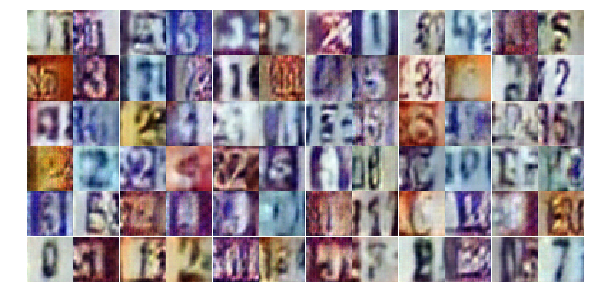

Epoch 7/25... Discriminator Loss: 0.8354... Generator Loss: 1.0302
Epoch 7/25... Discriminator Loss: 0.5307... Generator Loss: 1.3693
Epoch 7/25... Discriminator Loss: 0.8745... Generator Loss: 0.7858
Epoch 7/25... Discriminator Loss: 0.4498... Generator Loss: 1.7853
Epoch 7/25... Discriminator Loss: 0.4475... Generator Loss: 1.7500
Epoch 7/25... Discriminator Loss: 0.5972... Generator Loss: 1.6407
Epoch 7/25... Discriminator Loss: 0.6161... Generator Loss: 1.0695
Epoch 7/25... Discriminator Loss: 0.8908... Generator Loss: 0.6799
Epoch 7/25... Discriminator Loss: 0.3476... Generator Loss: 2.0202
Epoch 7/25... Discriminator Loss: 0.5246... Generator Loss: 2.0557


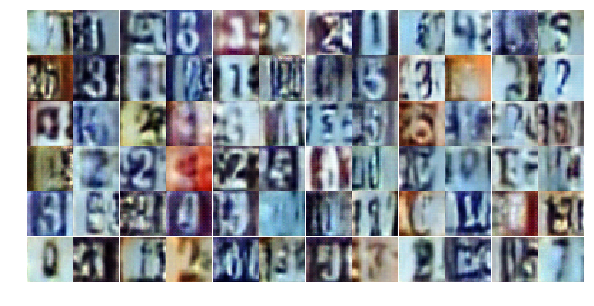

Epoch 7/25... Discriminator Loss: 1.6665... Generator Loss: 0.3135
Epoch 7/25... Discriminator Loss: 0.9254... Generator Loss: 0.7370
Epoch 7/25... Discriminator Loss: 0.5328... Generator Loss: 1.3231
Epoch 7/25... Discriminator Loss: 0.5898... Generator Loss: 1.2918
Epoch 7/25... Discriminator Loss: 0.6659... Generator Loss: 0.9820
Epoch 7/25... Discriminator Loss: 1.0779... Generator Loss: 0.5767
Epoch 7/25... Discriminator Loss: 0.3579... Generator Loss: 1.8681
Epoch 7/25... Discriminator Loss: 0.5943... Generator Loss: 1.7012
Epoch 7/25... Discriminator Loss: 1.1121... Generator Loss: 1.5183
Epoch 7/25... Discriminator Loss: 0.6246... Generator Loss: 1.5042


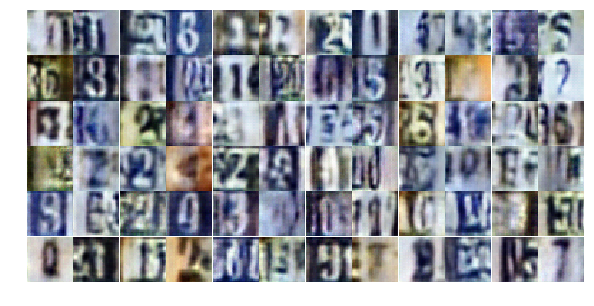

Epoch 7/25... Discriminator Loss: 1.2786... Generator Loss: 0.4322
Epoch 7/25... Discriminator Loss: 0.5671... Generator Loss: 1.2156
Epoch 7/25... Discriminator Loss: 0.5274... Generator Loss: 1.6007
Epoch 7/25... Discriminator Loss: 0.5524... Generator Loss: 1.4705
Epoch 7/25... Discriminator Loss: 0.8576... Generator Loss: 0.8591
Epoch 7/25... Discriminator Loss: 0.3073... Generator Loss: 2.3532
Epoch 7/25... Discriminator Loss: 0.4747... Generator Loss: 1.3129
Epoch 7/25... Discriminator Loss: 1.5600... Generator Loss: 0.3029
Epoch 7/25... Discriminator Loss: 0.7448... Generator Loss: 1.4039
Epoch 7/25... Discriminator Loss: 1.5151... Generator Loss: 0.4940


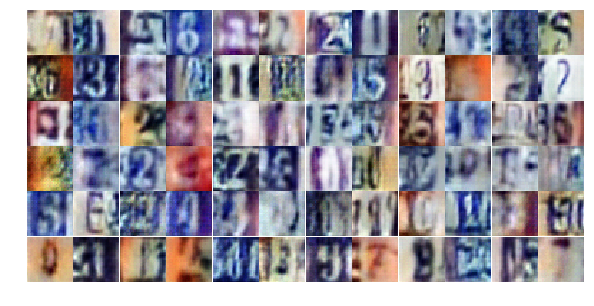

Epoch 7/25... Discriminator Loss: 0.6239... Generator Loss: 2.4573
Epoch 7/25... Discriminator Loss: 0.6034... Generator Loss: 1.3087
Epoch 7/25... Discriminator Loss: 0.7791... Generator Loss: 1.0122
Epoch 7/25... Discriminator Loss: 0.5181... Generator Loss: 1.3212
Epoch 7/25... Discriminator Loss: 0.6521... Generator Loss: 1.0189
Epoch 7/25... Discriminator Loss: 0.5318... Generator Loss: 1.5021
Epoch 7/25... Discriminator Loss: 1.4814... Generator Loss: 0.3585
Epoch 7/25... Discriminator Loss: 0.8868... Generator Loss: 0.8083
Epoch 7/25... Discriminator Loss: 0.8664... Generator Loss: 1.5769
Epoch 7/25... Discriminator Loss: 0.5774... Generator Loss: 1.0805


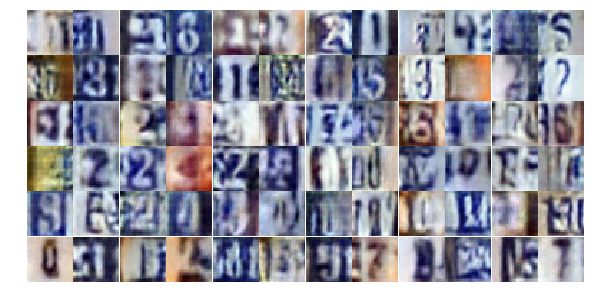

Epoch 7/25... Discriminator Loss: 0.5704... Generator Loss: 1.6278
Epoch 8/25... Discriminator Loss: 0.7817... Generator Loss: 0.8459
Epoch 8/25... Discriminator Loss: 0.8715... Generator Loss: 0.6566
Epoch 8/25... Discriminator Loss: 0.9348... Generator Loss: 0.6823
Epoch 8/25... Discriminator Loss: 0.5456... Generator Loss: 1.2087
Epoch 8/25... Discriminator Loss: 1.3746... Generator Loss: 0.3852
Epoch 8/25... Discriminator Loss: 1.1350... Generator Loss: 0.5049
Epoch 8/25... Discriminator Loss: 0.5214... Generator Loss: 1.5584
Epoch 8/25... Discriminator Loss: 0.8999... Generator Loss: 0.9600
Epoch 8/25... Discriminator Loss: 0.5959... Generator Loss: 1.3794


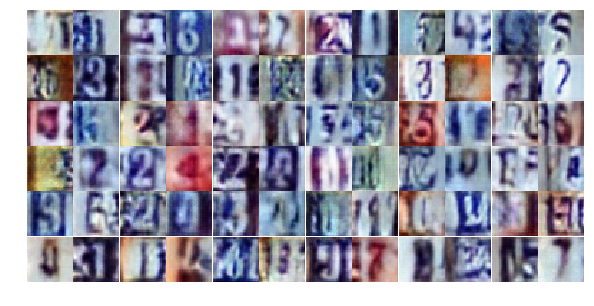

Epoch 8/25... Discriminator Loss: 0.5833... Generator Loss: 1.8666
Epoch 8/25... Discriminator Loss: 0.4503... Generator Loss: 1.7184
Epoch 8/25... Discriminator Loss: 0.7867... Generator Loss: 1.0246
Epoch 8/25... Discriminator Loss: 0.3900... Generator Loss: 1.6034
Epoch 8/25... Discriminator Loss: 0.8191... Generator Loss: 1.1208
Epoch 8/25... Discriminator Loss: 0.8584... Generator Loss: 3.0017
Epoch 8/25... Discriminator Loss: 0.4448... Generator Loss: 1.8196
Epoch 8/25... Discriminator Loss: 0.5579... Generator Loss: 1.3695
Epoch 8/25... Discriminator Loss: 0.7420... Generator Loss: 0.9606
Epoch 8/25... Discriminator Loss: 1.3393... Generator Loss: 0.4059


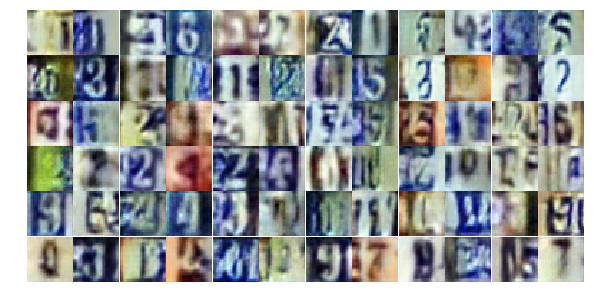

Epoch 8/25... Discriminator Loss: 0.7271... Generator Loss: 1.0119
Epoch 8/25... Discriminator Loss: 0.4654... Generator Loss: 1.4207
Epoch 8/25... Discriminator Loss: 0.6675... Generator Loss: 1.3475
Epoch 8/25... Discriminator Loss: 0.5627... Generator Loss: 1.2196
Epoch 8/25... Discriminator Loss: 0.4893... Generator Loss: 1.3507
Epoch 8/25... Discriminator Loss: 0.7596... Generator Loss: 2.0039
Epoch 8/25... Discriminator Loss: 2.7096... Generator Loss: 4.0303
Epoch 8/25... Discriminator Loss: 0.6463... Generator Loss: 1.2606
Epoch 8/25... Discriminator Loss: 0.6586... Generator Loss: 1.6739
Epoch 8/25... Discriminator Loss: 0.4785... Generator Loss: 1.5290


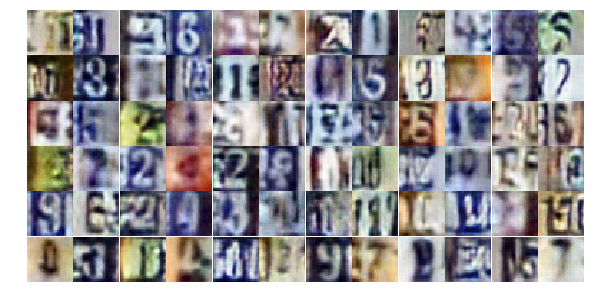

Epoch 8/25... Discriminator Loss: 0.6787... Generator Loss: 1.3134
Epoch 8/25... Discriminator Loss: 0.9947... Generator Loss: 0.6853
Epoch 8/25... Discriminator Loss: 0.6344... Generator Loss: 1.3342
Epoch 8/25... Discriminator Loss: 0.8042... Generator Loss: 0.8028
Epoch 8/25... Discriminator Loss: 0.4704... Generator Loss: 1.4286
Epoch 8/25... Discriminator Loss: 0.4803... Generator Loss: 1.9468
Epoch 8/25... Discriminator Loss: 0.6349... Generator Loss: 1.1555
Epoch 8/25... Discriminator Loss: 0.4963... Generator Loss: 1.3991
Epoch 8/25... Discriminator Loss: 1.0780... Generator Loss: 3.0228
Epoch 8/25... Discriminator Loss: 0.6619... Generator Loss: 1.3094


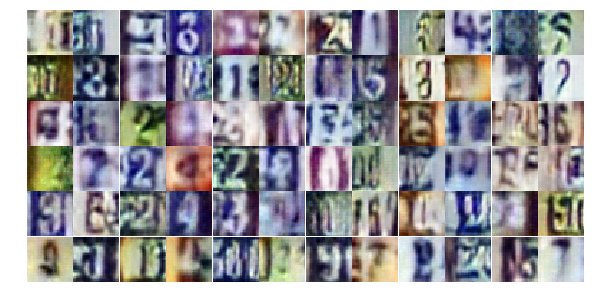

Epoch 8/25... Discriminator Loss: 0.3966... Generator Loss: 1.9638
Epoch 8/25... Discriminator Loss: 0.7930... Generator Loss: 1.0886
Epoch 8/25... Discriminator Loss: 0.8799... Generator Loss: 0.7379
Epoch 8/25... Discriminator Loss: 0.4576... Generator Loss: 1.5962
Epoch 8/25... Discriminator Loss: 1.7406... Generator Loss: 3.7878
Epoch 8/25... Discriminator Loss: 1.7224... Generator Loss: 0.3654
Epoch 8/25... Discriminator Loss: 0.5581... Generator Loss: 1.1872
Epoch 8/25... Discriminator Loss: 0.4305... Generator Loss: 1.7215
Epoch 8/25... Discriminator Loss: 0.5561... Generator Loss: 1.1644
Epoch 8/25... Discriminator Loss: 0.7800... Generator Loss: 1.0113


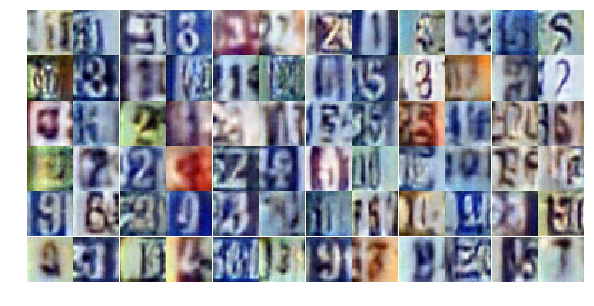

Epoch 8/25... Discriminator Loss: 0.7191... Generator Loss: 0.8981
Epoch 8/25... Discriminator Loss: 0.5367... Generator Loss: 1.4103
Epoch 8/25... Discriminator Loss: 0.3984... Generator Loss: 2.3561
Epoch 8/25... Discriminator Loss: 0.6282... Generator Loss: 1.1660
Epoch 8/25... Discriminator Loss: 0.4771... Generator Loss: 2.8404
Epoch 8/25... Discriminator Loss: 0.7664... Generator Loss: 1.0909
Epoch 8/25... Discriminator Loss: 0.4629... Generator Loss: 1.3840
Epoch 8/25... Discriminator Loss: 0.5545... Generator Loss: 2.8367
Epoch 9/25... Discriminator Loss: 0.7554... Generator Loss: 1.3093
Epoch 9/25... Discriminator Loss: 0.6501... Generator Loss: 1.0093


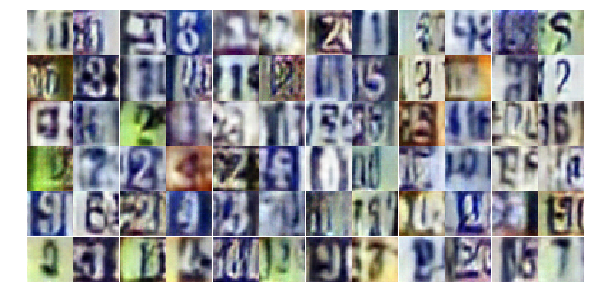

Epoch 9/25... Discriminator Loss: 0.5651... Generator Loss: 1.3467
Epoch 9/25... Discriminator Loss: 0.7384... Generator Loss: 1.1217
Epoch 9/25... Discriminator Loss: 1.0563... Generator Loss: 0.5785
Epoch 9/25... Discriminator Loss: 0.5461... Generator Loss: 1.4292
Epoch 9/25... Discriminator Loss: 1.2323... Generator Loss: 0.4558
Epoch 9/25... Discriminator Loss: 0.4198... Generator Loss: 1.8918
Epoch 9/25... Discriminator Loss: 0.6010... Generator Loss: 1.7574
Epoch 9/25... Discriminator Loss: 0.5802... Generator Loss: 1.1478
Epoch 9/25... Discriminator Loss: 0.9512... Generator Loss: 0.7575
Epoch 9/25... Discriminator Loss: 0.6290... Generator Loss: 1.8701


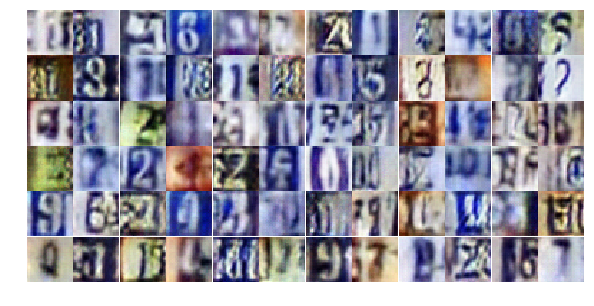

Epoch 9/25... Discriminator Loss: 0.9735... Generator Loss: 0.6762
Epoch 9/25... Discriminator Loss: 1.3861... Generator Loss: 2.4365
Epoch 9/25... Discriminator Loss: 0.6886... Generator Loss: 1.1585
Epoch 9/25... Discriminator Loss: 0.6505... Generator Loss: 1.2721
Epoch 9/25... Discriminator Loss: 0.6529... Generator Loss: 2.2480
Epoch 9/25... Discriminator Loss: 0.9061... Generator Loss: 0.6931
Epoch 9/25... Discriminator Loss: 1.0649... Generator Loss: 0.5534
Epoch 9/25... Discriminator Loss: 0.5242... Generator Loss: 1.5358
Epoch 9/25... Discriminator Loss: 0.8939... Generator Loss: 0.7069
Epoch 9/25... Discriminator Loss: 1.0348... Generator Loss: 0.5807


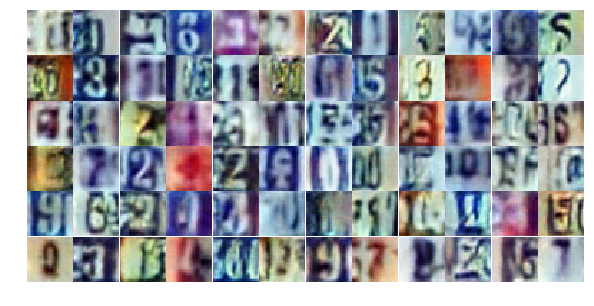

Epoch 9/25... Discriminator Loss: 0.9054... Generator Loss: 1.0796
Epoch 9/25... Discriminator Loss: 0.6506... Generator Loss: 1.0621
Epoch 9/25... Discriminator Loss: 0.6178... Generator Loss: 1.1609
Epoch 9/25... Discriminator Loss: 0.8034... Generator Loss: 0.8395
Epoch 9/25... Discriminator Loss: 0.5753... Generator Loss: 1.1880
Epoch 9/25... Discriminator Loss: 0.5478... Generator Loss: 1.1714
Epoch 9/25... Discriminator Loss: 0.7380... Generator Loss: 0.8952
Epoch 9/25... Discriminator Loss: 0.4885... Generator Loss: 1.5810
Epoch 9/25... Discriminator Loss: 0.5034... Generator Loss: 1.6079
Epoch 9/25... Discriminator Loss: 0.6041... Generator Loss: 1.0355


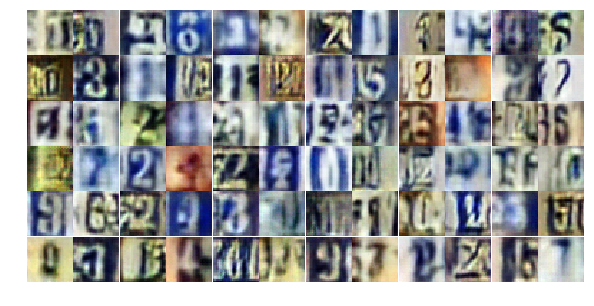

Epoch 9/25... Discriminator Loss: 0.4668... Generator Loss: 1.5335
Epoch 9/25... Discriminator Loss: 0.7478... Generator Loss: 0.8196
Epoch 9/25... Discriminator Loss: 0.4360... Generator Loss: 1.6326
Epoch 9/25... Discriminator Loss: 0.6852... Generator Loss: 1.2025
Epoch 9/25... Discriminator Loss: 0.8980... Generator Loss: 0.6872
Epoch 9/25... Discriminator Loss: 0.6355... Generator Loss: 1.4442
Epoch 9/25... Discriminator Loss: 0.5677... Generator Loss: 2.1833
Epoch 9/25... Discriminator Loss: 0.4747... Generator Loss: 2.4472
Epoch 9/25... Discriminator Loss: 1.4601... Generator Loss: 3.1879
Epoch 9/25... Discriminator Loss: 0.9996... Generator Loss: 0.6851


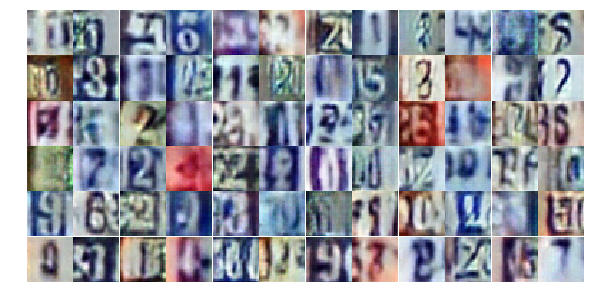

Epoch 9/25... Discriminator Loss: 0.5047... Generator Loss: 1.4442
Epoch 9/25... Discriminator Loss: 0.9220... Generator Loss: 0.6892
Epoch 9/25... Discriminator Loss: 0.4551... Generator Loss: 1.9559
Epoch 9/25... Discriminator Loss: 0.7033... Generator Loss: 1.0371
Epoch 9/25... Discriminator Loss: 0.5167... Generator Loss: 2.4252
Epoch 9/25... Discriminator Loss: 0.7020... Generator Loss: 1.0679
Epoch 9/25... Discriminator Loss: 0.9104... Generator Loss: 0.7490
Epoch 9/25... Discriminator Loss: 1.0634... Generator Loss: 0.5897
Epoch 9/25... Discriminator Loss: 0.7070... Generator Loss: 1.0810
Epoch 9/25... Discriminator Loss: 0.5403... Generator Loss: 1.4707


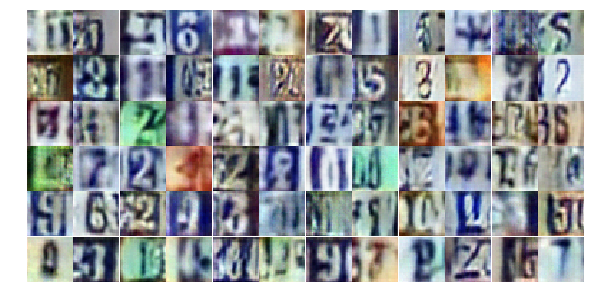

Epoch 9/25... Discriminator Loss: 1.2256... Generator Loss: 0.4915
Epoch 9/25... Discriminator Loss: 1.3117... Generator Loss: 2.7927
Epoch 9/25... Discriminator Loss: 0.5354... Generator Loss: 1.3529
Epoch 9/25... Discriminator Loss: 1.2948... Generator Loss: 0.4181
Epoch 9/25... Discriminator Loss: 0.6047... Generator Loss: 1.3201
Epoch 10/25... Discriminator Loss: 0.4762... Generator Loss: 1.5488
Epoch 10/25... Discriminator Loss: 0.5314... Generator Loss: 1.2961
Epoch 10/25... Discriminator Loss: 0.9206... Generator Loss: 0.7413
Epoch 10/25... Discriminator Loss: 0.7813... Generator Loss: 0.8698
Epoch 10/25... Discriminator Loss: 1.4038... Generator Loss: 0.3941


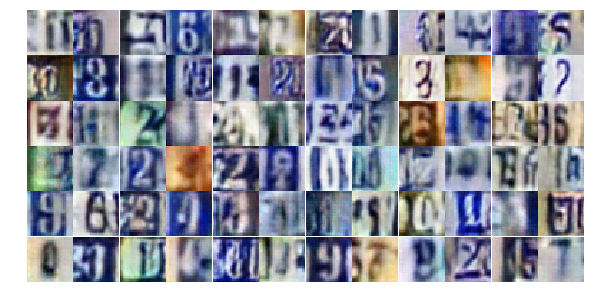

Epoch 10/25... Discriminator Loss: 1.1591... Generator Loss: 0.5301
Epoch 10/25... Discriminator Loss: 0.6925... Generator Loss: 0.9005
Epoch 10/25... Discriminator Loss: 0.5914... Generator Loss: 1.1505
Epoch 10/25... Discriminator Loss: 0.6995... Generator Loss: 1.2077
Epoch 10/25... Discriminator Loss: 0.5758... Generator Loss: 1.2551
Epoch 10/25... Discriminator Loss: 0.6746... Generator Loss: 1.9127
Epoch 10/25... Discriminator Loss: 0.7078... Generator Loss: 0.9300
Epoch 10/25... Discriminator Loss: 0.7956... Generator Loss: 0.8256
Epoch 10/25... Discriminator Loss: 1.0553... Generator Loss: 0.6863
Epoch 10/25... Discriminator Loss: 0.6444... Generator Loss: 1.3300


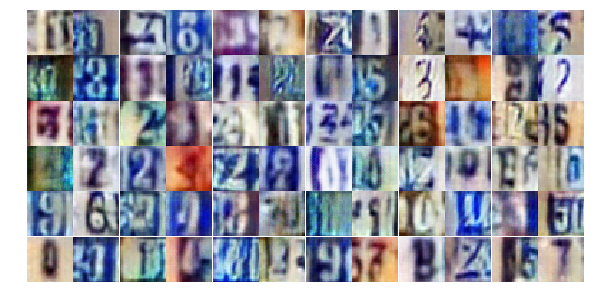

Epoch 10/25... Discriminator Loss: 0.5553... Generator Loss: 1.3062
Epoch 10/25... Discriminator Loss: 0.6847... Generator Loss: 0.9649
Epoch 10/25... Discriminator Loss: 1.8785... Generator Loss: 4.0070
Epoch 10/25... Discriminator Loss: 1.2500... Generator Loss: 1.0512
Epoch 10/25... Discriminator Loss: 0.6979... Generator Loss: 1.3054
Epoch 10/25... Discriminator Loss: 0.8588... Generator Loss: 0.8362
Epoch 10/25... Discriminator Loss: 0.5611... Generator Loss: 1.3068
Epoch 10/25... Discriminator Loss: 0.6178... Generator Loss: 1.1045
Epoch 10/25... Discriminator Loss: 0.6777... Generator Loss: 1.1933
Epoch 10/25... Discriminator Loss: 0.3493... Generator Loss: 2.2090


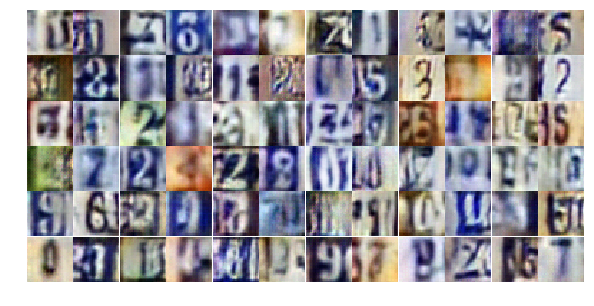

Epoch 10/25... Discriminator Loss: 0.7241... Generator Loss: 0.9782
Epoch 10/25... Discriminator Loss: 0.8597... Generator Loss: 0.8233
Epoch 10/25... Discriminator Loss: 0.4528... Generator Loss: 1.5349
Epoch 10/25... Discriminator Loss: 0.5236... Generator Loss: 1.8067
Epoch 10/25... Discriminator Loss: 1.1342... Generator Loss: 0.5010
Epoch 10/25... Discriminator Loss: 0.5749... Generator Loss: 1.5852
Epoch 10/25... Discriminator Loss: 0.4280... Generator Loss: 1.5016
Epoch 10/25... Discriminator Loss: 0.7081... Generator Loss: 0.9294
Epoch 10/25... Discriminator Loss: 0.7950... Generator Loss: 0.8621
Epoch 10/25... Discriminator Loss: 0.8579... Generator Loss: 0.9357


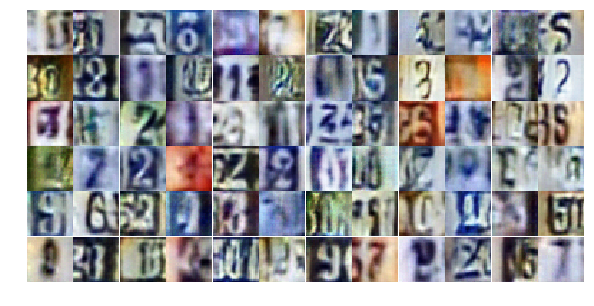

Epoch 10/25... Discriminator Loss: 0.5934... Generator Loss: 1.4160
Epoch 10/25... Discriminator Loss: 0.7485... Generator Loss: 1.2732
Epoch 10/25... Discriminator Loss: 0.5554... Generator Loss: 1.2286
Epoch 10/25... Discriminator Loss: 0.5572... Generator Loss: 1.3045
Epoch 10/25... Discriminator Loss: 0.6623... Generator Loss: 1.0865
Epoch 10/25... Discriminator Loss: 1.2473... Generator Loss: 0.4581
Epoch 10/25... Discriminator Loss: 0.9635... Generator Loss: 0.6494
Epoch 10/25... Discriminator Loss: 0.8643... Generator Loss: 0.8019
Epoch 10/25... Discriminator Loss: 1.0624... Generator Loss: 0.5627
Epoch 10/25... Discriminator Loss: 1.5081... Generator Loss: 0.8163


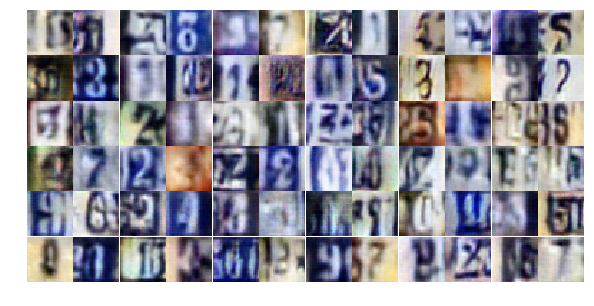

Epoch 10/25... Discriminator Loss: 1.1462... Generator Loss: 0.6629
Epoch 10/25... Discriminator Loss: 0.9681... Generator Loss: 1.4726
Epoch 10/25... Discriminator Loss: 0.8712... Generator Loss: 0.7779
Epoch 10/25... Discriminator Loss: 0.6526... Generator Loss: 1.3276
Epoch 10/25... Discriminator Loss: 0.5896... Generator Loss: 1.4778
Epoch 10/25... Discriminator Loss: 0.7249... Generator Loss: 1.6754
Epoch 10/25... Discriminator Loss: 0.6561... Generator Loss: 1.1674
Epoch 10/25... Discriminator Loss: 0.4092... Generator Loss: 1.6953
Epoch 10/25... Discriminator Loss: 0.5938... Generator Loss: 1.5978
Epoch 10/25... Discriminator Loss: 0.5269... Generator Loss: 1.2888


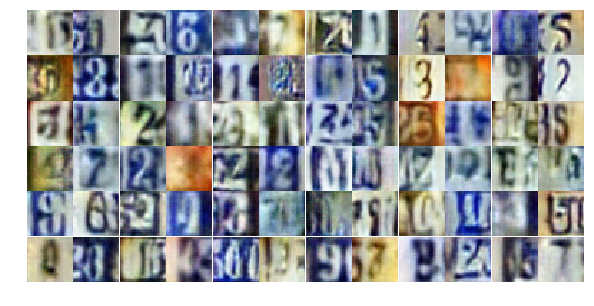

Epoch 10/25... Discriminator Loss: 0.6208... Generator Loss: 1.4185
Epoch 10/25... Discriminator Loss: 0.5455... Generator Loss: 1.1924
Epoch 10/25... Discriminator Loss: 0.4691... Generator Loss: 1.4696
Epoch 11/25... Discriminator Loss: 0.8025... Generator Loss: 1.3662
Epoch 11/25... Discriminator Loss: 0.6891... Generator Loss: 1.1239
Epoch 11/25... Discriminator Loss: 1.5141... Generator Loss: 0.3544
Epoch 11/25... Discriminator Loss: 1.0175... Generator Loss: 0.5969
Epoch 11/25... Discriminator Loss: 0.6026... Generator Loss: 1.2803
Epoch 11/25... Discriminator Loss: 1.5202... Generator Loss: 0.4018
Epoch 11/25... Discriminator Loss: 0.5414... Generator Loss: 1.3160


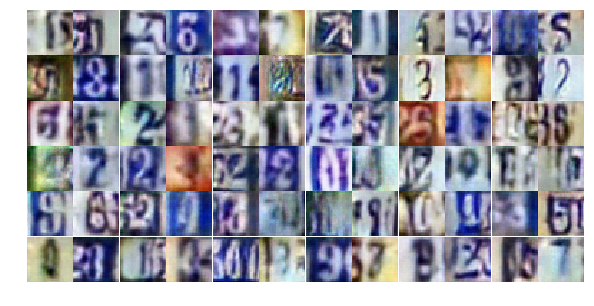

Epoch 11/25... Discriminator Loss: 0.4438... Generator Loss: 1.4659
Epoch 11/25... Discriminator Loss: 0.7208... Generator Loss: 1.0453
Epoch 11/25... Discriminator Loss: 0.3842... Generator Loss: 1.6352
Epoch 11/25... Discriminator Loss: 0.6207... Generator Loss: 1.1383
Epoch 11/25... Discriminator Loss: 0.7406... Generator Loss: 0.9281
Epoch 11/25... Discriminator Loss: 0.4200... Generator Loss: 1.7890
Epoch 11/25... Discriminator Loss: 0.7952... Generator Loss: 0.9211
Epoch 11/25... Discriminator Loss: 0.3886... Generator Loss: 2.2027
Epoch 11/25... Discriminator Loss: 0.5146... Generator Loss: 1.3224
Epoch 11/25... Discriminator Loss: 1.0755... Generator Loss: 0.6594


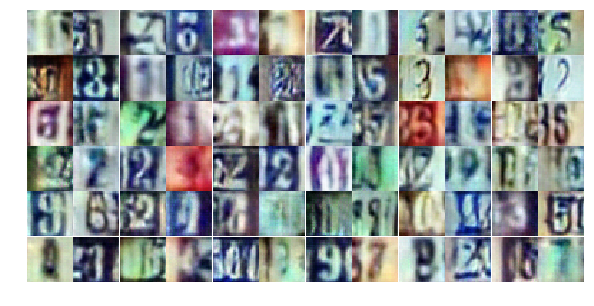

Epoch 11/25... Discriminator Loss: 0.6711... Generator Loss: 0.9916
Epoch 11/25... Discriminator Loss: 0.5427... Generator Loss: 2.0755
Epoch 11/25... Discriminator Loss: 0.7879... Generator Loss: 0.8520
Epoch 11/25... Discriminator Loss: 0.6510... Generator Loss: 0.9851
Epoch 11/25... Discriminator Loss: 0.3119... Generator Loss: 1.9153
Epoch 11/25... Discriminator Loss: 0.4402... Generator Loss: 1.5947
Epoch 11/25... Discriminator Loss: 0.4660... Generator Loss: 1.4434
Epoch 11/25... Discriminator Loss: 0.7083... Generator Loss: 1.0918
Epoch 11/25... Discriminator Loss: 0.2549... Generator Loss: 2.5356
Epoch 11/25... Discriminator Loss: 1.2021... Generator Loss: 0.5035


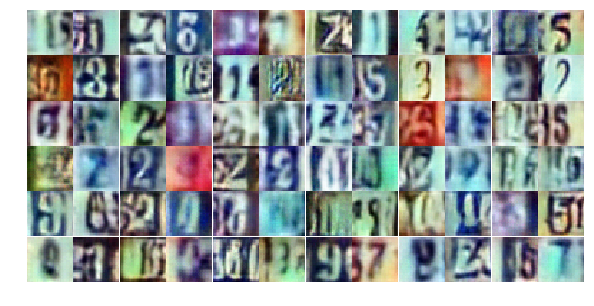

Epoch 11/25... Discriminator Loss: 1.0212... Generator Loss: 0.6883
Epoch 11/25... Discriminator Loss: 0.5629... Generator Loss: 1.4410
Epoch 11/25... Discriminator Loss: 0.7962... Generator Loss: 1.0662
Epoch 11/25... Discriminator Loss: 0.5449... Generator Loss: 1.2557
Epoch 11/25... Discriminator Loss: 0.8820... Generator Loss: 0.7379
Epoch 11/25... Discriminator Loss: 1.0592... Generator Loss: 0.6093
Epoch 11/25... Discriminator Loss: 1.1079... Generator Loss: 0.6066
Epoch 11/25... Discriminator Loss: 1.0717... Generator Loss: 0.5512
Epoch 11/25... Discriminator Loss: 0.4871... Generator Loss: 1.3502
Epoch 11/25... Discriminator Loss: 1.4374... Generator Loss: 0.3456


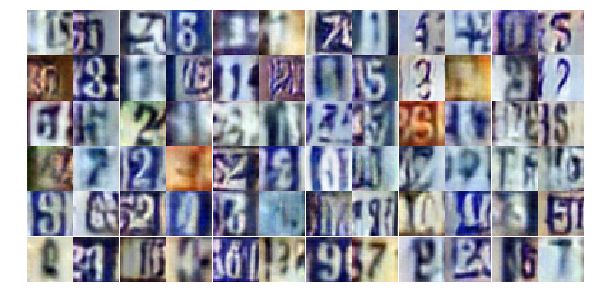

Epoch 11/25... Discriminator Loss: 0.5319... Generator Loss: 1.2410
Epoch 11/25... Discriminator Loss: 0.6127... Generator Loss: 1.2443
Epoch 11/25... Discriminator Loss: 0.6978... Generator Loss: 0.9792
Epoch 11/25... Discriminator Loss: 0.6827... Generator Loss: 1.0521
Epoch 11/25... Discriminator Loss: 0.6728... Generator Loss: 0.9568
Epoch 11/25... Discriminator Loss: 0.8305... Generator Loss: 0.8442
Epoch 11/25... Discriminator Loss: 0.3780... Generator Loss: 2.0734
Epoch 11/25... Discriminator Loss: 0.4707... Generator Loss: 1.4489
Epoch 11/25... Discriminator Loss: 1.5309... Generator Loss: 0.3414
Epoch 11/25... Discriminator Loss: 0.6297... Generator Loss: 2.1123


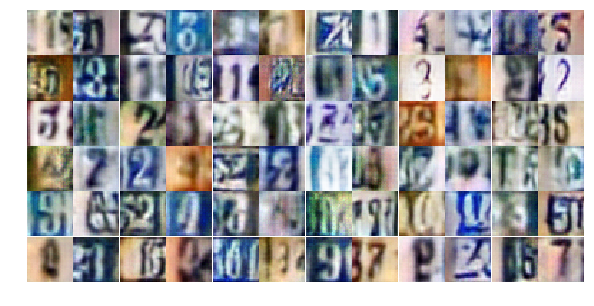

Epoch 11/25... Discriminator Loss: 1.0635... Generator Loss: 0.6306
Epoch 11/25... Discriminator Loss: 0.4652... Generator Loss: 1.6323
Epoch 11/25... Discriminator Loss: 0.8055... Generator Loss: 0.8921
Epoch 11/25... Discriminator Loss: 0.6392... Generator Loss: 1.0497
Epoch 11/25... Discriminator Loss: 0.8436... Generator Loss: 0.8299
Epoch 11/25... Discriminator Loss: 0.4895... Generator Loss: 1.3523
Epoch 11/25... Discriminator Loss: 0.8457... Generator Loss: 0.7851
Epoch 11/25... Discriminator Loss: 0.7015... Generator Loss: 1.3813
Epoch 11/25... Discriminator Loss: 0.7298... Generator Loss: 0.9974
Epoch 11/25... Discriminator Loss: 0.6910... Generator Loss: 1.0567


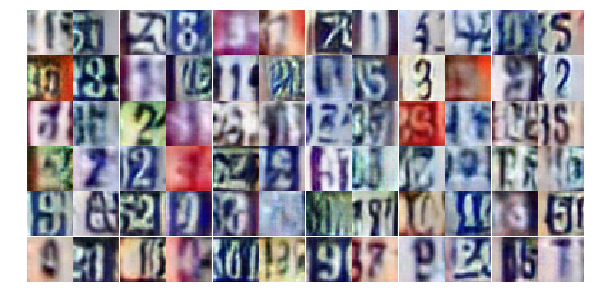

Epoch 12/25... Discriminator Loss: 0.9069... Generator Loss: 0.8115
Epoch 12/25... Discriminator Loss: 0.6084... Generator Loss: 1.0981
Epoch 12/25... Discriminator Loss: 1.0049... Generator Loss: 0.6788
Epoch 12/25... Discriminator Loss: 0.5632... Generator Loss: 1.2327
Epoch 12/25... Discriminator Loss: 0.5826... Generator Loss: 1.8390
Epoch 12/25... Discriminator Loss: 0.8905... Generator Loss: 0.7461
Epoch 12/25... Discriminator Loss: 1.1343... Generator Loss: 3.7664
Epoch 12/25... Discriminator Loss: 0.6894... Generator Loss: 1.0047
Epoch 12/25... Discriminator Loss: 0.6704... Generator Loss: 1.2097
Epoch 12/25... Discriminator Loss: 1.3970... Generator Loss: 0.4383


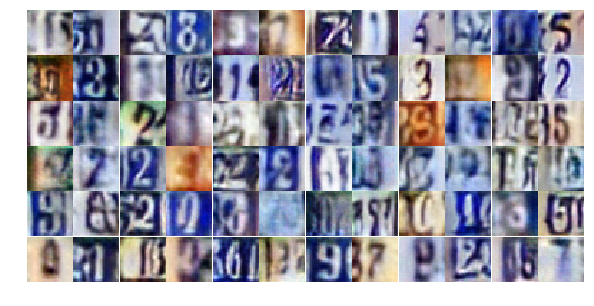

Epoch 12/25... Discriminator Loss: 0.5884... Generator Loss: 1.1306
Epoch 12/25... Discriminator Loss: 0.8254... Generator Loss: 0.8075
Epoch 12/25... Discriminator Loss: 0.4878... Generator Loss: 1.4192
Epoch 12/25... Discriminator Loss: 0.6935... Generator Loss: 1.7110
Epoch 12/25... Discriminator Loss: 0.5233... Generator Loss: 1.6738
Epoch 12/25... Discriminator Loss: 0.8844... Generator Loss: 0.9639
Epoch 12/25... Discriminator Loss: 1.7371... Generator Loss: 0.2663
Epoch 12/25... Discriminator Loss: 0.5195... Generator Loss: 1.5709
Epoch 12/25... Discriminator Loss: 0.5233... Generator Loss: 1.2155
Epoch 12/25... Discriminator Loss: 0.8601... Generator Loss: 0.7977


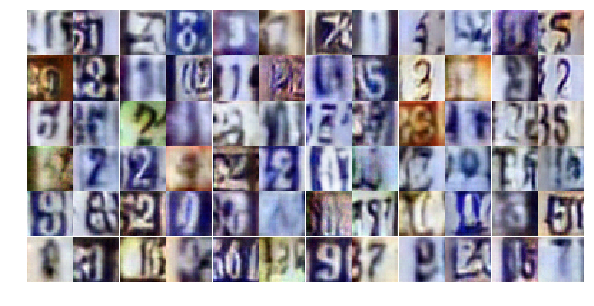

Epoch 12/25... Discriminator Loss: 0.3463... Generator Loss: 1.7779
Epoch 12/25... Discriminator Loss: 0.4260... Generator Loss: 1.7880
Epoch 12/25... Discriminator Loss: 0.6138... Generator Loss: 1.1855
Epoch 12/25... Discriminator Loss: 0.5544... Generator Loss: 1.7897
Epoch 12/25... Discriminator Loss: 0.4957... Generator Loss: 1.5006
Epoch 12/25... Discriminator Loss: 0.4660... Generator Loss: 1.8702
Epoch 12/25... Discriminator Loss: 0.6876... Generator Loss: 0.9920
Epoch 12/25... Discriminator Loss: 0.4234... Generator Loss: 1.5822
Epoch 12/25... Discriminator Loss: 0.5815... Generator Loss: 1.1040
Epoch 12/25... Discriminator Loss: 0.7121... Generator Loss: 0.9702


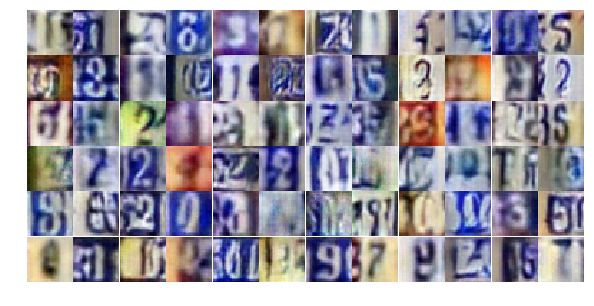

Epoch 12/25... Discriminator Loss: 0.5579... Generator Loss: 1.2258
Epoch 12/25... Discriminator Loss: 0.8055... Generator Loss: 1.0620
Epoch 12/25... Discriminator Loss: 0.6784... Generator Loss: 1.0275
Epoch 12/25... Discriminator Loss: 1.7380... Generator Loss: 0.2830
Epoch 12/25... Discriminator Loss: 0.5880... Generator Loss: 2.2525
Epoch 12/25... Discriminator Loss: 0.8141... Generator Loss: 0.8757
Epoch 12/25... Discriminator Loss: 0.9678... Generator Loss: 0.6471
Epoch 12/25... Discriminator Loss: 0.5769... Generator Loss: 1.2972
Epoch 12/25... Discriminator Loss: 0.5573... Generator Loss: 1.3921
Epoch 12/25... Discriminator Loss: 0.3339... Generator Loss: 1.6452


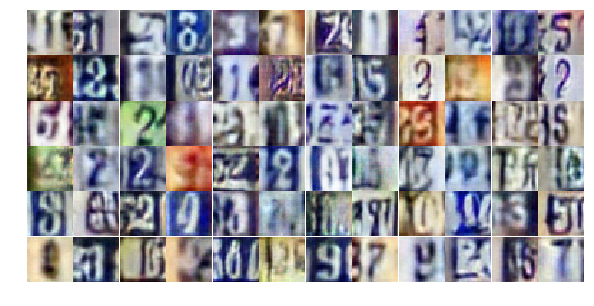

Epoch 12/25... Discriminator Loss: 0.6421... Generator Loss: 1.1337
Epoch 12/25... Discriminator Loss: 0.3694... Generator Loss: 1.6316
Epoch 12/25... Discriminator Loss: 0.4677... Generator Loss: 2.0811
Epoch 12/25... Discriminator Loss: 1.0316... Generator Loss: 2.5225
Epoch 12/25... Discriminator Loss: 0.8978... Generator Loss: 2.6695
Epoch 12/25... Discriminator Loss: 2.1311... Generator Loss: 0.1997
Epoch 12/25... Discriminator Loss: 0.5217... Generator Loss: 1.7772
Epoch 12/25... Discriminator Loss: 0.9146... Generator Loss: 0.7594
Epoch 12/25... Discriminator Loss: 0.4031... Generator Loss: 1.7302
Epoch 12/25... Discriminator Loss: 0.7459... Generator Loss: 0.9094


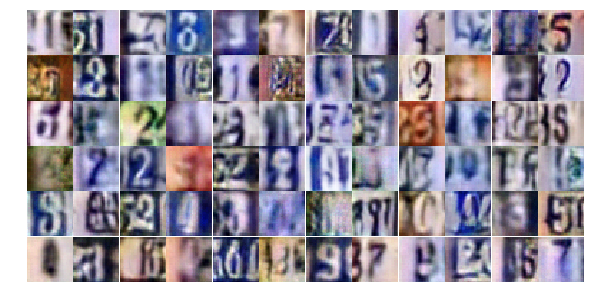

Epoch 12/25... Discriminator Loss: 1.0079... Generator Loss: 0.6861
Epoch 12/25... Discriminator Loss: 0.5765... Generator Loss: 1.2690
Epoch 12/25... Discriminator Loss: 0.6755... Generator Loss: 1.5042
Epoch 12/25... Discriminator Loss: 1.6551... Generator Loss: 0.3051
Epoch 12/25... Discriminator Loss: 0.6110... Generator Loss: 1.0526
Epoch 12/25... Discriminator Loss: 0.7262... Generator Loss: 0.9471
Epoch 12/25... Discriminator Loss: 0.9844... Generator Loss: 0.6936
Epoch 13/25... Discriminator Loss: 0.6088... Generator Loss: 1.0974
Epoch 13/25... Discriminator Loss: 0.3411... Generator Loss: 2.0348
Epoch 13/25... Discriminator Loss: 1.2086... Generator Loss: 0.4790


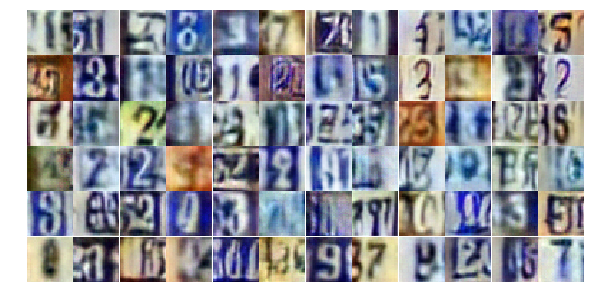

Epoch 13/25... Discriminator Loss: 0.4285... Generator Loss: 1.8330
Epoch 13/25... Discriminator Loss: 0.8147... Generator Loss: 1.9120
Epoch 13/25... Discriminator Loss: 1.6209... Generator Loss: 0.2906
Epoch 13/25... Discriminator Loss: 2.2943... Generator Loss: 0.1520
Epoch 13/25... Discriminator Loss: 1.0953... Generator Loss: 0.6642
Epoch 13/25... Discriminator Loss: 0.6433... Generator Loss: 1.1090
Epoch 13/25... Discriminator Loss: 0.5374... Generator Loss: 1.4242
Epoch 13/25... Discriminator Loss: 0.6123... Generator Loss: 1.0679
Epoch 13/25... Discriminator Loss: 0.5512... Generator Loss: 1.2696
Epoch 13/25... Discriminator Loss: 0.6976... Generator Loss: 1.0157


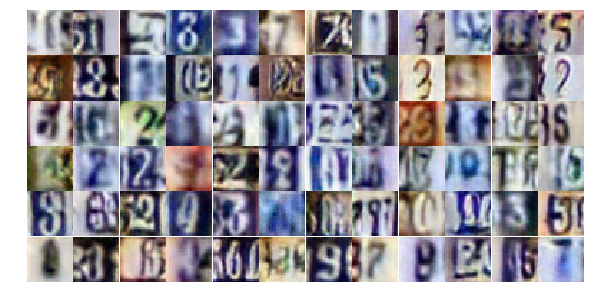

Epoch 13/25... Discriminator Loss: 0.7634... Generator Loss: 0.9044
Epoch 13/25... Discriminator Loss: 0.5908... Generator Loss: 1.1454
Epoch 13/25... Discriminator Loss: 1.0183... Generator Loss: 0.6463
Epoch 13/25... Discriminator Loss: 0.7254... Generator Loss: 0.9298
Epoch 13/25... Discriminator Loss: 0.6384... Generator Loss: 1.7319
Epoch 13/25... Discriminator Loss: 1.0956... Generator Loss: 0.5872
Epoch 13/25... Discriminator Loss: 0.7472... Generator Loss: 1.0252
Epoch 13/25... Discriminator Loss: 0.8782... Generator Loss: 0.7623
Epoch 13/25... Discriminator Loss: 0.6955... Generator Loss: 0.9803
Epoch 13/25... Discriminator Loss: 0.7424... Generator Loss: 0.8815


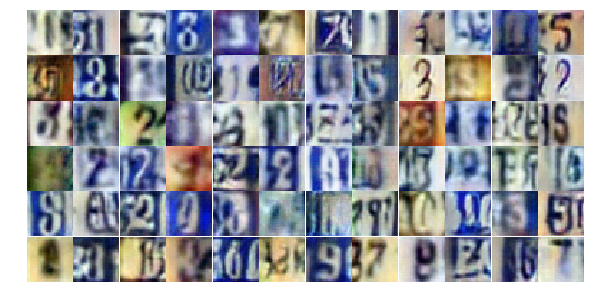

Epoch 13/25... Discriminator Loss: 0.6490... Generator Loss: 1.0560
Epoch 13/25... Discriminator Loss: 0.3601... Generator Loss: 1.8361
Epoch 13/25... Discriminator Loss: 0.6450... Generator Loss: 1.1161
Epoch 13/25... Discriminator Loss: 0.8457... Generator Loss: 0.7807
Epoch 13/25... Discriminator Loss: 0.6496... Generator Loss: 1.0676
Epoch 13/25... Discriminator Loss: 1.3828... Generator Loss: 0.4069
Epoch 13/25... Discriminator Loss: 0.5940... Generator Loss: 1.8963
Epoch 13/25... Discriminator Loss: 0.5409... Generator Loss: 1.3143
Epoch 13/25... Discriminator Loss: 0.5919... Generator Loss: 1.2160
Epoch 13/25... Discriminator Loss: 0.5846... Generator Loss: 1.3348


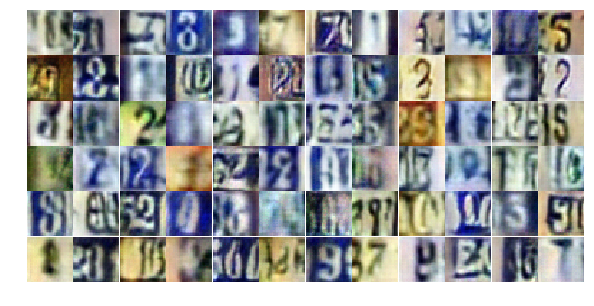

Epoch 13/25... Discriminator Loss: 0.7453... Generator Loss: 0.9845
Epoch 13/25... Discriminator Loss: 0.5809... Generator Loss: 1.0971
Epoch 13/25... Discriminator Loss: 1.2504... Generator Loss: 0.4802
Epoch 13/25... Discriminator Loss: 0.7556... Generator Loss: 0.8731
Epoch 13/25... Discriminator Loss: 0.3989... Generator Loss: 1.5283
Epoch 13/25... Discriminator Loss: 0.3536... Generator Loss: 1.8366
Epoch 13/25... Discriminator Loss: 0.4276... Generator Loss: 1.5008
Epoch 13/25... Discriminator Loss: 0.9272... Generator Loss: 0.7221
Epoch 13/25... Discriminator Loss: 0.5546... Generator Loss: 1.6273
Epoch 13/25... Discriminator Loss: 0.6244... Generator Loss: 1.1310


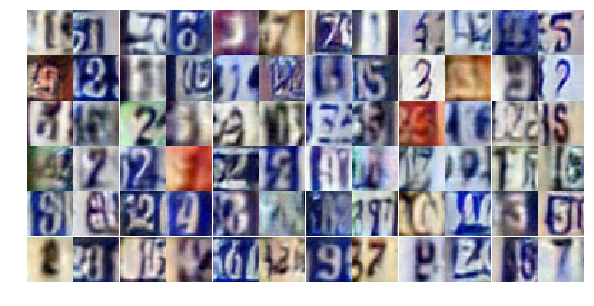

Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 1.6237
Epoch 13/25... Discriminator Loss: 1.3298... Generator Loss: 0.4685
Epoch 13/25... Discriminator Loss: 1.3728... Generator Loss: 0.4189
Epoch 13/25... Discriminator Loss: 0.5142... Generator Loss: 1.4044
Epoch 13/25... Discriminator Loss: 0.7053... Generator Loss: 1.1447
Epoch 13/25... Discriminator Loss: 0.5545... Generator Loss: 1.3726
Epoch 13/25... Discriminator Loss: 0.7983... Generator Loss: 0.8906
Epoch 13/25... Discriminator Loss: 0.8934... Generator Loss: 0.8031
Epoch 13/25... Discriminator Loss: 0.8185... Generator Loss: 0.7875
Epoch 13/25... Discriminator Loss: 0.6384... Generator Loss: 1.0427


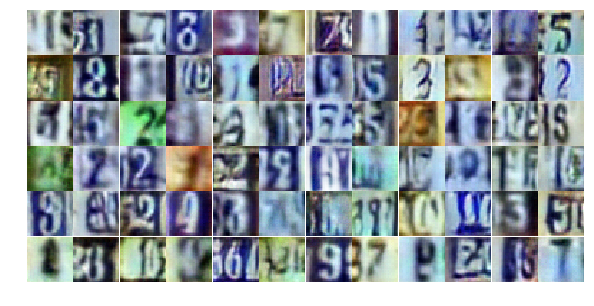

Epoch 13/25... Discriminator Loss: 0.1930... Generator Loss: 3.4396
Epoch 13/25... Discriminator Loss: 1.8507... Generator Loss: 0.2439
Epoch 13/25... Discriminator Loss: 0.8135... Generator Loss: 0.8765
Epoch 13/25... Discriminator Loss: 1.0382... Generator Loss: 1.4553
Epoch 14/25... Discriminator Loss: 1.4094... Generator Loss: 0.5999
Epoch 14/25... Discriminator Loss: 0.6082... Generator Loss: 1.4386
Epoch 14/25... Discriminator Loss: 0.9116... Generator Loss: 1.0022
Epoch 14/25... Discriminator Loss: 0.5876... Generator Loss: 1.6116
Epoch 14/25... Discriminator Loss: 0.5488... Generator Loss: 1.9266
Epoch 14/25... Discriminator Loss: 0.7033... Generator Loss: 0.9367


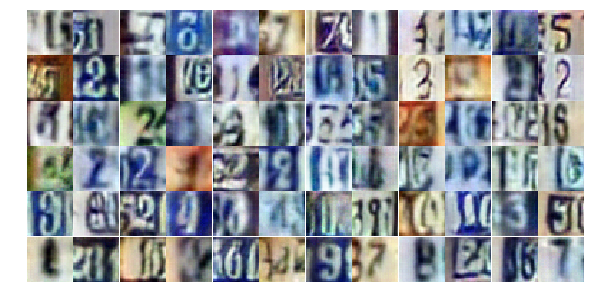

Epoch 14/25... Discriminator Loss: 0.9700... Generator Loss: 2.6999
Epoch 14/25... Discriminator Loss: 1.0385... Generator Loss: 0.6237
Epoch 14/25... Discriminator Loss: 0.7378... Generator Loss: 0.9671
Epoch 14/25... Discriminator Loss: 0.7610... Generator Loss: 1.0788
Epoch 14/25... Discriminator Loss: 0.8541... Generator Loss: 0.7166
Epoch 14/25... Discriminator Loss: 0.2782... Generator Loss: 1.8268
Epoch 14/25... Discriminator Loss: 0.3624... Generator Loss: 2.0299
Epoch 14/25... Discriminator Loss: 1.4665... Generator Loss: 0.3755
Epoch 14/25... Discriminator Loss: 1.7496... Generator Loss: 0.2916
Epoch 14/25... Discriminator Loss: 1.4487... Generator Loss: 0.3640


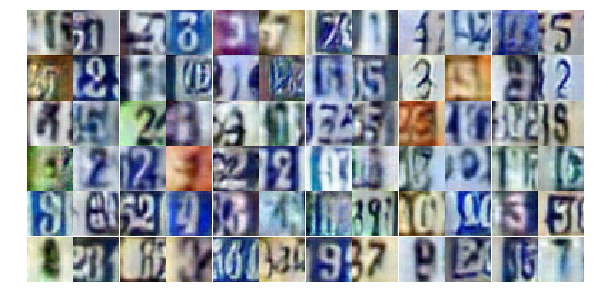

Epoch 14/25... Discriminator Loss: 0.6442... Generator Loss: 1.0341
Epoch 14/25... Discriminator Loss: 0.5251... Generator Loss: 1.8202
Epoch 14/25... Discriminator Loss: 1.1111... Generator Loss: 0.5909
Epoch 14/25... Discriminator Loss: 0.6801... Generator Loss: 0.9372
Epoch 14/25... Discriminator Loss: 0.8371... Generator Loss: 0.8052
Epoch 14/25... Discriminator Loss: 1.2915... Generator Loss: 0.4622
Epoch 14/25... Discriminator Loss: 0.9641... Generator Loss: 0.7259
Epoch 14/25... Discriminator Loss: 0.5851... Generator Loss: 1.1744
Epoch 14/25... Discriminator Loss: 0.7157... Generator Loss: 0.9431
Epoch 14/25... Discriminator Loss: 0.5995... Generator Loss: 1.0721


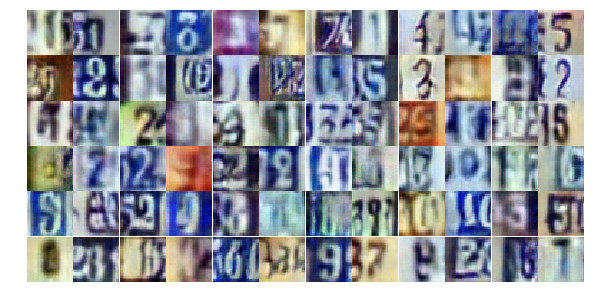

Epoch 14/25... Discriminator Loss: 1.4090... Generator Loss: 0.4620
Epoch 14/25... Discriminator Loss: 0.2941... Generator Loss: 2.2233
Epoch 14/25... Discriminator Loss: 0.3708... Generator Loss: 1.7937
Epoch 14/25... Discriminator Loss: 0.7754... Generator Loss: 3.0807
Epoch 14/25... Discriminator Loss: 0.7136... Generator Loss: 1.0392
Epoch 14/25... Discriminator Loss: 0.8141... Generator Loss: 0.9844
Epoch 14/25... Discriminator Loss: 0.8275... Generator Loss: 0.8112
Epoch 14/25... Discriminator Loss: 0.3986... Generator Loss: 1.6180
Epoch 14/25... Discriminator Loss: 0.4390... Generator Loss: 1.4258
Epoch 14/25... Discriminator Loss: 0.8886... Generator Loss: 0.7933


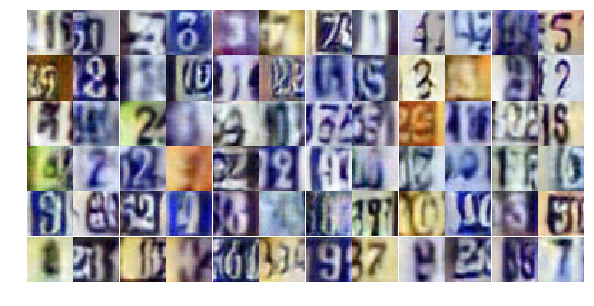

Epoch 14/25... Discriminator Loss: 1.3189... Generator Loss: 0.4391
Epoch 14/25... Discriminator Loss: 0.7481... Generator Loss: 1.6685
Epoch 14/25... Discriminator Loss: 1.2097... Generator Loss: 0.4911
Epoch 14/25... Discriminator Loss: 0.9135... Generator Loss: 0.7198
Epoch 14/25... Discriminator Loss: 1.0336... Generator Loss: 0.7043
Epoch 14/25... Discriminator Loss: 0.6106... Generator Loss: 1.9929
Epoch 14/25... Discriminator Loss: 0.7112... Generator Loss: 1.1846
Epoch 14/25... Discriminator Loss: 0.6395... Generator Loss: 1.0600
Epoch 14/25... Discriminator Loss: 1.0160... Generator Loss: 1.2551
Epoch 14/25... Discriminator Loss: 1.5124... Generator Loss: 0.4749


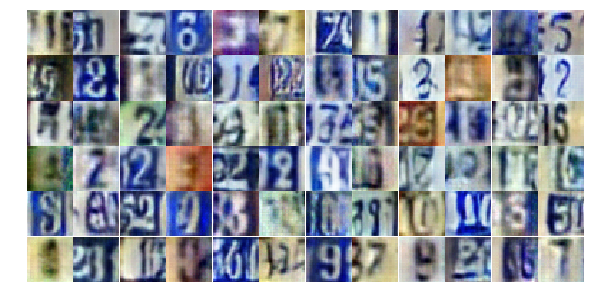

Epoch 14/25... Discriminator Loss: 0.8973... Generator Loss: 1.5963
Epoch 14/25... Discriminator Loss: 1.1880... Generator Loss: 0.4900
Epoch 14/25... Discriminator Loss: 0.7037... Generator Loss: 1.1171
Epoch 14/25... Discriminator Loss: 0.9714... Generator Loss: 0.6720
Epoch 14/25... Discriminator Loss: 0.5914... Generator Loss: 1.2442
Epoch 14/25... Discriminator Loss: 0.6289... Generator Loss: 1.2198
Epoch 14/25... Discriminator Loss: 0.8576... Generator Loss: 0.8455
Epoch 14/25... Discriminator Loss: 0.6404... Generator Loss: 1.3624
Epoch 14/25... Discriminator Loss: 0.9665... Generator Loss: 0.8128
Epoch 14/25... Discriminator Loss: 1.4170... Generator Loss: 0.3820


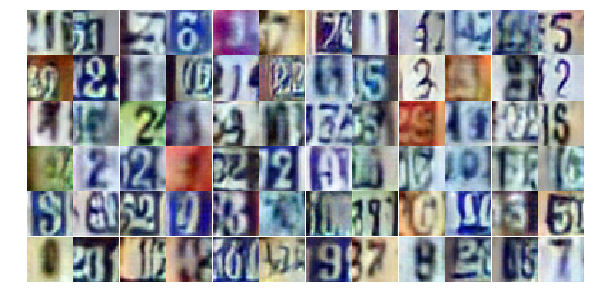

Epoch 14/25... Discriminator Loss: 0.6786... Generator Loss: 0.9415
Epoch 14/25... Discriminator Loss: 1.1546... Generator Loss: 0.5601
Epoch 15/25... Discriminator Loss: 0.7957... Generator Loss: 0.8685
Epoch 15/25... Discriminator Loss: 0.4700... Generator Loss: 1.7687
Epoch 15/25... Discriminator Loss: 0.4205... Generator Loss: 1.5686
Epoch 15/25... Discriminator Loss: 0.6634... Generator Loss: 1.0445
Epoch 15/25... Discriminator Loss: 0.9201... Generator Loss: 0.7168
Epoch 15/25... Discriminator Loss: 0.6771... Generator Loss: 0.9561
Epoch 15/25... Discriminator Loss: 1.0539... Generator Loss: 0.6425
Epoch 15/25... Discriminator Loss: 0.6228... Generator Loss: 1.1738


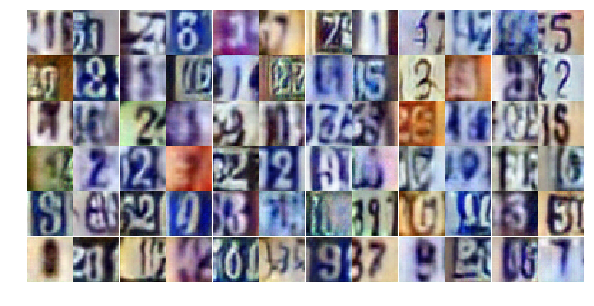

Epoch 15/25... Discriminator Loss: 0.7956... Generator Loss: 0.8307
Epoch 15/25... Discriminator Loss: 1.2461... Generator Loss: 2.6768
Epoch 15/25... Discriminator Loss: 0.7334... Generator Loss: 1.0036
Epoch 15/25... Discriminator Loss: 0.8181... Generator Loss: 0.9200
Epoch 15/25... Discriminator Loss: 0.8491... Generator Loss: 0.7695
Epoch 15/25... Discriminator Loss: 0.4643... Generator Loss: 1.4758
Epoch 15/25... Discriminator Loss: 1.5222... Generator Loss: 0.3691
Epoch 15/25... Discriminator Loss: 1.3620... Generator Loss: 0.4210
Epoch 15/25... Discriminator Loss: 0.4442... Generator Loss: 1.8431
Epoch 15/25... Discriminator Loss: 1.1193... Generator Loss: 0.5966


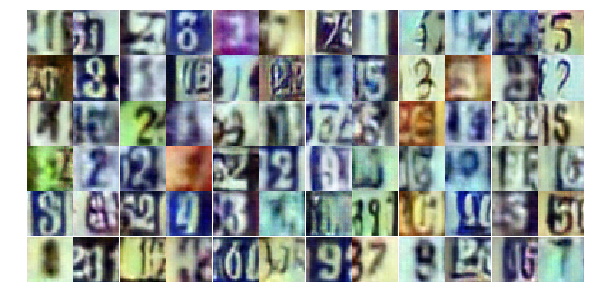

Epoch 15/25... Discriminator Loss: 1.6278... Generator Loss: 0.3590
Epoch 15/25... Discriminator Loss: 0.4898... Generator Loss: 1.3675
Epoch 15/25... Discriminator Loss: 0.4274... Generator Loss: 1.8176
Epoch 15/25... Discriminator Loss: 0.9691... Generator Loss: 0.7040
Epoch 15/25... Discriminator Loss: 0.7154... Generator Loss: 1.1345
Epoch 15/25... Discriminator Loss: 0.4140... Generator Loss: 1.5584
Epoch 15/25... Discriminator Loss: 0.8820... Generator Loss: 0.8060
Epoch 15/25... Discriminator Loss: 0.7234... Generator Loss: 1.0010
Epoch 15/25... Discriminator Loss: 0.5600... Generator Loss: 1.1898
Epoch 15/25... Discriminator Loss: 1.3993... Generator Loss: 0.4655


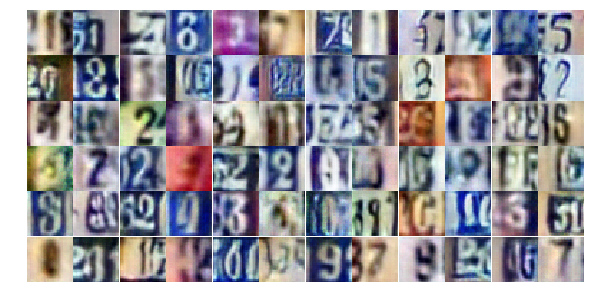

Epoch 15/25... Discriminator Loss: 0.5727... Generator Loss: 1.6398
Epoch 15/25... Discriminator Loss: 0.7202... Generator Loss: 1.0168
Epoch 15/25... Discriminator Loss: 0.4179... Generator Loss: 1.4684
Epoch 15/25... Discriminator Loss: 0.5013... Generator Loss: 1.4021
Epoch 15/25... Discriminator Loss: 0.5397... Generator Loss: 1.2108
Epoch 15/25... Discriminator Loss: 0.8808... Generator Loss: 1.9580
Epoch 15/25... Discriminator Loss: 0.4353... Generator Loss: 1.7788
Epoch 15/25... Discriminator Loss: 0.7520... Generator Loss: 0.9536
Epoch 15/25... Discriminator Loss: 0.5505... Generator Loss: 1.3216
Epoch 15/25... Discriminator Loss: 0.6457... Generator Loss: 1.1063


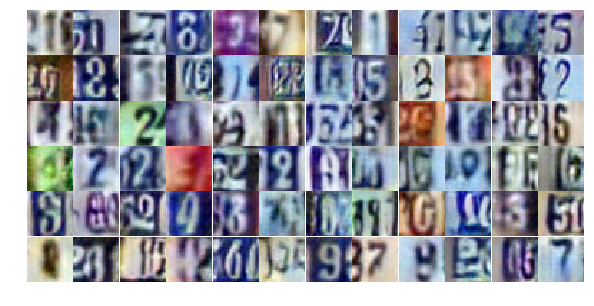

Epoch 15/25... Discriminator Loss: 0.5970... Generator Loss: 1.1061
Epoch 15/25... Discriminator Loss: 1.2517... Generator Loss: 0.4806
Epoch 15/25... Discriminator Loss: 1.1087... Generator Loss: 0.5542
Epoch 15/25... Discriminator Loss: 0.3176... Generator Loss: 1.7815
Epoch 15/25... Discriminator Loss: 0.4584... Generator Loss: 1.4096
Epoch 15/25... Discriminator Loss: 1.4429... Generator Loss: 0.4353
Epoch 15/25... Discriminator Loss: 0.5467... Generator Loss: 1.1566
Epoch 15/25... Discriminator Loss: 0.8277... Generator Loss: 1.7263
Epoch 15/25... Discriminator Loss: 0.8811... Generator Loss: 0.7340
Epoch 15/25... Discriminator Loss: 0.8925... Generator Loss: 0.9257


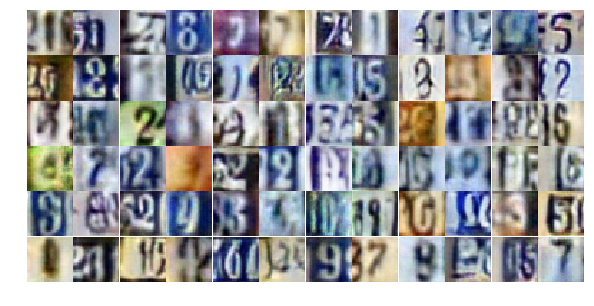

Epoch 15/25... Discriminator Loss: 1.1126... Generator Loss: 0.5793
Epoch 15/25... Discriminator Loss: 1.1325... Generator Loss: 0.5558
Epoch 15/25... Discriminator Loss: 0.4133... Generator Loss: 1.8253
Epoch 15/25... Discriminator Loss: 1.0510... Generator Loss: 0.7175
Epoch 15/25... Discriminator Loss: 0.9604... Generator Loss: 0.7731
Epoch 15/25... Discriminator Loss: 0.9381... Generator Loss: 0.7176
Epoch 15/25... Discriminator Loss: 1.1342... Generator Loss: 0.5456
Epoch 15/25... Discriminator Loss: 0.3477... Generator Loss: 1.8768
Epoch 15/25... Discriminator Loss: 1.1401... Generator Loss: 0.5413
Epoch 16/25... Discriminator Loss: 1.3533... Generator Loss: 0.4828


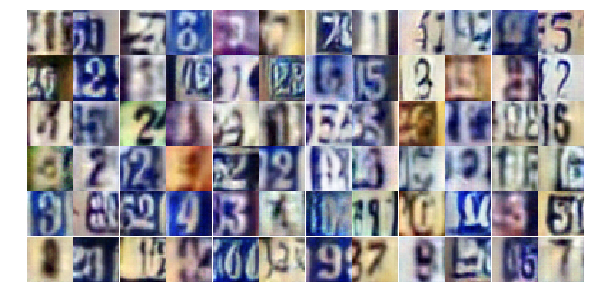

Epoch 16/25... Discriminator Loss: 0.5251... Generator Loss: 1.2481
Epoch 16/25... Discriminator Loss: 0.8053... Generator Loss: 1.1685
Epoch 16/25... Discriminator Loss: 1.0803... Generator Loss: 0.6135
Epoch 16/25... Discriminator Loss: 0.5996... Generator Loss: 1.5277
Epoch 16/25... Discriminator Loss: 0.8162... Generator Loss: 2.0621
Epoch 16/25... Discriminator Loss: 0.9905... Generator Loss: 0.7236
Epoch 16/25... Discriminator Loss: 1.4951... Generator Loss: 0.4953
Epoch 16/25... Discriminator Loss: 0.7770... Generator Loss: 0.9696
Epoch 16/25... Discriminator Loss: 0.4736... Generator Loss: 1.4122
Epoch 16/25... Discriminator Loss: 0.5213... Generator Loss: 1.3887


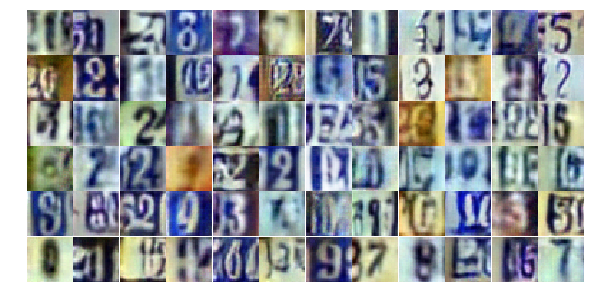

Epoch 16/25... Discriminator Loss: 1.2661... Generator Loss: 0.4685
Epoch 16/25... Discriminator Loss: 0.5535... Generator Loss: 1.1912
Epoch 16/25... Discriminator Loss: 0.6830... Generator Loss: 1.4943
Epoch 16/25... Discriminator Loss: 1.2105... Generator Loss: 0.4823
Epoch 16/25... Discriminator Loss: 0.4914... Generator Loss: 1.2945
Epoch 16/25... Discriminator Loss: 1.1508... Generator Loss: 0.5285
Epoch 16/25... Discriminator Loss: 0.9216... Generator Loss: 0.7583
Epoch 16/25... Discriminator Loss: 0.4661... Generator Loss: 1.5388
Epoch 16/25... Discriminator Loss: 0.4878... Generator Loss: 1.4927
Epoch 16/25... Discriminator Loss: 0.6647... Generator Loss: 1.4409


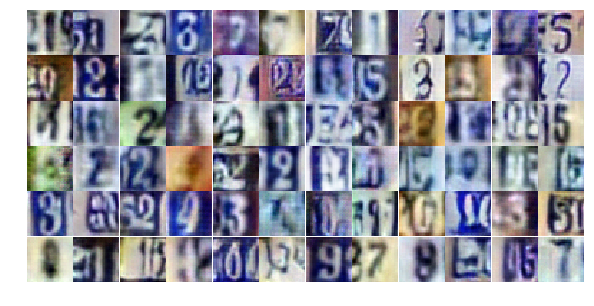

Epoch 16/25... Discriminator Loss: 0.5691... Generator Loss: 1.3996
Epoch 16/25... Discriminator Loss: 0.7353... Generator Loss: 0.9640
Epoch 16/25... Discriminator Loss: 0.8147... Generator Loss: 0.9429
Epoch 16/25... Discriminator Loss: 1.0628... Generator Loss: 0.5660
Epoch 16/25... Discriminator Loss: 0.8725... Generator Loss: 0.9418
Epoch 16/25... Discriminator Loss: 0.9857... Generator Loss: 0.6707
Epoch 16/25... Discriminator Loss: 0.6486... Generator Loss: 1.0588
Epoch 16/25... Discriminator Loss: 0.6867... Generator Loss: 3.5095
Epoch 16/25... Discriminator Loss: 1.2950... Generator Loss: 0.5922
Epoch 16/25... Discriminator Loss: 0.8841... Generator Loss: 0.7973


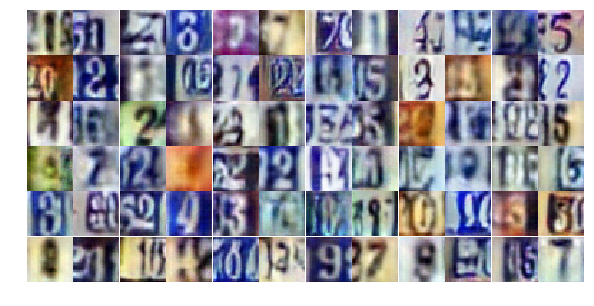

Epoch 16/25... Discriminator Loss: 0.6227... Generator Loss: 1.0920
Epoch 16/25... Discriminator Loss: 0.6188... Generator Loss: 1.2251
Epoch 16/25... Discriminator Loss: 0.5848... Generator Loss: 1.1772
Epoch 16/25... Discriminator Loss: 0.5916... Generator Loss: 1.3510
Epoch 16/25... Discriminator Loss: 1.2265... Generator Loss: 0.5481
Epoch 16/25... Discriminator Loss: 0.5827... Generator Loss: 1.4126
Epoch 16/25... Discriminator Loss: 0.6674... Generator Loss: 1.0134
Epoch 16/25... Discriminator Loss: 0.8877... Generator Loss: 0.7118
Epoch 16/25... Discriminator Loss: 0.4550... Generator Loss: 1.5453
Epoch 16/25... Discriminator Loss: 0.5082... Generator Loss: 1.6266


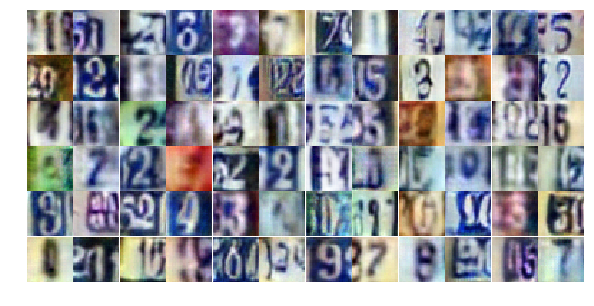

Epoch 16/25... Discriminator Loss: 0.5392... Generator Loss: 1.5051
Epoch 16/25... Discriminator Loss: 0.5856... Generator Loss: 1.3781
Epoch 16/25... Discriminator Loss: 0.7569... Generator Loss: 0.8357
Epoch 16/25... Discriminator Loss: 0.8455... Generator Loss: 0.8028
Epoch 16/25... Discriminator Loss: 0.7218... Generator Loss: 1.1097
Epoch 16/25... Discriminator Loss: 1.0951... Generator Loss: 0.5863
Epoch 16/25... Discriminator Loss: 0.5098... Generator Loss: 1.5145
Epoch 16/25... Discriminator Loss: 0.9009... Generator Loss: 0.7836
Epoch 16/25... Discriminator Loss: 0.5757... Generator Loss: 1.2089
Epoch 16/25... Discriminator Loss: 0.6492... Generator Loss: 1.0544


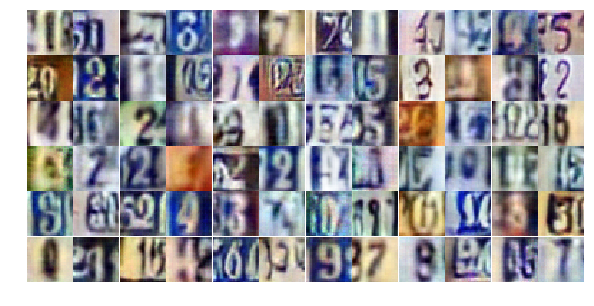

Epoch 16/25... Discriminator Loss: 1.3648... Generator Loss: 0.3945
Epoch 16/25... Discriminator Loss: 1.0120... Generator Loss: 0.7504
Epoch 16/25... Discriminator Loss: 4.3840... Generator Loss: 0.0344
Epoch 16/25... Discriminator Loss: 0.6909... Generator Loss: 1.1217
Epoch 16/25... Discriminator Loss: 0.5313... Generator Loss: 1.3601
Epoch 16/25... Discriminator Loss: 0.6821... Generator Loss: 0.9800
Epoch 17/25... Discriminator Loss: 0.6862... Generator Loss: 1.0958
Epoch 17/25... Discriminator Loss: 0.6229... Generator Loss: 1.4290
Epoch 17/25... Discriminator Loss: 0.5096... Generator Loss: 1.8375
Epoch 17/25... Discriminator Loss: 0.6936... Generator Loss: 1.3394


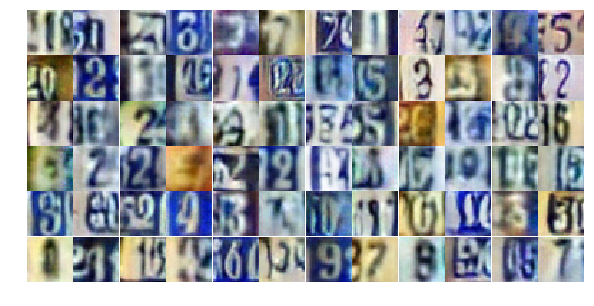

Epoch 17/25... Discriminator Loss: 0.5520... Generator Loss: 1.3267
Epoch 17/25... Discriminator Loss: 0.7315... Generator Loss: 0.9044
Epoch 17/25... Discriminator Loss: 1.0832... Generator Loss: 0.7591
Epoch 17/25... Discriminator Loss: 0.6045... Generator Loss: 1.1465
Epoch 17/25... Discriminator Loss: 1.1024... Generator Loss: 0.5885
Epoch 17/25... Discriminator Loss: 0.9429... Generator Loss: 0.8286
Epoch 17/25... Discriminator Loss: 0.6790... Generator Loss: 1.3301
Epoch 17/25... Discriminator Loss: 0.6978... Generator Loss: 1.0062
Epoch 17/25... Discriminator Loss: 0.4347... Generator Loss: 1.6487
Epoch 17/25... Discriminator Loss: 0.6306... Generator Loss: 1.1458


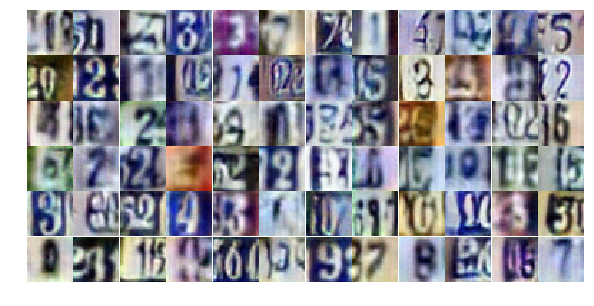

Epoch 17/25... Discriminator Loss: 1.0193... Generator Loss: 0.7215
Epoch 17/25... Discriminator Loss: 0.5361... Generator Loss: 1.8815
Epoch 17/25... Discriminator Loss: 0.8974... Generator Loss: 0.7411
Epoch 17/25... Discriminator Loss: 0.8968... Generator Loss: 0.8524
Epoch 17/25... Discriminator Loss: 0.6359... Generator Loss: 1.0239
Epoch 17/25... Discriminator Loss: 1.0747... Generator Loss: 0.6206
Epoch 17/25... Discriminator Loss: 0.8005... Generator Loss: 0.9225
Epoch 17/25... Discriminator Loss: 0.4436... Generator Loss: 1.6630
Epoch 17/25... Discriminator Loss: 0.7867... Generator Loss: 0.8954
Epoch 17/25... Discriminator Loss: 0.5299... Generator Loss: 1.2115


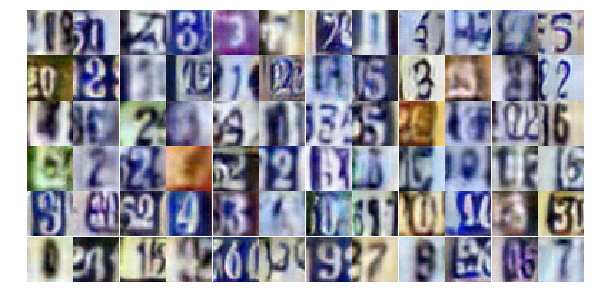

Epoch 17/25... Discriminator Loss: 1.4131... Generator Loss: 0.3852
Epoch 17/25... Discriminator Loss: 0.5300... Generator Loss: 1.3287
Epoch 17/25... Discriminator Loss: 0.5369... Generator Loss: 1.2069
Epoch 17/25... Discriminator Loss: 1.5622... Generator Loss: 0.3493
Epoch 17/25... Discriminator Loss: 1.4734... Generator Loss: 0.3688
Epoch 17/25... Discriminator Loss: 0.3328... Generator Loss: 1.7252
Epoch 17/25... Discriminator Loss: 0.6635... Generator Loss: 0.9857
Epoch 17/25... Discriminator Loss: 0.8664... Generator Loss: 0.7831
Epoch 17/25... Discriminator Loss: 0.7346... Generator Loss: 1.1147
Epoch 17/25... Discriminator Loss: 0.5527... Generator Loss: 1.3385


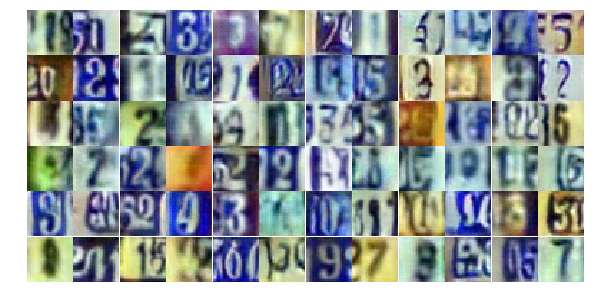

Epoch 17/25... Discriminator Loss: 0.7244... Generator Loss: 1.0620
Epoch 17/25... Discriminator Loss: 0.8237... Generator Loss: 1.4833
Epoch 17/25... Discriminator Loss: 0.6492... Generator Loss: 1.1164
Epoch 17/25... Discriminator Loss: 0.6808... Generator Loss: 1.2211
Epoch 17/25... Discriminator Loss: 1.4266... Generator Loss: 0.3805
Epoch 17/25... Discriminator Loss: 0.7010... Generator Loss: 0.9946
Epoch 17/25... Discriminator Loss: 0.7621... Generator Loss: 1.5024
Epoch 17/25... Discriminator Loss: 0.4760... Generator Loss: 1.4935
Epoch 17/25... Discriminator Loss: 0.5102... Generator Loss: 1.4501
Epoch 17/25... Discriminator Loss: 1.2152... Generator Loss: 0.4908


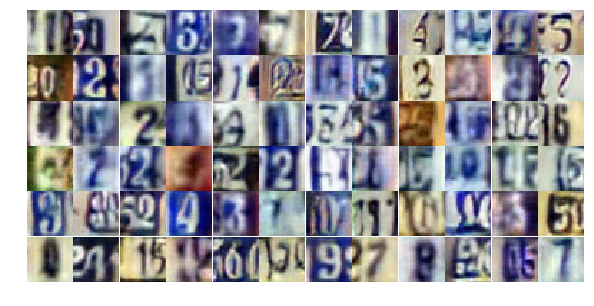

Epoch 17/25... Discriminator Loss: 0.9574... Generator Loss: 0.8021
Epoch 17/25... Discriminator Loss: 0.3112... Generator Loss: 1.7682
Epoch 17/25... Discriminator Loss: 4.1234... Generator Loss: 0.0312
Epoch 17/25... Discriminator Loss: 0.5197... Generator Loss: 1.9862
Epoch 17/25... Discriminator Loss: 0.6297... Generator Loss: 1.1005
Epoch 17/25... Discriminator Loss: 1.0054... Generator Loss: 0.6376
Epoch 17/25... Discriminator Loss: 0.8679... Generator Loss: 0.8760
Epoch 17/25... Discriminator Loss: 0.8744... Generator Loss: 0.7813
Epoch 17/25... Discriminator Loss: 0.5666... Generator Loss: 1.3460
Epoch 17/25... Discriminator Loss: 1.2755... Generator Loss: 0.4866


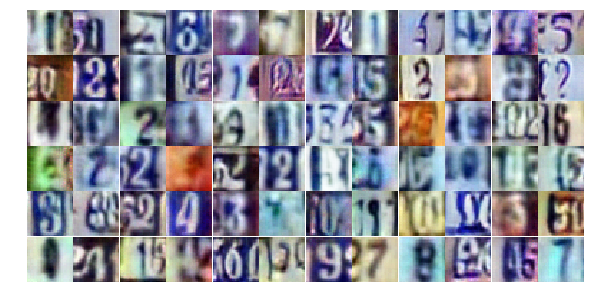

Epoch 17/25... Discriminator Loss: 0.6796... Generator Loss: 1.3630
Epoch 17/25... Discriminator Loss: 0.6616... Generator Loss: 1.3966
Epoch 17/25... Discriminator Loss: 0.5763... Generator Loss: 1.5344
Epoch 17/25... Discriminator Loss: 0.9446... Generator Loss: 2.2718
Epoch 18/25... Discriminator Loss: 1.0823... Generator Loss: 0.6267
Epoch 18/25... Discriminator Loss: 1.2821... Generator Loss: 0.4642
Epoch 18/25... Discriminator Loss: 0.6107... Generator Loss: 1.1935
Epoch 18/25... Discriminator Loss: 0.6487... Generator Loss: 1.0347
Epoch 18/25... Discriminator Loss: 0.9130... Generator Loss: 0.8334
Epoch 18/25... Discriminator Loss: 0.7202... Generator Loss: 1.1539


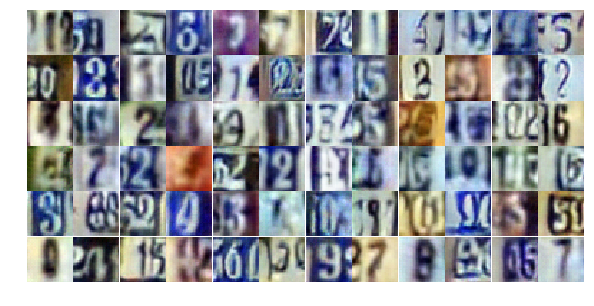

Epoch 18/25... Discriminator Loss: 0.4060... Generator Loss: 1.8697
Epoch 18/25... Discriminator Loss: 1.0845... Generator Loss: 0.5992
Epoch 18/25... Discriminator Loss: 0.9549... Generator Loss: 0.6719
Epoch 18/25... Discriminator Loss: 0.4942... Generator Loss: 1.5622
Epoch 18/25... Discriminator Loss: 0.7472... Generator Loss: 0.8991
Epoch 18/25... Discriminator Loss: 1.0189... Generator Loss: 0.6796
Epoch 18/25... Discriminator Loss: 0.4993... Generator Loss: 1.4073
Epoch 18/25... Discriminator Loss: 1.2894... Generator Loss: 0.5140
Epoch 18/25... Discriminator Loss: 0.8528... Generator Loss: 2.0602
Epoch 18/25... Discriminator Loss: 0.3555... Generator Loss: 1.6572


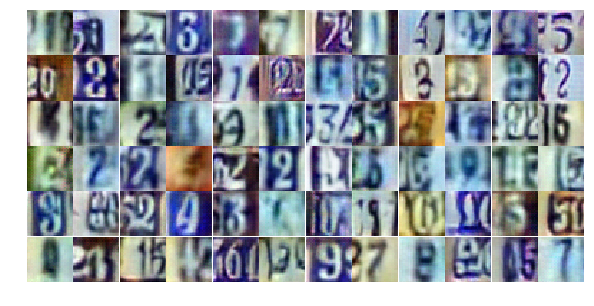

Epoch 18/25... Discriminator Loss: 0.6148... Generator Loss: 1.5126
Epoch 18/25... Discriminator Loss: 0.8539... Generator Loss: 0.7703
Epoch 18/25... Discriminator Loss: 1.2316... Generator Loss: 0.4875
Epoch 18/25... Discriminator Loss: 0.6090... Generator Loss: 1.1364
Epoch 18/25... Discriminator Loss: 0.7454... Generator Loss: 1.0032
Epoch 18/25... Discriminator Loss: 1.1331... Generator Loss: 0.5968
Epoch 18/25... Discriminator Loss: 0.7130... Generator Loss: 1.6985
Epoch 18/25... Discriminator Loss: 0.9861... Generator Loss: 0.6735
Epoch 18/25... Discriminator Loss: 0.8869... Generator Loss: 0.7807
Epoch 18/25... Discriminator Loss: 1.0328... Generator Loss: 0.6597


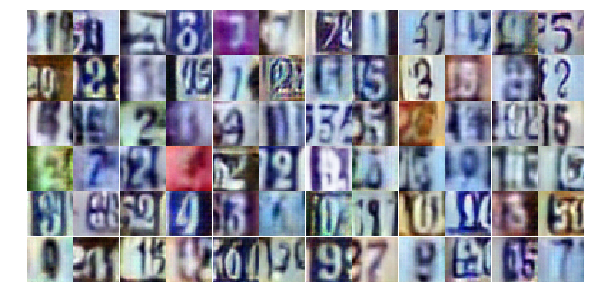

Epoch 18/25... Discriminator Loss: 0.4738... Generator Loss: 1.4204
Epoch 18/25... Discriminator Loss: 0.7193... Generator Loss: 1.0536
Epoch 18/25... Discriminator Loss: 0.6648... Generator Loss: 1.0557
Epoch 18/25... Discriminator Loss: 0.8252... Generator Loss: 0.8333
Epoch 18/25... Discriminator Loss: 0.9480... Generator Loss: 0.8179
Epoch 18/25... Discriminator Loss: 0.6638... Generator Loss: 1.1414
Epoch 18/25... Discriminator Loss: 1.0397... Generator Loss: 0.6608
Epoch 18/25... Discriminator Loss: 0.4693... Generator Loss: 1.3799
Epoch 18/25... Discriminator Loss: 0.7238... Generator Loss: 0.9734
Epoch 18/25... Discriminator Loss: 0.8978... Generator Loss: 0.9238


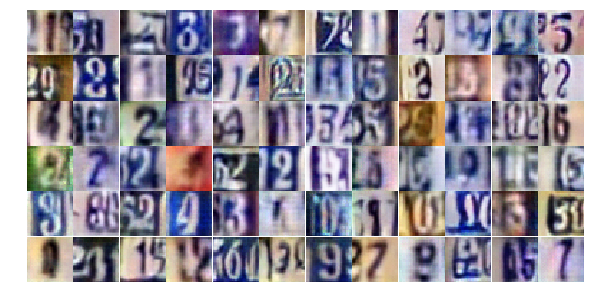

Epoch 18/25... Discriminator Loss: 0.9549... Generator Loss: 0.7111
Epoch 18/25... Discriminator Loss: 0.8126... Generator Loss: 0.8659
Epoch 18/25... Discriminator Loss: 0.6348... Generator Loss: 0.9966
Epoch 18/25... Discriminator Loss: 0.5015... Generator Loss: 1.3330
Epoch 18/25... Discriminator Loss: 0.8810... Generator Loss: 0.8048
Epoch 18/25... Discriminator Loss: 0.7370... Generator Loss: 0.8671
Epoch 18/25... Discriminator Loss: 0.9863... Generator Loss: 0.6442
Epoch 18/25... Discriminator Loss: 1.0938... Generator Loss: 3.1333
Epoch 18/25... Discriminator Loss: 0.6225... Generator Loss: 1.1136
Epoch 18/25... Discriminator Loss: 0.4786... Generator Loss: 1.4854


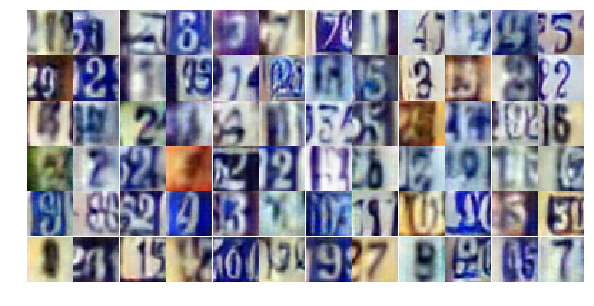

Epoch 18/25... Discriminator Loss: 0.6421... Generator Loss: 1.1229
Epoch 18/25... Discriminator Loss: 0.8578... Generator Loss: 0.8047
Epoch 18/25... Discriminator Loss: 0.6448... Generator Loss: 1.2732
Epoch 18/25... Discriminator Loss: 3.0461... Generator Loss: 5.9742
Epoch 18/25... Discriminator Loss: 1.3053... Generator Loss: 0.8275
Epoch 18/25... Discriminator Loss: 0.6915... Generator Loss: 1.1016
Epoch 18/25... Discriminator Loss: 0.6705... Generator Loss: 1.0358
Epoch 18/25... Discriminator Loss: 0.4259... Generator Loss: 1.9362
Epoch 18/25... Discriminator Loss: 0.9025... Generator Loss: 1.1080
Epoch 18/25... Discriminator Loss: 0.9080... Generator Loss: 0.7814


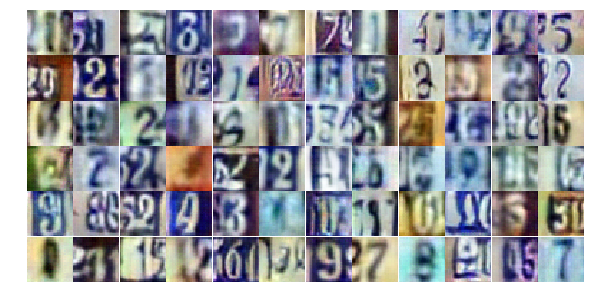

Epoch 18/25... Discriminator Loss: 0.5387... Generator Loss: 2.0463
Epoch 19/25... Discriminator Loss: 0.8729... Generator Loss: 1.1193
Epoch 19/25... Discriminator Loss: 1.3687... Generator Loss: 0.4139
Epoch 19/25... Discriminator Loss: 0.8420... Generator Loss: 0.8963
Epoch 19/25... Discriminator Loss: 0.7784... Generator Loss: 0.9795
Epoch 19/25... Discriminator Loss: 1.1089... Generator Loss: 0.6165
Epoch 19/25... Discriminator Loss: 0.3461... Generator Loss: 2.0495
Epoch 19/25... Discriminator Loss: 0.7761... Generator Loss: 0.8831
Epoch 19/25... Discriminator Loss: 0.4928... Generator Loss: 1.9026
Epoch 19/25... Discriminator Loss: 1.4545... Generator Loss: 0.3915


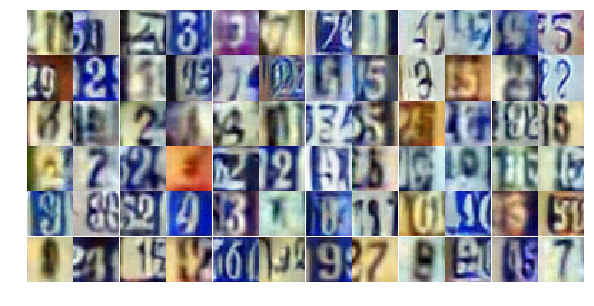

Epoch 19/25... Discriminator Loss: 0.9209... Generator Loss: 0.7709
Epoch 19/25... Discriminator Loss: 0.8349... Generator Loss: 0.7998
Epoch 19/25... Discriminator Loss: 0.9667... Generator Loss: 0.7645
Epoch 19/25... Discriminator Loss: 0.7803... Generator Loss: 0.8872
Epoch 19/25... Discriminator Loss: 1.0841... Generator Loss: 0.6296
Epoch 19/25... Discriminator Loss: 0.9683... Generator Loss: 0.6765
Epoch 19/25... Discriminator Loss: 1.2711... Generator Loss: 0.4572
Epoch 19/25... Discriminator Loss: 0.7229... Generator Loss: 0.9275
Epoch 19/25... Discriminator Loss: 0.8382... Generator Loss: 0.7896
Epoch 19/25... Discriminator Loss: 1.3447... Generator Loss: 0.5294


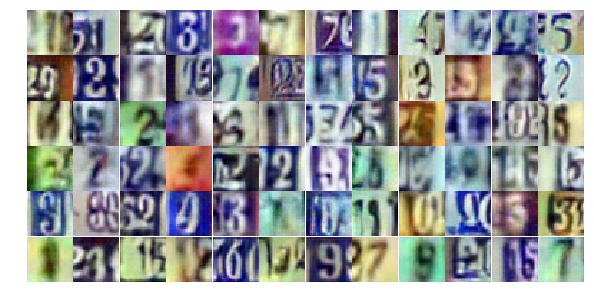

Epoch 19/25... Discriminator Loss: 0.8034... Generator Loss: 0.8880
Epoch 19/25... Discriminator Loss: 0.7843... Generator Loss: 1.2125
Epoch 19/25... Discriminator Loss: 1.4560... Generator Loss: 0.3969
Epoch 19/25... Discriminator Loss: 0.9255... Generator Loss: 0.7894
Epoch 19/25... Discriminator Loss: 0.9357... Generator Loss: 0.7589
Epoch 19/25... Discriminator Loss: 1.0457... Generator Loss: 0.6265
Epoch 19/25... Discriminator Loss: 0.6547... Generator Loss: 1.0208
Epoch 19/25... Discriminator Loss: 0.6270... Generator Loss: 1.1483
Epoch 19/25... Discriminator Loss: 0.6209... Generator Loss: 1.1070
Epoch 19/25... Discriminator Loss: 1.2234... Generator Loss: 0.5312


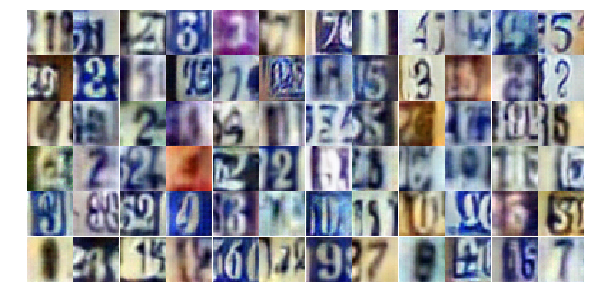

Epoch 19/25... Discriminator Loss: 0.8468... Generator Loss: 0.8135
Epoch 19/25... Discriminator Loss: 0.6830... Generator Loss: 0.9498
Epoch 19/25... Discriminator Loss: 0.8457... Generator Loss: 0.8128
Epoch 19/25... Discriminator Loss: 0.4580... Generator Loss: 1.3951
Epoch 19/25... Discriminator Loss: 0.5622... Generator Loss: 1.2832
Epoch 19/25... Discriminator Loss: 1.2811... Generator Loss: 0.4882
Epoch 19/25... Discriminator Loss: 0.6552... Generator Loss: 1.3053
Epoch 19/25... Discriminator Loss: 0.4649... Generator Loss: 1.5196
Epoch 19/25... Discriminator Loss: 1.5426... Generator Loss: 0.3388
Epoch 19/25... Discriminator Loss: 0.7743... Generator Loss: 0.8978


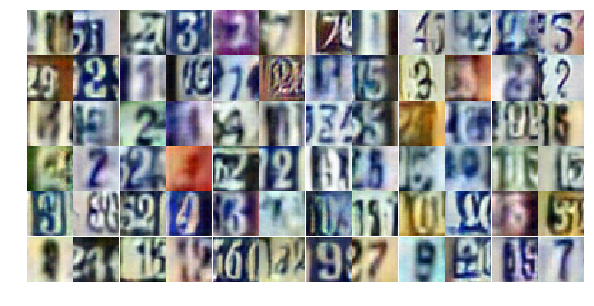

Epoch 19/25... Discriminator Loss: 0.5849... Generator Loss: 1.1619
Epoch 19/25... Discriminator Loss: 0.7741... Generator Loss: 0.9605
Epoch 19/25... Discriminator Loss: 0.9085... Generator Loss: 0.7308
Epoch 19/25... Discriminator Loss: 0.8355... Generator Loss: 0.8117
Epoch 19/25... Discriminator Loss: 0.8161... Generator Loss: 0.8771
Epoch 19/25... Discriminator Loss: 0.7553... Generator Loss: 1.8142
Epoch 19/25... Discriminator Loss: 0.8626... Generator Loss: 0.8883
Epoch 19/25... Discriminator Loss: 0.4235... Generator Loss: 2.1053
Epoch 19/25... Discriminator Loss: 0.5560... Generator Loss: 1.3201
Epoch 19/25... Discriminator Loss: 0.7901... Generator Loss: 0.9165


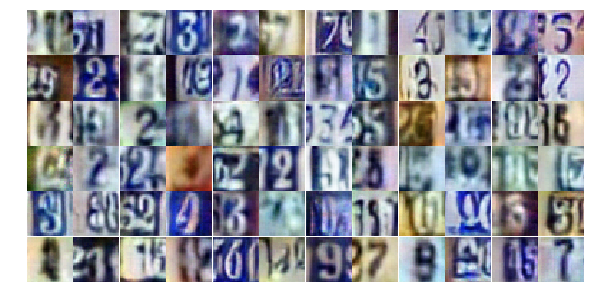

Epoch 19/25... Discriminator Loss: 0.6865... Generator Loss: 0.9961
Epoch 19/25... Discriminator Loss: 0.8596... Generator Loss: 0.8056
Epoch 19/25... Discriminator Loss: 1.2028... Generator Loss: 3.3542
Epoch 19/25... Discriminator Loss: 1.7854... Generator Loss: 0.5792
Epoch 19/25... Discriminator Loss: 1.0630... Generator Loss: 2.4559
Epoch 19/25... Discriminator Loss: 0.7517... Generator Loss: 1.0843
Epoch 19/25... Discriminator Loss: 1.0923... Generator Loss: 0.5355
Epoch 19/25... Discriminator Loss: 0.6243... Generator Loss: 2.1097
Epoch 20/25... Discriminator Loss: 0.8792... Generator Loss: 0.8352
Epoch 20/25... Discriminator Loss: 0.8558... Generator Loss: 0.7816


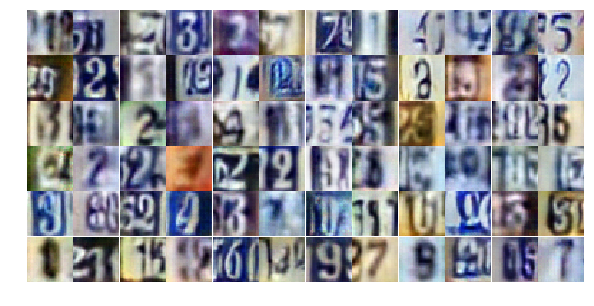

Epoch 20/25... Discriminator Loss: 0.7449... Generator Loss: 2.0480
Epoch 20/25... Discriminator Loss: 1.2762... Generator Loss: 0.4872
Epoch 20/25... Discriminator Loss: 1.3444... Generator Loss: 0.4893
Epoch 20/25... Discriminator Loss: 1.1836... Generator Loss: 0.5370
Epoch 20/25... Discriminator Loss: 0.4796... Generator Loss: 1.3739
Epoch 20/25... Discriminator Loss: 0.5508... Generator Loss: 1.2646
Epoch 20/25... Discriminator Loss: 0.9435... Generator Loss: 0.7106
Epoch 20/25... Discriminator Loss: 0.6981... Generator Loss: 1.0246
Epoch 20/25... Discriminator Loss: 1.3900... Generator Loss: 0.4473
Epoch 20/25... Discriminator Loss: 0.5778... Generator Loss: 1.3040


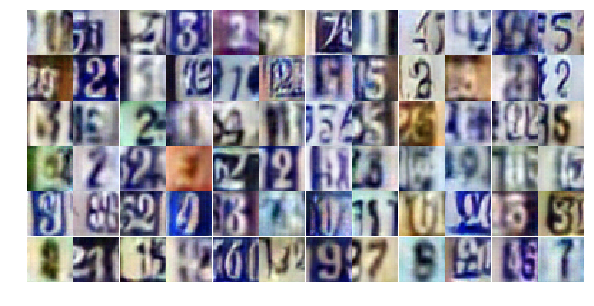

Epoch 20/25... Discriminator Loss: 1.2322... Generator Loss: 0.4987
Epoch 20/25... Discriminator Loss: 1.0060... Generator Loss: 0.7329
Epoch 20/25... Discriminator Loss: 0.5116... Generator Loss: 1.5031
Epoch 20/25... Discriminator Loss: 0.7494... Generator Loss: 0.9518
Epoch 20/25... Discriminator Loss: 0.7257... Generator Loss: 1.0192
Epoch 20/25... Discriminator Loss: 0.6998... Generator Loss: 1.1643
Epoch 20/25... Discriminator Loss: 1.5662... Generator Loss: 0.3424
Epoch 20/25... Discriminator Loss: 0.6355... Generator Loss: 1.3165
Epoch 20/25... Discriminator Loss: 0.8603... Generator Loss: 0.8364
Epoch 20/25... Discriminator Loss: 0.8578... Generator Loss: 0.8150


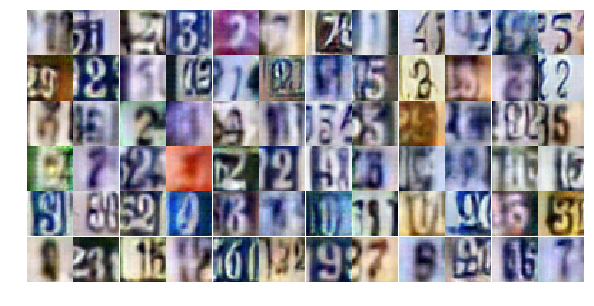

Epoch 20/25... Discriminator Loss: 0.4446... Generator Loss: 1.6601
Epoch 20/25... Discriminator Loss: 1.0485... Generator Loss: 0.6451
Epoch 20/25... Discriminator Loss: 0.3287... Generator Loss: 1.9299
Epoch 20/25... Discriminator Loss: 1.4299... Generator Loss: 0.5000
Epoch 20/25... Discriminator Loss: 0.8715... Generator Loss: 0.8883
Epoch 20/25... Discriminator Loss: 0.4127... Generator Loss: 1.7049
Epoch 20/25... Discriminator Loss: 0.7521... Generator Loss: 0.8892
Epoch 20/25... Discriminator Loss: 1.8118... Generator Loss: 0.3183
Epoch 20/25... Discriminator Loss: 1.0619... Generator Loss: 0.6290
Epoch 20/25... Discriminator Loss: 0.5104... Generator Loss: 1.1944


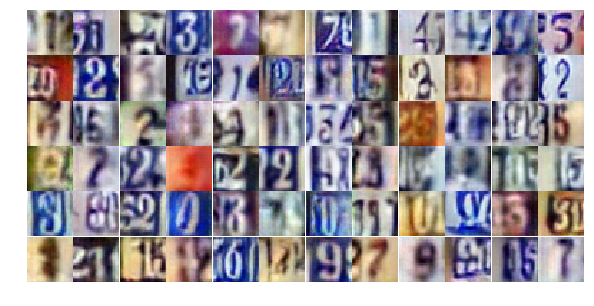

Epoch 20/25... Discriminator Loss: 0.9100... Generator Loss: 0.7495
Epoch 20/25... Discriminator Loss: 0.6610... Generator Loss: 0.9704
Epoch 20/25... Discriminator Loss: 1.4443... Generator Loss: 0.4416
Epoch 20/25... Discriminator Loss: 0.7937... Generator Loss: 2.0422
Epoch 20/25... Discriminator Loss: 0.9098... Generator Loss: 0.7968
Epoch 20/25... Discriminator Loss: 0.6047... Generator Loss: 1.1820
Epoch 20/25... Discriminator Loss: 1.0346... Generator Loss: 0.7097
Epoch 20/25... Discriminator Loss: 0.8571... Generator Loss: 0.7902
Epoch 20/25... Discriminator Loss: 0.7603... Generator Loss: 0.9136
Epoch 20/25... Discriminator Loss: 0.9106... Generator Loss: 0.7740


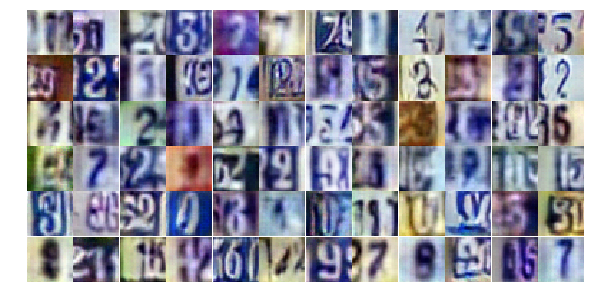

Epoch 20/25... Discriminator Loss: 0.8107... Generator Loss: 0.8756
Epoch 20/25... Discriminator Loss: 0.6788... Generator Loss: 1.6363
Epoch 20/25... Discriminator Loss: 0.6426... Generator Loss: 2.2010
Epoch 20/25... Discriminator Loss: 0.6410... Generator Loss: 1.2461
Epoch 20/25... Discriminator Loss: 0.9149... Generator Loss: 3.2616
Epoch 20/25... Discriminator Loss: 1.2545... Generator Loss: 0.5661
Epoch 20/25... Discriminator Loss: 1.2889... Generator Loss: 0.4598
Epoch 20/25... Discriminator Loss: 0.5255... Generator Loss: 1.3041
Epoch 20/25... Discriminator Loss: 0.7445... Generator Loss: 0.8612
Epoch 20/25... Discriminator Loss: 0.6566... Generator Loss: 1.1265


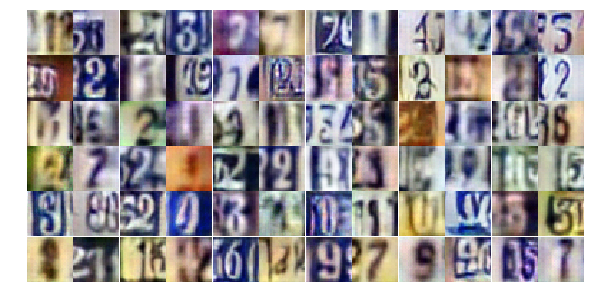

Epoch 20/25... Discriminator Loss: 0.6197... Generator Loss: 1.0345
Epoch 20/25... Discriminator Loss: 0.6647... Generator Loss: 1.9106
Epoch 20/25... Discriminator Loss: 0.4447... Generator Loss: 1.5589
Epoch 20/25... Discriminator Loss: 1.0254... Generator Loss: 0.6989
Epoch 20/25... Discriminator Loss: 0.5011... Generator Loss: 1.3389
Epoch 20/25... Discriminator Loss: 0.4668... Generator Loss: 1.3643
Epoch 21/25... Discriminator Loss: 1.2055... Generator Loss: 0.5579
Epoch 21/25... Discriminator Loss: 0.7259... Generator Loss: 1.1670
Epoch 21/25... Discriminator Loss: 1.4054... Generator Loss: 0.4680
Epoch 21/25... Discriminator Loss: 1.2052... Generator Loss: 0.5062


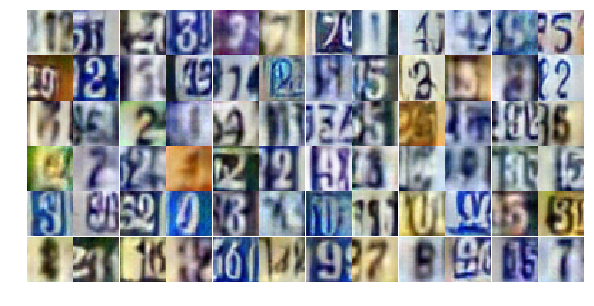

Epoch 21/25... Discriminator Loss: 0.6237... Generator Loss: 1.3375
Epoch 21/25... Discriminator Loss: 1.8517... Generator Loss: 0.3392
Epoch 21/25... Discriminator Loss: 0.4205... Generator Loss: 1.7540
Epoch 21/25... Discriminator Loss: 0.5839... Generator Loss: 1.0642
Epoch 21/25... Discriminator Loss: 0.8654... Generator Loss: 0.7884
Epoch 21/25... Discriminator Loss: 0.4494... Generator Loss: 1.5536
Epoch 21/25... Discriminator Loss: 0.5485... Generator Loss: 1.3813
Epoch 21/25... Discriminator Loss: 0.6146... Generator Loss: 1.7379
Epoch 21/25... Discriminator Loss: 0.7492... Generator Loss: 0.9502
Epoch 21/25... Discriminator Loss: 0.8889... Generator Loss: 0.9111


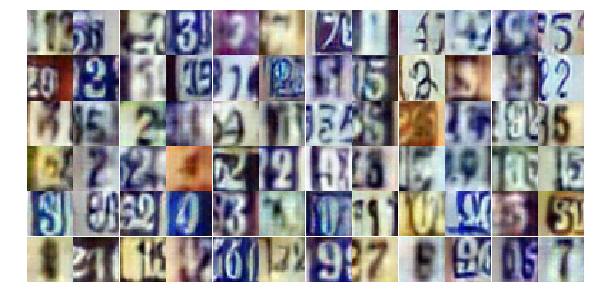

Epoch 21/25... Discriminator Loss: 0.3614... Generator Loss: 1.6594
Epoch 21/25... Discriminator Loss: 1.3704... Generator Loss: 0.4345
Epoch 21/25... Discriminator Loss: 1.9342... Generator Loss: 0.2529
Epoch 21/25... Discriminator Loss: 1.2027... Generator Loss: 0.6523
Epoch 21/25... Discriminator Loss: 0.5733... Generator Loss: 1.4107
Epoch 21/25... Discriminator Loss: 1.0816... Generator Loss: 0.5805
Epoch 21/25... Discriminator Loss: 0.9919... Generator Loss: 0.6890
Epoch 21/25... Discriminator Loss: 0.5158... Generator Loss: 1.4311
Epoch 21/25... Discriminator Loss: 0.5113... Generator Loss: 1.5142
Epoch 21/25... Discriminator Loss: 0.7549... Generator Loss: 0.8842


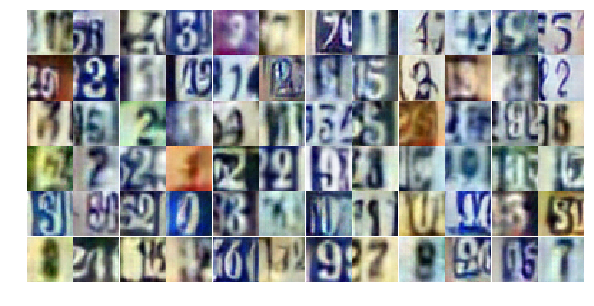

Epoch 21/25... Discriminator Loss: 1.4531... Generator Loss: 0.3816
Epoch 21/25... Discriminator Loss: 0.3801... Generator Loss: 1.6316
Epoch 21/25... Discriminator Loss: 0.9257... Generator Loss: 0.7189
Epoch 21/25... Discriminator Loss: 0.9597... Generator Loss: 0.7841
Epoch 21/25... Discriminator Loss: 0.6930... Generator Loss: 1.0198
Epoch 21/25... Discriminator Loss: 0.8320... Generator Loss: 0.8431
Epoch 21/25... Discriminator Loss: 0.6457... Generator Loss: 1.0590
Epoch 21/25... Discriminator Loss: 0.8690... Generator Loss: 0.7963
Epoch 21/25... Discriminator Loss: 1.2705... Generator Loss: 0.5063
Epoch 21/25... Discriminator Loss: 1.6170... Generator Loss: 0.3358


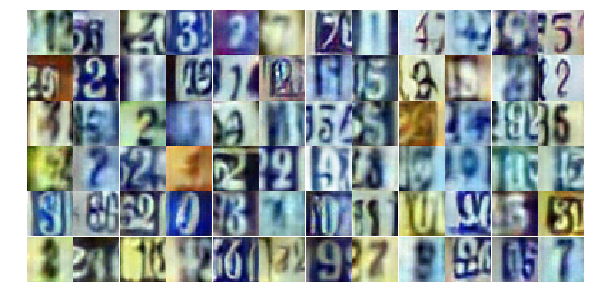

Epoch 21/25... Discriminator Loss: 0.6649... Generator Loss: 1.4671
Epoch 21/25... Discriminator Loss: 0.8458... Generator Loss: 0.8663
Epoch 21/25... Discriminator Loss: 1.2231... Generator Loss: 0.4737
Epoch 21/25... Discriminator Loss: 0.6498... Generator Loss: 1.0387
Epoch 21/25... Discriminator Loss: 0.6655... Generator Loss: 0.9707
Epoch 21/25... Discriminator Loss: 0.7934... Generator Loss: 0.8616
Epoch 21/25... Discriminator Loss: 0.7040... Generator Loss: 1.0863
Epoch 21/25... Discriminator Loss: 1.5563... Generator Loss: 0.4123
Epoch 21/25... Discriminator Loss: 0.6506... Generator Loss: 1.1351
Epoch 21/25... Discriminator Loss: 1.3476... Generator Loss: 0.5786


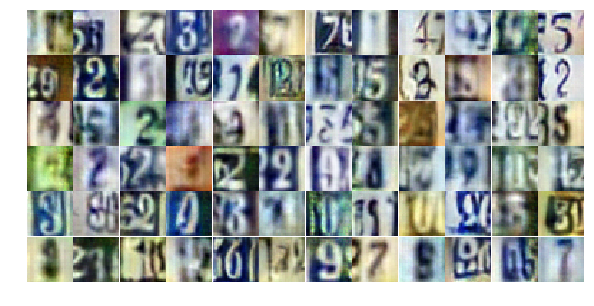

Epoch 21/25... Discriminator Loss: 7.0742... Generator Loss: 0.0034
Epoch 21/25... Discriminator Loss: 1.7136... Generator Loss: 0.4998
Epoch 21/25... Discriminator Loss: 0.6079... Generator Loss: 1.6376
Epoch 21/25... Discriminator Loss: 0.7565... Generator Loss: 1.4277
Epoch 21/25... Discriminator Loss: 0.4968... Generator Loss: 1.5716
Epoch 21/25... Discriminator Loss: 0.8402... Generator Loss: 0.9568
Epoch 21/25... Discriminator Loss: 1.1207... Generator Loss: 0.5646
Epoch 21/25... Discriminator Loss: 0.9819... Generator Loss: 0.7492
Epoch 21/25... Discriminator Loss: 0.8679... Generator Loss: 0.7958
Epoch 21/25... Discriminator Loss: 0.4482... Generator Loss: 1.6472


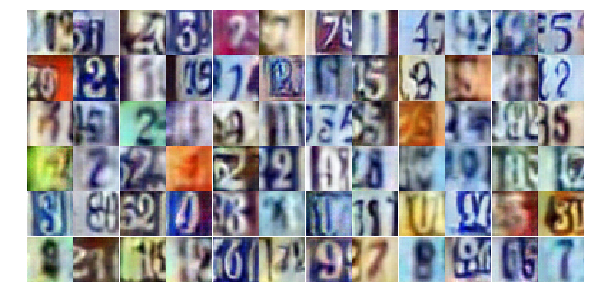

Epoch 21/25... Discriminator Loss: 0.6768... Generator Loss: 1.1288
Epoch 21/25... Discriminator Loss: 1.0019... Generator Loss: 0.6504
Epoch 21/25... Discriminator Loss: 0.7022... Generator Loss: 1.0655
Epoch 22/25... Discriminator Loss: 0.7576... Generator Loss: 0.9518
Epoch 22/25... Discriminator Loss: 0.8600... Generator Loss: 1.0779
Epoch 22/25... Discriminator Loss: 0.7676... Generator Loss: 0.9232
Epoch 22/25... Discriminator Loss: 0.4980... Generator Loss: 1.4002
Epoch 22/25... Discriminator Loss: 0.6462... Generator Loss: 1.0176
Epoch 22/25... Discriminator Loss: 1.0842... Generator Loss: 0.6426
Epoch 22/25... Discriminator Loss: 0.9081... Generator Loss: 0.7444


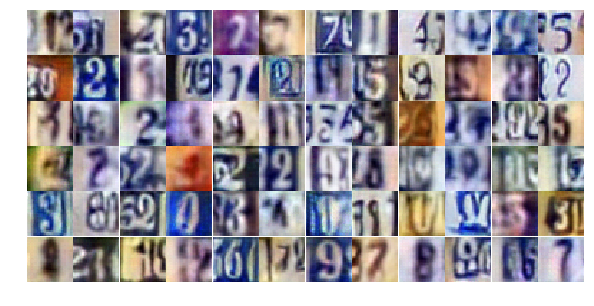

Epoch 22/25... Discriminator Loss: 0.4954... Generator Loss: 1.6113
Epoch 22/25... Discriminator Loss: 0.7454... Generator Loss: 1.1220
Epoch 22/25... Discriminator Loss: 1.7474... Generator Loss: 0.3701
Epoch 22/25... Discriminator Loss: 0.8734... Generator Loss: 0.7488
Epoch 22/25... Discriminator Loss: 1.0997... Generator Loss: 0.6461
Epoch 22/25... Discriminator Loss: 0.7512... Generator Loss: 0.8567
Epoch 22/25... Discriminator Loss: 0.7495... Generator Loss: 0.9031
Epoch 22/25... Discriminator Loss: 0.5034... Generator Loss: 1.3294
Epoch 22/25... Discriminator Loss: 0.9335... Generator Loss: 0.7878
Epoch 22/25... Discriminator Loss: 1.4852... Generator Loss: 0.3556


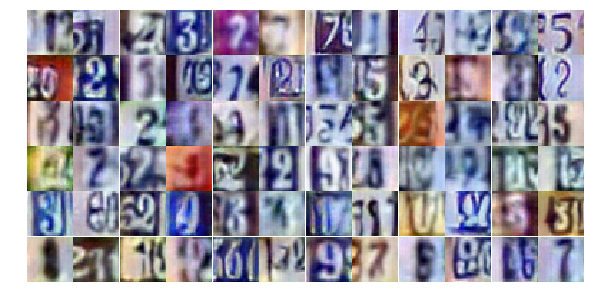

Epoch 22/25... Discriminator Loss: 0.7552... Generator Loss: 1.0381
Epoch 22/25... Discriminator Loss: 0.6590... Generator Loss: 1.0313
Epoch 22/25... Discriminator Loss: 0.6330... Generator Loss: 1.1640
Epoch 22/25... Discriminator Loss: 0.6991... Generator Loss: 0.8982
Epoch 22/25... Discriminator Loss: 0.7988... Generator Loss: 0.8588
Epoch 22/25... Discriminator Loss: 0.7581... Generator Loss: 0.8668
Epoch 22/25... Discriminator Loss: 0.4689... Generator Loss: 1.6203
Epoch 22/25... Discriminator Loss: 0.3747... Generator Loss: 1.6450
Epoch 22/25... Discriminator Loss: 0.6110... Generator Loss: 1.0537
Epoch 22/25... Discriminator Loss: 0.9865... Generator Loss: 0.6543


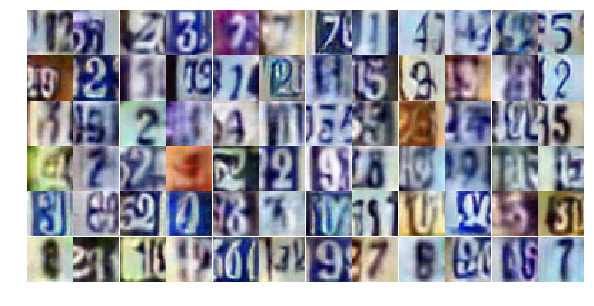

Epoch 22/25... Discriminator Loss: 0.4821... Generator Loss: 1.5056
Epoch 22/25... Discriminator Loss: 0.4568... Generator Loss: 1.8326
Epoch 22/25... Discriminator Loss: 0.7286... Generator Loss: 1.0343
Epoch 22/25... Discriminator Loss: 0.8343... Generator Loss: 0.8133
Epoch 22/25... Discriminator Loss: 0.6341... Generator Loss: 1.0582
Epoch 22/25... Discriminator Loss: 0.8385... Generator Loss: 0.7977
Epoch 22/25... Discriminator Loss: 1.7990... Generator Loss: 0.2987
Epoch 22/25... Discriminator Loss: 0.3771... Generator Loss: 2.2838
Epoch 22/25... Discriminator Loss: 0.9697... Generator Loss: 0.7495
Epoch 22/25... Discriminator Loss: 1.3992... Generator Loss: 0.4008


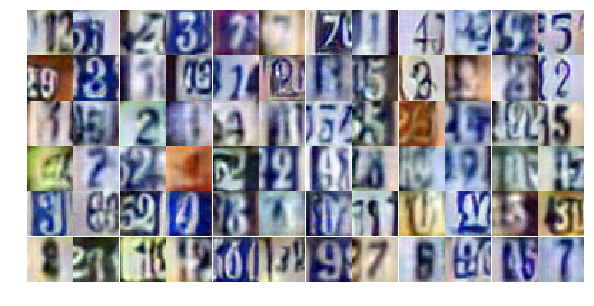

Epoch 22/25... Discriminator Loss: 0.9213... Generator Loss: 0.7418
Epoch 22/25... Discriminator Loss: 0.3767... Generator Loss: 1.7167
Epoch 22/25... Discriminator Loss: 0.3784... Generator Loss: 1.5483
Epoch 22/25... Discriminator Loss: 0.8237... Generator Loss: 0.8923
Epoch 22/25... Discriminator Loss: 0.4940... Generator Loss: 1.3959
Epoch 22/25... Discriminator Loss: 0.4824... Generator Loss: 1.2939
Epoch 22/25... Discriminator Loss: 0.8983... Generator Loss: 0.7829
Epoch 22/25... Discriminator Loss: 1.2066... Generator Loss: 0.5649
Epoch 22/25... Discriminator Loss: 1.2371... Generator Loss: 0.6505
Epoch 22/25... Discriminator Loss: 0.7989... Generator Loss: 2.5819


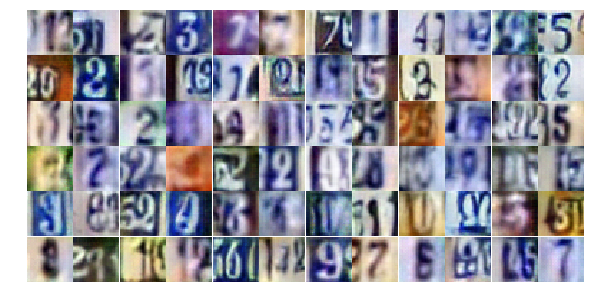

Epoch 22/25... Discriminator Loss: 1.4646... Generator Loss: 0.3898
Epoch 22/25... Discriminator Loss: 0.6890... Generator Loss: 0.9709
Epoch 22/25... Discriminator Loss: 0.7607... Generator Loss: 0.8755
Epoch 22/25... Discriminator Loss: 1.4307... Generator Loss: 0.4046
Epoch 22/25... Discriminator Loss: 1.2008... Generator Loss: 0.5219
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 1.2670
Epoch 22/25... Discriminator Loss: 0.7917... Generator Loss: 0.9831
Epoch 22/25... Discriminator Loss: 0.5787... Generator Loss: 1.2700
Epoch 22/25... Discriminator Loss: 0.9122... Generator Loss: 1.9466
Epoch 22/25... Discriminator Loss: 0.7246... Generator Loss: 1.0926


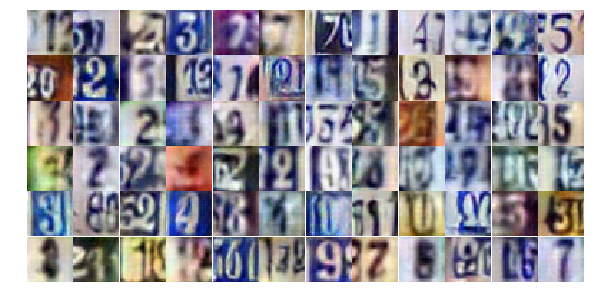

Epoch 23/25... Discriminator Loss: 0.4097... Generator Loss: 1.7096
Epoch 23/25... Discriminator Loss: 0.5024... Generator Loss: 1.3638
Epoch 23/25... Discriminator Loss: 1.1464... Generator Loss: 0.5374
Epoch 23/25... Discriminator Loss: 0.6238... Generator Loss: 1.3839
Epoch 23/25... Discriminator Loss: 0.7387... Generator Loss: 1.8416
Epoch 23/25... Discriminator Loss: 2.0260... Generator Loss: 0.2459
Epoch 23/25... Discriminator Loss: 2.0262... Generator Loss: 0.2510
Epoch 23/25... Discriminator Loss: 0.9808... Generator Loss: 0.7443
Epoch 23/25... Discriminator Loss: 0.7762... Generator Loss: 1.0773
Epoch 23/25... Discriminator Loss: 0.3614... Generator Loss: 1.6223


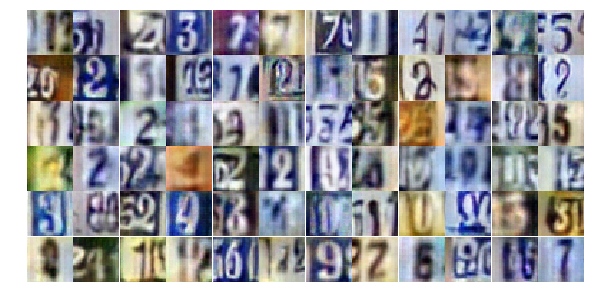

Epoch 23/25... Discriminator Loss: 0.8335... Generator Loss: 0.7816
Epoch 23/25... Discriminator Loss: 1.0303... Generator Loss: 0.6227
Epoch 23/25... Discriminator Loss: 0.7995... Generator Loss: 0.9531
Epoch 23/25... Discriminator Loss: 0.7239... Generator Loss: 1.0048
Epoch 23/25... Discriminator Loss: 0.5504... Generator Loss: 1.2607
Epoch 23/25... Discriminator Loss: 0.7787... Generator Loss: 0.9740
Epoch 23/25... Discriminator Loss: 0.9239... Generator Loss: 0.7293
Epoch 23/25... Discriminator Loss: 1.1836... Generator Loss: 0.6642
Epoch 23/25... Discriminator Loss: 1.6489... Generator Loss: 0.4607
Epoch 23/25... Discriminator Loss: 0.7024... Generator Loss: 1.1423


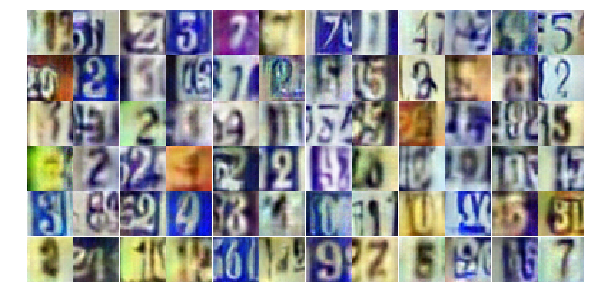

Epoch 23/25... Discriminator Loss: 1.5653... Generator Loss: 0.4486
Epoch 23/25... Discriminator Loss: 0.9722... Generator Loss: 0.8022
Epoch 23/25... Discriminator Loss: 1.7250... Generator Loss: 0.3637
Epoch 23/25... Discriminator Loss: 0.7536... Generator Loss: 1.0497
Epoch 23/25... Discriminator Loss: 0.6793... Generator Loss: 1.0843
Epoch 23/25... Discriminator Loss: 0.8130... Generator Loss: 0.8734
Epoch 23/25... Discriminator Loss: 0.6458... Generator Loss: 1.1383
Epoch 23/25... Discriminator Loss: 1.0653... Generator Loss: 0.6207
Epoch 23/25... Discriminator Loss: 0.5831... Generator Loss: 1.2803
Epoch 23/25... Discriminator Loss: 1.0079... Generator Loss: 0.6164


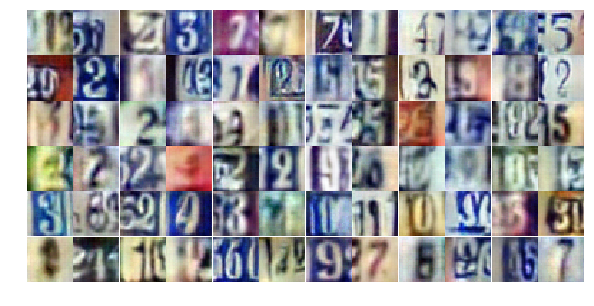

Epoch 23/25... Discriminator Loss: 0.6361... Generator Loss: 1.0352
Epoch 23/25... Discriminator Loss: 0.6109... Generator Loss: 1.2185
Epoch 23/25... Discriminator Loss: 0.6658... Generator Loss: 1.0739
Epoch 23/25... Discriminator Loss: 1.1606... Generator Loss: 0.6241
Epoch 23/25... Discriminator Loss: 0.7612... Generator Loss: 1.4381
Epoch 23/25... Discriminator Loss: 1.0175... Generator Loss: 0.7152
Epoch 23/25... Discriminator Loss: 1.0143... Generator Loss: 0.7398
Epoch 23/25... Discriminator Loss: 0.6754... Generator Loss: 1.0461
Epoch 23/25... Discriminator Loss: 0.3968... Generator Loss: 1.7133
Epoch 23/25... Discriminator Loss: 0.4871... Generator Loss: 1.4267


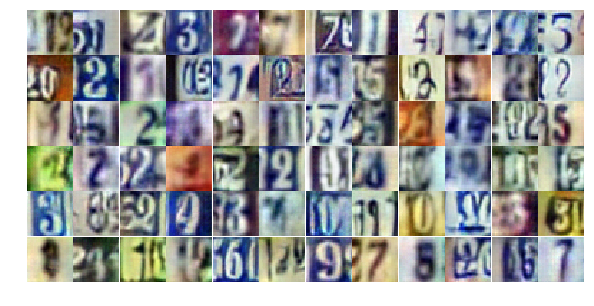

Epoch 23/25... Discriminator Loss: 0.9156... Generator Loss: 0.9024
Epoch 23/25... Discriminator Loss: 0.7534... Generator Loss: 0.8913
Epoch 23/25... Discriminator Loss: 0.7559... Generator Loss: 2.7041
Epoch 23/25... Discriminator Loss: 0.9819... Generator Loss: 0.7398
Epoch 23/25... Discriminator Loss: 1.4661... Generator Loss: 1.3480
Epoch 23/25... Discriminator Loss: 0.8951... Generator Loss: 2.3367
Epoch 23/25... Discriminator Loss: 0.7157... Generator Loss: 1.2654
Epoch 23/25... Discriminator Loss: 1.3057... Generator Loss: 0.4960
Epoch 23/25... Discriminator Loss: 0.9966... Generator Loss: 0.7298
Epoch 23/25... Discriminator Loss: 0.8909... Generator Loss: 1.0303


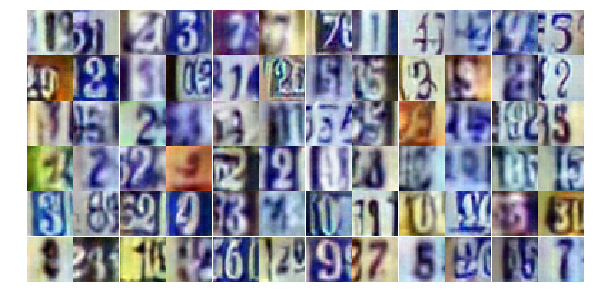

Epoch 23/25... Discriminator Loss: 0.7881... Generator Loss: 0.8749
Epoch 23/25... Discriminator Loss: 0.8665... Generator Loss: 0.7981
Epoch 23/25... Discriminator Loss: 0.9065... Generator Loss: 0.8033
Epoch 23/25... Discriminator Loss: 0.4172... Generator Loss: 1.8069
Epoch 23/25... Discriminator Loss: 1.0520... Generator Loss: 0.6535
Epoch 23/25... Discriminator Loss: 0.6772... Generator Loss: 1.1007
Epoch 23/25... Discriminator Loss: 0.9905... Generator Loss: 0.7341
Epoch 24/25... Discriminator Loss: 0.6640... Generator Loss: 1.1206
Epoch 24/25... Discriminator Loss: 0.7291... Generator Loss: 1.1732
Epoch 24/25... Discriminator Loss: 0.7507... Generator Loss: 1.1410


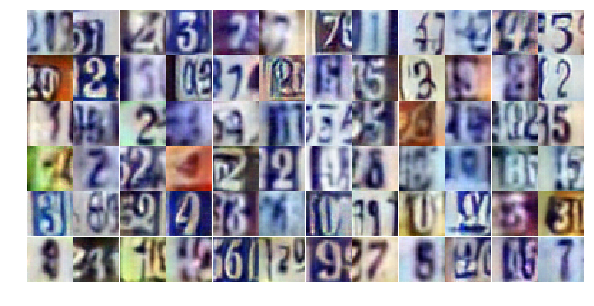

Epoch 24/25... Discriminator Loss: 0.6508... Generator Loss: 1.0559
Epoch 24/25... Discriminator Loss: 0.7333... Generator Loss: 0.9676
Epoch 24/25... Discriminator Loss: 0.6589... Generator Loss: 1.0443
Epoch 24/25... Discriminator Loss: 0.7511... Generator Loss: 1.0555
Epoch 24/25... Discriminator Loss: 1.0270... Generator Loss: 0.6571
Epoch 24/25... Discriminator Loss: 0.7114... Generator Loss: 1.0492
Epoch 24/25... Discriminator Loss: 0.8659... Generator Loss: 0.8781
Epoch 24/25... Discriminator Loss: 1.7801... Generator Loss: 0.2806
Epoch 24/25... Discriminator Loss: 0.5298... Generator Loss: 1.1524
Epoch 24/25... Discriminator Loss: 0.4430... Generator Loss: 1.6383


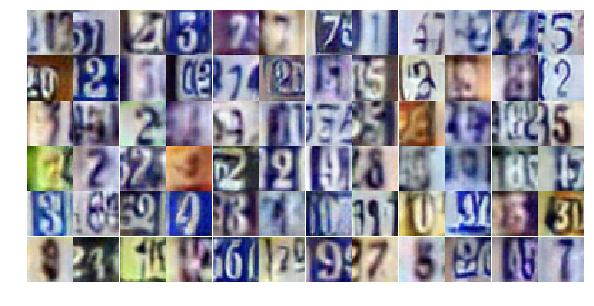

Epoch 24/25... Discriminator Loss: 0.7775... Generator Loss: 0.9856
Epoch 24/25... Discriminator Loss: 1.0252... Generator Loss: 0.6761
Epoch 24/25... Discriminator Loss: 1.0526... Generator Loss: 0.6478
Epoch 24/25... Discriminator Loss: 0.3371... Generator Loss: 1.7929
Epoch 24/25... Discriminator Loss: 0.4310... Generator Loss: 1.8967
Epoch 24/25... Discriminator Loss: 1.0143... Generator Loss: 0.6915
Epoch 24/25... Discriminator Loss: 0.7576... Generator Loss: 1.0093
Epoch 24/25... Discriminator Loss: 1.2963... Generator Loss: 0.4566
Epoch 24/25... Discriminator Loss: 1.0110... Generator Loss: 0.6616
Epoch 24/25... Discriminator Loss: 0.8445... Generator Loss: 0.8634


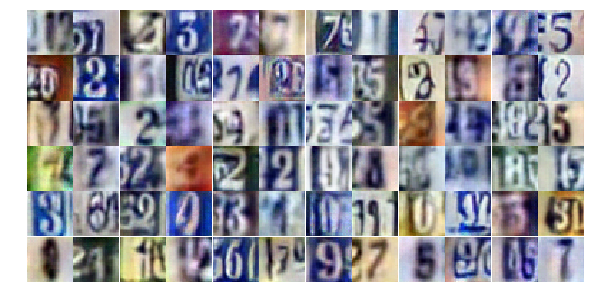

Epoch 24/25... Discriminator Loss: 0.6371... Generator Loss: 1.3825
Epoch 24/25... Discriminator Loss: 0.6834... Generator Loss: 1.3264
Epoch 24/25... Discriminator Loss: 0.5273... Generator Loss: 1.3048
Epoch 24/25... Discriminator Loss: 1.2935... Generator Loss: 0.4991
Epoch 24/25... Discriminator Loss: 0.5667... Generator Loss: 1.1198
Epoch 24/25... Discriminator Loss: 0.4641... Generator Loss: 1.5010
Epoch 24/25... Discriminator Loss: 0.4393... Generator Loss: 1.3697
Epoch 24/25... Discriminator Loss: 0.9118... Generator Loss: 0.7634
Epoch 24/25... Discriminator Loss: 0.6912... Generator Loss: 1.1484
Epoch 24/25... Discriminator Loss: 0.8599... Generator Loss: 0.8025


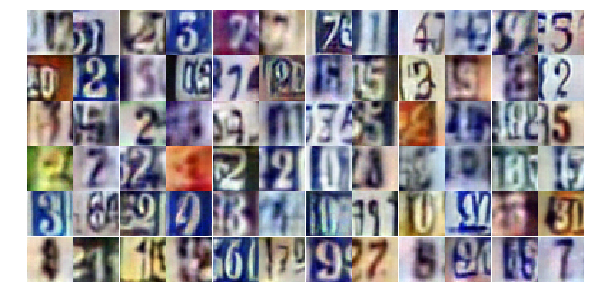

Epoch 24/25... Discriminator Loss: 0.7930... Generator Loss: 0.8175
Epoch 24/25... Discriminator Loss: 0.6022... Generator Loss: 1.0790
Epoch 24/25... Discriminator Loss: 1.0924... Generator Loss: 1.4333
Epoch 24/25... Discriminator Loss: 1.5436... Generator Loss: 0.3631
Epoch 24/25... Discriminator Loss: 1.2129... Generator Loss: 0.6361
Epoch 24/25... Discriminator Loss: 1.0944... Generator Loss: 0.5421
Epoch 24/25... Discriminator Loss: 0.9432... Generator Loss: 0.7239
Epoch 24/25... Discriminator Loss: 0.8745... Generator Loss: 0.7813
Epoch 24/25... Discriminator Loss: 0.9203... Generator Loss: 0.7761
Epoch 24/25... Discriminator Loss: 0.7289... Generator Loss: 1.0840


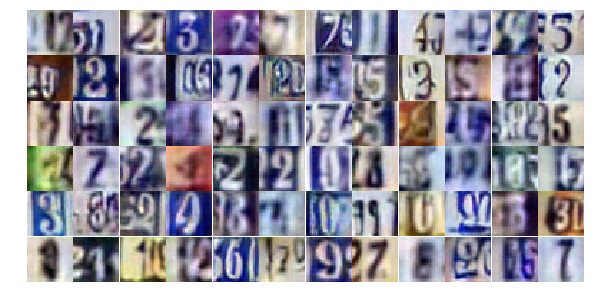

Epoch 24/25... Discriminator Loss: 0.9399... Generator Loss: 0.7674
Epoch 24/25... Discriminator Loss: 1.2038... Generator Loss: 0.5767
Epoch 24/25... Discriminator Loss: 1.4782... Generator Loss: 0.4503
Epoch 24/25... Discriminator Loss: 1.6705... Generator Loss: 0.2908
Epoch 24/25... Discriminator Loss: 1.8619... Generator Loss: 0.2578
Epoch 24/25... Discriminator Loss: 0.6016... Generator Loss: 1.2955
Epoch 24/25... Discriminator Loss: 0.8996... Generator Loss: 0.8907
Epoch 24/25... Discriminator Loss: 0.9300... Generator Loss: 0.7212
Epoch 24/25... Discriminator Loss: 0.9621... Generator Loss: 0.7144
Epoch 24/25... Discriminator Loss: 0.6994... Generator Loss: 1.0463


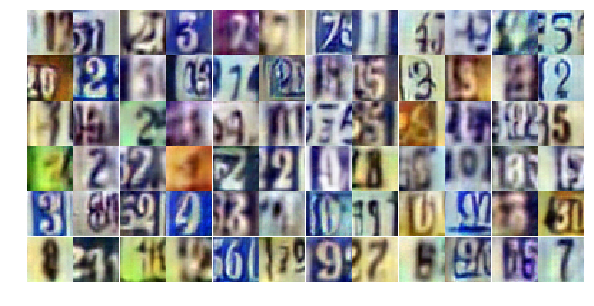

Epoch 24/25... Discriminator Loss: 0.7913... Generator Loss: 0.9010
Epoch 24/25... Discriminator Loss: 1.4719... Generator Loss: 0.4301
Epoch 24/25... Discriminator Loss: 1.9632... Generator Loss: 0.2307
Epoch 24/25... Discriminator Loss: 1.4206... Generator Loss: 0.4510
Epoch 24/25... Discriminator Loss: 0.9161... Generator Loss: 0.8517
Epoch 25/25... Discriminator Loss: 0.7379... Generator Loss: 1.2594
Epoch 25/25... Discriminator Loss: 0.4865... Generator Loss: 1.6459
Epoch 25/25... Discriminator Loss: 1.0695... Generator Loss: 0.6500
Epoch 25/25... Discriminator Loss: 0.7572... Generator Loss: 0.9518
Epoch 25/25... Discriminator Loss: 1.1743... Generator Loss: 0.5435


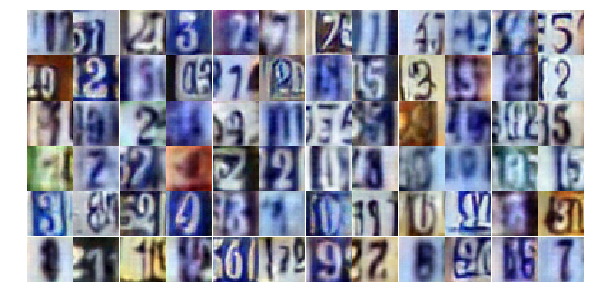

Epoch 25/25... Discriminator Loss: 1.3877... Generator Loss: 0.4390
Epoch 25/25... Discriminator Loss: 1.4230... Generator Loss: 0.3822
Epoch 25/25... Discriminator Loss: 0.7559... Generator Loss: 1.0400
Epoch 25/25... Discriminator Loss: 0.7069... Generator Loss: 1.2094
Epoch 25/25... Discriminator Loss: 0.8186... Generator Loss: 1.2078
Epoch 25/25... Discriminator Loss: 1.3620... Generator Loss: 0.4361
Epoch 25/25... Discriminator Loss: 0.7867... Generator Loss: 0.8863
Epoch 25/25... Discriminator Loss: 0.6388... Generator Loss: 1.1408
Epoch 25/25... Discriminator Loss: 0.7736... Generator Loss: 0.9999
Epoch 25/25... Discriminator Loss: 0.7877... Generator Loss: 0.9774


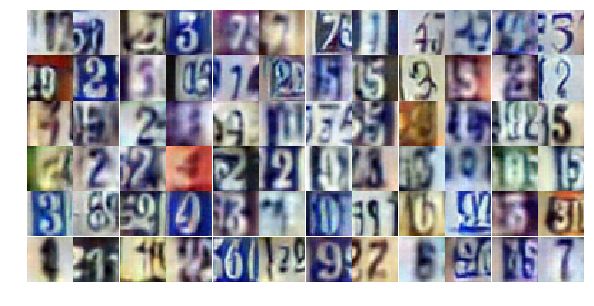

Epoch 25/25... Discriminator Loss: 0.8646... Generator Loss: 1.0376
Epoch 25/25... Discriminator Loss: 0.6505... Generator Loss: 2.1834
Epoch 25/25... Discriminator Loss: 1.3598... Generator Loss: 0.4810
Epoch 25/25... Discriminator Loss: 1.0988... Generator Loss: 1.5734
Epoch 25/25... Discriminator Loss: 0.8525... Generator Loss: 0.8856
Epoch 25/25... Discriminator Loss: 0.5057... Generator Loss: 1.4405
Epoch 25/25... Discriminator Loss: 0.6974... Generator Loss: 0.9980
Epoch 25/25... Discriminator Loss: 1.0572... Generator Loss: 0.6262
Epoch 25/25... Discriminator Loss: 0.3564... Generator Loss: 1.6823
Epoch 25/25... Discriminator Loss: 0.9815... Generator Loss: 0.7501


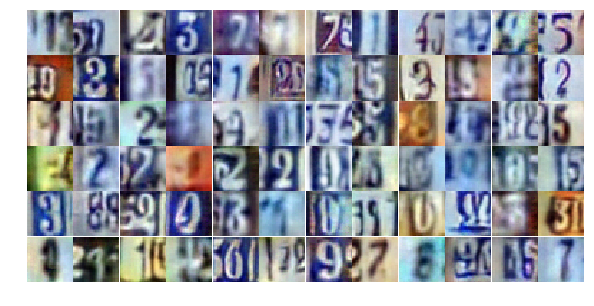

Epoch 25/25... Discriminator Loss: 0.6409... Generator Loss: 1.1452
Epoch 25/25... Discriminator Loss: 0.6497... Generator Loss: 1.0708
Epoch 25/25... Discriminator Loss: 2.1127... Generator Loss: 0.2322
Epoch 25/25... Discriminator Loss: 0.5836... Generator Loss: 1.3808
Epoch 25/25... Discriminator Loss: 0.8725... Generator Loss: 0.7740
Epoch 25/25... Discriminator Loss: 0.7792... Generator Loss: 0.8638
Epoch 25/25... Discriminator Loss: 0.7927... Generator Loss: 0.8784
Epoch 25/25... Discriminator Loss: 0.7305... Generator Loss: 0.9364
Epoch 25/25... Discriminator Loss: 1.5693... Generator Loss: 0.3488
Epoch 25/25... Discriminator Loss: 0.3637... Generator Loss: 1.7887


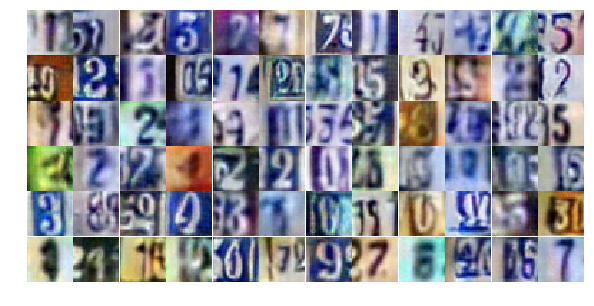

Epoch 25/25... Discriminator Loss: 0.6189... Generator Loss: 1.1605
Epoch 25/25... Discriminator Loss: 0.4704... Generator Loss: 2.5341
Epoch 25/25... Discriminator Loss: 0.6818... Generator Loss: 1.1196
Epoch 25/25... Discriminator Loss: 0.8361... Generator Loss: 0.7985
Epoch 25/25... Discriminator Loss: 0.9392... Generator Loss: 0.6955
Epoch 25/25... Discriminator Loss: 0.9394... Generator Loss: 0.7008
Epoch 25/25... Discriminator Loss: 0.5868... Generator Loss: 1.1795
Epoch 25/25... Discriminator Loss: 0.5192... Generator Loss: 1.2663
Epoch 25/25... Discriminator Loss: 1.9007... Generator Loss: 0.2410
Epoch 25/25... Discriminator Loss: 0.5599... Generator Loss: 1.1698


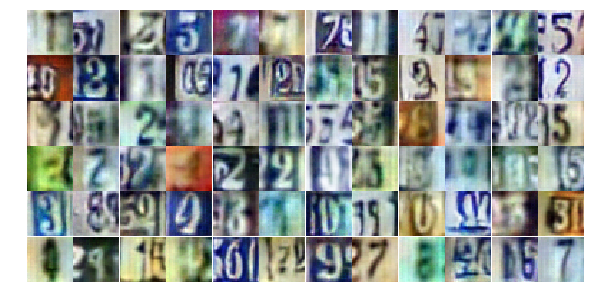

Epoch 25/25... Discriminator Loss: 0.6525... Generator Loss: 1.7579
Epoch 25/25... Discriminator Loss: 1.0735... Generator Loss: 0.6426
Epoch 25/25... Discriminator Loss: 1.0015... Generator Loss: 0.6815
Epoch 25/25... Discriminator Loss: 2.4515... Generator Loss: 0.1253
Epoch 25/25... Discriminator Loss: 0.9714... Generator Loss: 0.7477
Epoch 25/25... Discriminator Loss: 0.4455... Generator Loss: 1.4555
Epoch 25/25... Discriminator Loss: 1.3529... Generator Loss: 0.4974
Epoch 25/25... Discriminator Loss: 0.6420... Generator Loss: 1.1450
Epoch 25/25... Discriminator Loss: 0.6254... Generator Loss: 2.0237
Epoch 25/25... Discriminator Loss: 0.8763... Generator Loss: 0.8500


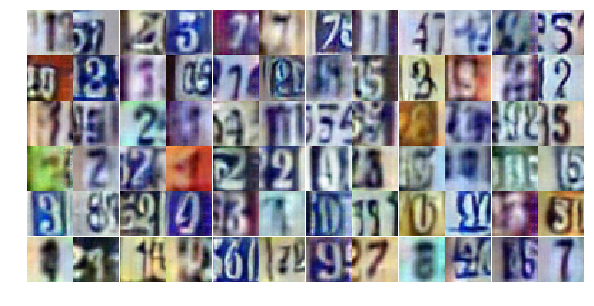

Epoch 25/25... Discriminator Loss: 0.9876... Generator Loss: 0.8722
Epoch 25/25... Discriminator Loss: 2.8109... Generator Loss: 0.1981


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

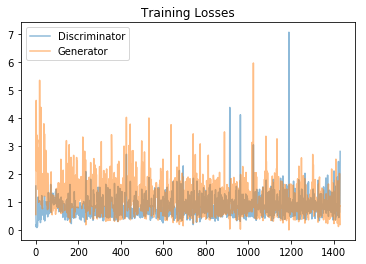

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

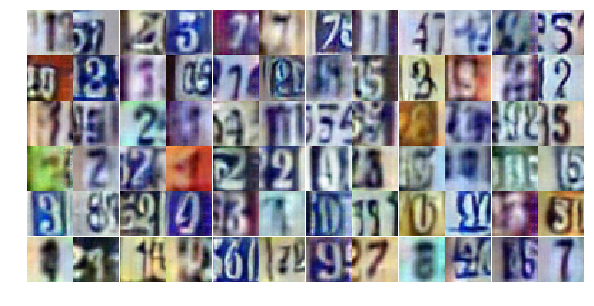

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))